In [ ]:
!nvidia-smi

Sun Dec  5 06:23:55 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 495.44       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   34C    P0    25W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

# HarDNet - MSEG model

In [ ]:
# Imports
import torch
import torchvision # torch package for vision related things
import torch.nn as nn
import torch.nn.functional as F  # Parameterless functions, like (some) activation functions
import torchvision.datasets as datasets  # Standard datasets
import torchvision.transforms as transforms  # Transformations we can perform on our dataset for augmentation
from PIL import Image
from torchvision import models
from torch import optim  # For optimizers like SGD, Adam, etc.
# import torch_optimizer as optimi
# from torch import nn  # All neural network modules
# from torch.utils.data import DataLoader  # Gives easier dataset managment by creating mini batches etc.
from tqdm import tqdm  # For nice progress bar!
from torchsummary import summary
# import albumentations as A
# from albumentations.pytorch import ToTensorV2
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import skimage as io
import torch.backends.cudnn as cudnn
import torch.nn.init as init
from torch.autograd import Variable
import sys
import time
from datetime import datetime

In [ ]:
# +
class Flatten(nn.Module):
    def __init__(self):
        super().__init__()
    def forward(self, x):
        return x.view(x.data.size(0),-1)
    
class ConvLayer(nn.Sequential):
    def __init__(self, in_channels, out_channels, kernel=3, stride=1, dropout=0.1, bias=False):
        super().__init__()
        out_ch = out_channels
        groups = 1
        #print(kernel, 'x', kernel, 'x', in_channels, 'x', out_channels)
        self.add_module('conv', nn.Conv2d(in_channels, out_ch, kernel_size=kernel,          
                                          stride=stride, padding=kernel//2, groups=groups, bias=bias))
        self.add_module('norm', nn.BatchNorm2d(out_ch))
        self.add_module('relu', nn.ReLU6(True))                                          
    def forward(self, x):
        return super().forward(x)


# -

class HarDBlock(nn.Module):
    def get_link(self, layer, base_ch, growth_rate, grmul):
        if layer == 0:
          return base_ch, 0, []
        out_channels = growth_rate
        link = []
        for i in range(10):
          dv = 2 ** i
          if layer % dv == 0:
            k = layer - dv
            link.append(k)
            if i > 0:
                out_channels *= grmul
        out_channels = int(int(out_channels + 1) / 2) * 2
        in_channels = 0
        for i in link:
          ch,_,_ = self.get_link(i, base_ch, growth_rate, grmul)
          in_channels += ch
        return out_channels, in_channels, link

    def get_out_ch(self):
        return self.out_channels

    def __init__(self, in_channels, growth_rate, grmul, n_layers, keepBase=False, residual_out=False, dwconv=False):
        super().__init__()
        self.keepBase = keepBase
        self.links = []
        layers_ = []
        self.out_channels = 0 # if upsample else in_channels
        for i in range(n_layers):
          outch, inch, link = self.get_link(i+1, in_channels, growth_rate, grmul)
          self.links.append(link)
          use_relu = residual_out
          if dwconv:
            layers_.append(CombConvLayer(inch, outch))
          else:
            layers_.append(ConvLayer(inch, outch))
          
          if (i % 2 == 0) or (i == n_layers - 1):
            self.out_channels += outch
        #print("Blk out =",self.out_channels)
        self.layers = nn.ModuleList(layers_)
        
    def forward(self, x):
        layers_ = [x]
        
        for layer in range(len(self.layers)):
            link = self.links[layer]
            tin = []
            for i in link:
                tin.append(layers_[i])
            if len(tin) > 1:            
                x = torch.cat(tin, 1)
            else:
                x = tin[0]
            out = self.layers[layer](x)
            layers_.append(out)
            
        t = len(layers_)
        out_ = []
        for i in range(t):
          if (i == 0 and self.keepBase) or \
             (i == t-1) or (i%2 == 1):
              out_.append(layers_[i])
        out = torch.cat(out_, 1)
        return out

# +
class HarDNet(nn.Module):
    def __init__(self, depth_wise=False, arch=85, pretrained=True, weight_path=''):
        super().__init__()
        first_ch  = [32, 64]
        second_kernel = 3
        max_pool = True
        grmul = 1.7
        drop_rate = 0.1
        
        #HarDNet68
        ch_list = [  128, 256, 320, 640, 1024]
        gr       = [  14, 16, 20, 40,160]
        n_layers = [   8, 16, 16, 16,  4]
        downSamp = [   1,  0,  1,  1,  0]
        
        # if arch==85:
        #   #HarDNet85
        #   first_ch  = [48, 96]
        #   ch_list = [  192, 256, 320, 480, 720, 1280]
        #   gr       = [  24,  24,  28,  36,  48, 256]
        #   n_layers = [   8,  16,  16,  16,  16,   4]
        #   downSamp = [   1,   0,   1,   0,   1,   0]
        #   drop_rate = 0.2
        # elif arch==39:
        #   #HarDNet39
        #   first_ch  = [24, 48]
        #   ch_list = [  96, 320, 640, 1024]
        #   grmul = 1.6
        #   gr       = [  16,  20, 64, 160]
        #   n_layers = [   4,  16,  8,   4]
        #   downSamp = [   1,   1,  1,   0]
          
        if depth_wise:
          second_kernel = 1
          max_pool = False
          drop_rate = 0.05
        
        blks = len(n_layers)
        self.base = nn.ModuleList([])

        # First Layer: Standard Conv3x3, Stride=2
        self.base.append (
             ConvLayer(in_channels=3, out_channels=first_ch[0], kernel=3,
                       stride=2,  bias=False) )
  
        # Second Layer
        self.base.append ( ConvLayer(first_ch[0], first_ch[1],  kernel=second_kernel) )
        
        # Maxpooling or DWConv3x3 downsampling
        if max_pool:
          self.base.append(nn.MaxPool2d(kernel_size=3, stride=2, padding=1))
        else:
          self.base.append ( DWConvLayer(first_ch[1], first_ch[1], stride=2) )

        # Build all HarDNet blocks
        ch = first_ch[1]
        for i in range(blks):
            blk = HarDBlock(ch, gr[i], grmul, n_layers[i], dwconv=depth_wise)
            ch = blk.get_out_ch()
            self.base.append ( blk )
            
            # if i == blks-1 and arch == 85:
            #     self.base.append ( nn.Dropout(0.1))
            
            self.base.append ( ConvLayer(ch, ch_list[i], kernel=1) )
            ch = ch_list[i]
            if downSamp[i] == 1:
              if max_pool:
                self.base.append(nn.MaxPool2d(kernel_size=2, stride=2))
              else:
                self.base.append ( DWConvLayer(ch, ch, stride=2) )
            
        
        ch = ch_list[blks-1]
        self.base.append (
            nn.Sequential(
                nn.AdaptiveAvgPool2d((1,1)),
                Flatten(),
                nn.Dropout(drop_rate),
                nn.Linear(ch, 1000) ))
                
    def forward(self, x):
        out_branch =[]
        #for layer in self.base:
        #    x = layer(x)
            
        for i in range(len(self.base)-1):
            x = self.base[i](x)
            if i == 4 or i == 9 or i == 12 or i == 15:
                out_branch.append(x)

        out = x
        
        #for i in range(4):
        #    print(out_branch[i].size())
            
        return out_branch
    
def hardnet(arch=68,pretrained=True, **kwargs):
    if arch == 68:
        print("68 LOADED")
        model = HarDNet(arch=68)
        # if pretrained:
        #     weights = torch.load('/home/james128333/PraNet/lib/hardnet68.pth')
        #     model.load_state_dict(weights)
        #     print("68 LOADED READY")
    #elif arch == 85:
    #    print("85 LOADED")
    #    model = HarDNet(arch=85)
    #    if pretrained:
    #        print("HAAAHAAA")
    #        weights = torch.load('/home/james128333/HarDNet-MSEG/lib/hardnet85.pth')
    #        model.load_state_dict(weights)
    return model

class BasicConv2d(nn.Module):
    def __init__(self, in_planes, out_planes, kernel_size, stride=1, padding=0, dilation=1):
        super(BasicConv2d, self).__init__()
        
        
        self.conv = nn.Conv2d(in_planes, out_planes,
                              kernel_size=kernel_size, stride=stride,
                              padding=padding, dilation=dilation, bias=False)
        self.bn = nn.BatchNorm2d(out_planes)
        self.relu = nn.ReLU(inplace=True)
        
        

    def forward(self, x):
        
        x = self.conv(x)
        x = self.bn(x)
        return x

class AttentionBlock(nn.Module):
    """Attention block with learnable parameters"""

    def __init__(self, F_g, F_l, n_coefficients):
        """
        :param F_g: number of feature maps (channels) in previous layer
        :param F_l: number of feature maps in corresponding encoder layer, transferred via skip connection
        :param n_coefficients: number of learnable multi-dimensional attention coefficients
        """
        super(AttentionBlock, self).__init__()

        self.W_gate = nn.Sequential(
            nn.Conv2d(F_g, n_coefficients, kernel_size=1, stride=1, padding=0, bias=True),
            nn.BatchNorm2d(n_coefficients)
        )

        self.W_x = nn.Sequential(
            nn.Conv2d(F_l, n_coefficients, kernel_size=1, stride=1, padding=0, bias=True),
            nn.BatchNorm2d(n_coefficients)
        )

        self.psi = nn.Sequential(
            nn.Conv2d(n_coefficients, 1, kernel_size=1, stride=1, padding=0, bias=True),
            nn.BatchNorm2d(1),
            nn.Sigmoid()
        )

        self.relu = nn.ReLU(inplace=True)

    def forward(self, gate, skip_connection):
        """
        :param gate: gating signal from previous layer
        :param skip_connection: activation from corresponding encoder layer
        :return: output activations
        """
        g1 = self.W_gate(gate)
        x1 = self.W_x(skip_connection)
        psi = self.relu(g1 + x1)
        psi = self.psi(psi)
        out = skip_connection * psi
        return out

class RFB_modified(nn.Module):
    def __init__(self, in_channel, out_channel):
        super(RFB_modified, self).__init__()
        self.relu = nn.ReLU(True)
        self.branch0 = nn.Sequential(
            BasicConv2d(in_channel, out_channel, 1),
        )
        self.branch1 = nn.Sequential(
            BasicConv2d(in_channel, out_channel, 1),
            BasicConv2d(out_channel, out_channel, kernel_size=(1, 3), padding=(0, 1)),
            BasicConv2d(out_channel, out_channel, kernel_size=(3, 1), padding=(1, 0)),
            BasicConv2d(out_channel, out_channel, 3, padding=3, dilation=3)
        )
        self.branch2 = nn.Sequential(
            BasicConv2d(in_channel, out_channel, 1),
            BasicConv2d(out_channel, out_channel, kernel_size=(1, 5), padding=(0, 2)),
            BasicConv2d(out_channel, out_channel, kernel_size=(5, 1), padding=(2, 0)),
            BasicConv2d(out_channel, out_channel, 3, padding=5, dilation=5)
        )
        self.branch3 = nn.Sequential(
            BasicConv2d(in_channel, out_channel, 1),
            BasicConv2d(out_channel, out_channel, kernel_size=(1, 7), padding=(0, 3)),
            BasicConv2d(out_channel, out_channel, kernel_size=(7, 1), padding=(3, 0)),
            BasicConv2d(out_channel, out_channel, 3, padding=7, dilation=7)
        )
        self.conv_cat = BasicConv2d(4*out_channel, out_channel, 3, padding=1)
        self.conv_res = BasicConv2d(in_channel, out_channel, 1)

    def forward(self, x):
        x0 = self.branch0(x)
        x1 = self.branch1(x)
        x2 = self.branch2(x)
        x3 = self.branch3(x)
        x_cat = self.conv_cat(torch.cat((x0, x1, x2, x3), 1))

        x = self.relu(x_cat + self.conv_res(x))
        return x

class UpConv(nn.Module):

    def __init__(self, in_channels, out_channels):
        super(UpConv, self).__init__()

        self.up = nn.Sequential(
            nn.Upsample(scale_factor=2),
            nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=1, padding=1, bias=True),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        x = self.up(x)
        return x
    
class aggregation(nn.Module):
    # dense aggregation, it can be replaced by other aggregation previous, such as DSS, amulet, and so on.
    # used after MSF
    def __init__(self, channel):
        super(aggregation, self).__init__()
        self.relu = nn.ReLU(True)

        self.upsample = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        self.conv_upsample1 = BasicConv2d(channel, channel, 3, padding=1)
        self.conv_upsample2 = BasicConv2d(channel, channel, 3, padding=1)
        self.conv_upsample3 = BasicConv2d(channel, channel, 3, padding=1)
        self.conv_upsample4 = BasicConv2d(channel, channel, 3, padding=1)
        self.conv_upsample5 = BasicConv2d(2*channel, 2*channel, 3, padding=1)
        
        
        self.conv_upsample6 = BasicConv2d(channel, channel, 3, padding=1)
        self.conv_upsample7 = BasicConv2d(channel, channel, 3, padding=1)
        self.conv_upsample8 = BasicConv2d(channel, channel, 3, padding=1)
        self.conv_upsample9 = BasicConv2d(3*channel, 3*channel, 3, padding=1)
        
        self.conv_concat2 = BasicConv2d(2*channel, 2*channel, 3, padding=1)
        self.conv_concat3 = BasicConv2d(3*channel, 3*channel, 3, padding=1)
        self.conv_concat4 = BasicConv2d(4*channel, 4*channel, 3, padding=1)
        self.conv4 = BasicConv2d(3*channel, 3*channel, 3, padding=1)
        self.conv5 = nn.Conv2d(3*channel, 1, 1)

    def forward(self, x1, x2, x3): # x1 1,32,11,11 x2 1,32,22,22 x3 1,32,44,44 x3 1,32,88,88
        x1_1 = x1 #1 32 11 11 
        x2_1 = self.conv_upsample1(self.upsample(x1)) * x2 # 1 32 22 22 
        x3_1 = self.conv_upsample2(self.upsample(self.upsample(x1))) \
               * self.conv_upsample3(self.upsample(x2)) * x3 # 1 32 44 44 
               
        # x4_1 = self.conv_upsample6(self.upsample(self.upsample(self.upsample(x1)))) \
        #         * self.conv_upsample7(self.upsample(self.upsample(x2)))\
        #             * self.conv_upsample8(self.upsample(x3)) * x4 # 1 32 88 88 
        
        x2_2 = torch.cat((x2_1, self.conv_upsample4(self.upsample(x1_1))), 1) # 1 64 22 22 
        x2_2 = self.conv_concat2(x2_2) # 1 64 22 22  

        x3_2 = torch.cat((x3_1, self.conv_upsample5(self.upsample(x2_2))), 1) # 1 96 44 44  
        x3_2 = self.conv_concat3(x3_2) # 1 96 44 44  

        # x4_2 =  torch.cat((x4_1, self.conv_upsample9(self.upsample(x3_2))), 1) # 1,128,88,88
        # x4_2 = self.conv_concat4(x4_2) # 1,128,88,88
        
        x = self.conv4(x3_2) # 1 128 88 88  
        x = self.conv5(x) # 1 1 88 88  

        return x
    
class agressive_aggregation(nn.Module):
    # dense aggregation, it can be replaced by other aggregation previous, such as DSS, amulet, and so on.
    # used after MSF
    def __init__(self, channel):
        super(aggregation, self).__init__()
        self.relu = nn.ReLU(True)

        self.upsample = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        self.conv_upsample1 = BasicConv2d(channel, channel, 3, padding=1)
        self.conv_upsample2 = BasicConv2d(channel, channel, 3, padding=1)
        self.conv_upsample3 = BasicConv2d(channel, channel, 3, padding=1)
        self.conv_upsample4 = BasicConv2d(channel, channel, 3, padding=1)
        self.conv_upsample5 = BasicConv2d(2*channel, 2*channel, 3, padding=1)

        self.conv_concat2 = BasicConv2d(2*channel, 2*channel, 3, padding=1)
        self.conv_concat3 = BasicConv2d(3*channel, 3*channel, 3, padding=1)
        self.conv4 = BasicConv2d(3*channel, 3*channel, 3, padding=1)
        self.conv5 = nn.Conv2d(3*channel, 1, 1)

    def forward(self, x1, x2, x3): # x1 1,32,11,11 x2 1,32,22,22 x3 1,32,44,44
        x1_1 = x1 #1 32 11 11 
        x2_1 = self.conv_upsample1(self.upsample(x1)) * x2 # 1 32 22 22 
        x3_1 = self.conv_upsample2(self.upsample(self.upsample(x1))) \
               * self.conv_upsample3(self.upsample(x2)) * x3 # 1 32 44 44 
        
        
        
        x2_2 = torch.cat((x2_1, self.conv_upsample4(self.upsample(x1_1))), 1) # 1 64 22 22 
        x2_2 = self.conv_concat2(x2_2) # 1 64 22 22  

        x3_2 = torch.cat((x3_1, self.conv_upsample5(self.upsample(x2_2))), 1) # 1 96 44 44  
        x3_2 = self.conv_concat3(x3_2) # 1 96 44 44  

        x = self.conv4(x3_2) # 1 96 44 44  
        x = self.conv5(x) # 1 1 44 44  

        return x


class HarDMSEG(nn.Module):
    # res2net based encoder decoder
    def __init__(self, channel=32):
        super(HarDMSEG, self).__init__()
        # ---- ResNet Backbone ----
        #self.resnet = res2net50_v1b_26w_4s(pretrained=True)
        self.relu = nn.ReLU(True)
        # ---- Receptive Field Block like module ----
        self.rfb1_1 = RFB_modified(128, channel)
        self.rfb2_1 = RFB_modified(320, channel)
        self.rfb3_1 = RFB_modified(640, channel)
        self.rfb4_1 = RFB_modified(1024, channel)
        # ---- Partial Decoder ----
        #self.agg1 = aggregation(channel)
        self.agg1 = aggregation(32)
        
        # ---- reverse attention branch 4 ----
        self.ra4_conv1 = BasicConv2d(1024, 256, kernel_size=1)
        self.ra4_conv2 = BasicConv2d(256, 256, kernel_size=5, padding=2)
        self.ra4_conv3 = BasicConv2d(256, 256, kernel_size=5, padding=2)
        self.ra4_conv4 = BasicConv2d(256, 256, kernel_size=5, padding=2)
        self.ra4_conv5 = BasicConv2d(256, 1, kernel_size=1)
        # ---- reverse attention branch 3 ----
        self.ra3_conv1 = BasicConv2d(640, 64, kernel_size=1)
        self.ra3_conv2 = BasicConv2d(64, 64, kernel_size=3, padding=1)
        self.ra3_conv3 = BasicConv2d(64, 64, kernel_size=3, padding=1)
        self.ra3_conv4 = BasicConv2d(64, 1, kernel_size=3, padding=1)
        # ---- reverse attention branch 2 ----
        self.ra2_conv1 = BasicConv2d(320, 64, kernel_size=1)
        self.ra2_conv2 = BasicConv2d(64, 64, kernel_size=3, padding=1)
        self.ra2_conv3 = BasicConv2d(64, 64, kernel_size=3, padding=1)
        self.ra2_conv4 = BasicConv2d(64, 1, kernel_size=3, padding=1)
        self.conv2 = BasicConv2d(320, 32, kernel_size=1)
        self.conv3 = BasicConv2d(640, 32, kernel_size=1)
        self.conv4 = BasicConv2d(1024, 32, kernel_size=1)
        self.conv5 = BasicConv2d(1024, 1024, 3, padding=1)
        self.conv6 = nn.Conv2d(1024, 1, 1)
        self.upsample = nn.Upsample(scale_factor=4, mode='bilinear', align_corners=True)
        self.hardnet = hardnet(arch=68)
        self.Up2 = UpConv(320, 128)
        self.Att2 = AttentionBlock(F_g=128, F_l=128, n_coefficients=64)
        self.Up3 = UpConv(640,320)
        self.Att3 = AttentionBlock(F_g=320, F_l=320, n_coefficients=160)
        self.Up4 = UpConv(1024,640)
        self.Att4 = AttentionBlock(F_g=640, F_l=640, n_coefficients=320)
        
    def forward(self, x):
        #print("input",x.size())
        #x : 1,3,352,352
        hardnetout = self.hardnet(x)
        
        x1 = hardnetout[0] #1,128,88,88 
        x2 = hardnetout[1] #1,320,44,44 
        x3 = hardnetout[2] #1,640,22,22
        x4 = hardnetout[3] # 1,1024,11,11 
        
        g1 = self.Up2(x2) #1,128,88,88 
        a1 = self.Att2(gate=g1, skip_connection=x1) #1,128,88,88 
        
        g2 = self.Up3(x3) #1,320,44,44 
        a2 = self.Att3(gate=g2, skip_connection=x2) #1,320,44,44 
        
        g3 = self.Up4(x4) #1,640,22,22 
        a3 = self.Att4(gate=g3, skip_connection=x3) #1,640,22,22 
        
        x1_rfb = self.rfb1_1(a1)        # channel -> 32  1,32,88,88
        x2_rfb = self.rfb2_1(a2)        # channel -> 32  1,32,44,44
        x3_rfb = self.rfb3_1(a3)        # channel -> 32  1,32,22,22 
        x4_rfb = self.rfb4_1(x4)        # channel -> 32  1,32,11,11 
        # ag(x1.x2) -> 
        
        ra5_feat = self.agg1(x3_rfb, x2_rfb,x1_rfb)     
        
        lateral_map_5 = F.interpolate(ra5_feat, scale_factor=4, mode='bilinear')    # NOTES: Sup-1 (bs, 1, 44, 44) -> (bs, 1, 352, 352)

        return lateral_map_5 #, lateral_map_4, lateral_map_3, lateral_map_2

if __name__ == '__main__':
    ras = HarDMSEG().cuda()
    input_tensor = torch.randn(1, 3, 352, 352).cuda()

    out = ras(input_tensor)

68 LOADED


/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:3635: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode)


In [ ]:
model = HarDMSEG().cuda()
# torch.cuda.clear_memory_allocated()  # entirely clear all allocated memory
pp=0
for p in list(model.parameters()):
    nn=1
    for s in list(p.size()):
        nn = nn*s
    pp += nn
print(pp)

68 LOADED
42364149


# Data Loader

In [ ]:
!pip install thop
from thop import profile
from thop import clever_format

def clip_gradient(optimizer, grad_clip):
    """
    For calibrating misalignment gradient via cliping gradient technique
    :param optimizer:
    :param grad_clip:
    :return:
    """
    for group in optimizer.param_groups:
        for param in group['params']:
            if param.grad is not None:
                param.grad.data.clamp_(-grad_clip, grad_clip)


def adjust_lr(optimizer, init_lr, epoch, decay_rate=0.9, decay_epoch=30):
    decay = decay_rate ** (epoch // decay_epoch)
    for param_group in optimizer.param_groups:
        param_group['lr'] *= decay


class AvgMeter(object):
    def __init__(self, num=40):
        self.num = num
        self.reset()

    def reset(self):
        self.val = 0
        self.avg = 0
        self.sum = 0
        self.count = 0
        self.losses = []

    def update(self, val, n=1):
        self.val = val
        self.sum += val * n
        self.count += n
        self.avg = self.sum / self.count
        self.losses.append(val)

    def show(self):
        return torch.mean(torch.stack(self.losses[np.maximum(len(self.losses)-self.num, 0):]))


def CalParams(model, input_tensor):
    """
    Usage:
        Calculate Params and FLOPs via [THOP](https://github.com/Lyken17/pytorch-OpCounter)
    Necessarity:
        from thop import profile
        from thop import clever_format
    :param model:
    :param input_tensor:
    :return:
    """
    flops, params = profile(model, inputs=(input_tensor,))
    flops, params = clever_format([flops, params], "%.3f")
    print('[Statistics Information]\nFLOPs: {}\nParams: {}'.format(flops, params))

  
from PIL import Image
import torch.utils.data as data
import torchvision.transforms as transforms
import random

class PolypDataset(data.Dataset):
    """
    dataloader for polyp segmentation tasks
    """
    def __init__(self, image_root, gt_root, trainsize, augmentations):
        self.trainsize = trainsize
        self.augmentations = augmentations
        print(self.augmentations)
        self.images = [image_root + f for f in os.listdir(image_root) if f.endswith('.jpeg') or f.endswith('.png')]
        self.gts = [gt_root + f for f in os.listdir(gt_root) if f.endswith('.png') or f.endswith('.jpeg')]
        self.images = sorted(self.images)
        self.gts = sorted(self.gts)
        self.filter_files()
        self.size = len(self.images)
        if self.augmentations == True:
            print('Using RandomRotation, RandomFlip')
            self.img_transform = transforms.Compose([
                # A.Resize(height=self.trainsize, width=self.trainsize,
                #             interpolation=cv2.INTER_NEAREST, always_apply=True),
                # A.ShiftScaleRotate(shift_limit=0.1, scale_limit=0.1,
                #                       rotate_limit=10, border_mode=0, p=0.5),
                # A.HorizontalFlip(p=0.5),
                # A.VerticalFlip(p=0.5),
                # A.ColorJitter(brightness=0.2, contrast=0.2,
                #                 saturation=0.2, hue=0.2, p=0.5),
                # A.MotionBlur(blur_limit=(3, 7), p=0.5),
                # A.Normalize(mean=(0.485, 0.456, 0.406),
                #             std=(0.229, 0.224, 0.225),
                #             max_pixel_value=255.0,
                #             always_apply=True),
                # ToTensorV2(),
                transforms.RandomAffine(degrees = 90, translate=(0.2, 0.2), scale=(0.75, 1.), shear=0.2),
                transforms.RandomRotation(45, resample=False, expand=False, center=None, fill=None),
                transforms.RandomVerticalFlip(p=0.5),
                transforms.RandomHorizontalFlip(p=0.5),
                transforms.ColorJitter(brightness=0.3, contrast=0.3, saturation=0.3, hue=0.3),
                # transforms.GaussianBlur(kernel_size=(3, 7)),
                transforms.Resize((self.trainsize, self.trainsize)),
                transforms.ToTensor(),
                transforms.Normalize([0.485, 0.456, 0.406],
                                     [0.229, 0.224, 0.225])
                ])
            self.gt_transform = transforms.Compose([
                # A.Resize(height=self.trainsize, width=self.trainsize,
                #             interpolation=cv2.INTER_NEAREST, always_apply=True),
                # A.ShiftScaleRotate(shift_limit=0.1, scale_limit=0.1,
                #                       rotate_limit=10, border_mode=0, p=0.5),
                # A.HorizontalFlip(p=0.5),
                # A.VerticalFlip(p=0.5),
                # A.ColorJitter(brightness=0.2, contrast=0.2,
                #                 saturation=0.2, hue=0.2, p=0.5),
                # A.MotionBlur(blur_limit=(3, 7), p=0.5),
                # ToTensorV2()
                transforms.RandomAffine(degrees=90, translate=(0.2, 0.2), scale=(0.75, 1.), shear=0.2),
                transforms.RandomRotation(45, resample=False, expand=False, center=None, fill=None),
                transforms.RandomVerticalFlip(p=0.5),
                transforms.RandomHorizontalFlip(p=0.5),
                transforms.ColorJitter(brightness=0.3, contrast=0.3, saturation=0.3, hue=0.3),
                # transforms.GaussianBlur(kernel_size=(3, 7)),
                transforms.Resize((self.trainsize, self.trainsize)),
                transforms.ToTensor()
                ])
            
        else:
            print('no augmentation')
            self.img_transform = transforms.Compose([
                transforms.Resize((self.trainsize, self.trainsize)),
                transforms.ToTensor(),
                transforms.Normalize([0.485, 0.456, 0.406],
                                     [0.229, 0.224, 0.225])
                # A.Resize(height=self.trainsize, width=self.trainsize,
                #             interpolation=cv2.INTER_NEAREST, always_apply=True),
                # A.Normalize(mean=(0.485, 0.456, 0.406),
                #             std=(0.229, 0.224, 0.225),
                #             max_pixel_value=255.0,
                #             always_apply=True),
                # ToTensorV2(),
                ])
            
            self.gt_transform = transforms.Compose([
                transforms.Resize((self.trainsize, self.trainsize)),
                transforms.ToTensor()
                # A.Resize(height=self.trainsize, width=self.trainsize,
                #             interpolation=cv2.INTER_NEAREST, always_apply=True),
                # ToTensorV2(),
                ])
            

    def __getitem__(self, index):
        
        image = self.rgb_loader(self.images[index])
        gt = self.binary_loader(self.gts[index])
        
        seed = np.random.randint(2147483647) # make a seed with numpy generator 
        random.seed(seed) # apply this seed to img tranfsorms
        torch.manual_seed(seed) # needed for torchvision 0.7
        if self.img_transform is not None:
            image = self.img_transform(image)
            
        random.seed(seed) # apply this seed to img tranfsorms
        torch.manual_seed(seed) # needed for torchvision 0.7
        if self.gt_transform is not None:
            gt = self.gt_transform(gt)
        return image, gt

    def filter_files(self):
        assert len(self.images) == len(self.gts)
        images = []
        gts = []
        for img_path, gt_path in zip(self.images, self.gts):
            img = Image.open(img_path)
            gt = Image.open(gt_path)
            if img.size == gt.size:
                images.append(img_path)
                gts.append(gt_path)
        self.images = images
        self.gts = gts

    def rgb_loader(self, path):
        with open(path, 'rb') as f:
            img = Image.open(f)
            return img.convert('RGB')

    def binary_loader(self, path):
        with open(path, 'rb') as f:
            img = Image.open(f)
            # return img.convert('1')
            return img.convert('L')

    def resize(self, img, gt):
        assert img.size == gt.size
        w, h = img.size
        if h < self.trainsize or w < self.trainsize:
            h = max(h, self.trainsize)
            w = max(w, self.trainsize)
            return img.resize((w, h), Image.BILINEAR), gt.resize((w, h), Image.NEAREST)
        else:
            return img, gt

    def __len__(self):
        return self.size


def get_loader(image_root, gt_root, batchsize, trainsize, shuffle=True, num_workers=4, pin_memory=True, augmentation = False):

    dataset = PolypDataset(image_root, gt_root, trainsize, augmentation)
    data_loader = data.DataLoader(dataset=dataset,
                                  batch_size=batchsize,
                                  shuffle=shuffle,
                                  num_workers=num_workers,
                                  pin_memory=pin_memory)
    return data_loader


class test_dataset:
    def __init__(self, image_root, gt_root, testsize):
        self.testsize = testsize
        self.images = [image_root + f for f in os.listdir(image_root) if f.endswith('.jpeg') or f.endswith('.png')]
        self.gts = [gt_root + f for f in os.listdir(gt_root) if f.endswith('.jpeg') or f.endswith('.png')]
        self.images = sorted(self.images)
        self.gts = sorted(self.gts)
        self.transform = transforms.Compose([
            transforms.Resize((self.testsize, self.testsize)),
            transforms.ToTensor(),
            transforms.Normalize([0.485, 0.456, 0.406],
                                 [0.229, 0.224, 0.225])])
        self.gt_transform = transforms.ToTensor()
        self.size = len(self.images)
        self.index = 0

    def load_data(self):
        image = self.rgb_loader(self.images[self.index])
        image = self.transform(image).unsqueeze(0)
        gt = self.binary_loader(self.gts[self.index])
        name = self.images[self.index].split('/')[-1]
        # if name.endswith('.jpg'):
        #     name = name.split('.jpg')[0] + '.png'
        self.index += 1
        return image, gt, name

    def rgb_loader(self, path):
        with open(path, 'rb') as f:
            img = Image.open(f)
            return img.convert('RGB')

    def binary_loader(self, path):
        with open(path, 'rb') as f:
            img = Image.open(f)
            return img.convert('L')

In [ ]:
!gdown https://drive.google.com/u/2/uc?id=1Ok8FidP0RO-8v1HCLIwOu9E6ITN7Bl4I
!unzip traoNguocLoaiB.zip

Downloading...
From: https://drive.google.com/u/2/uc?id=1Ok8FidP0RO-8v1HCLIwOu9E6ITN7Bl4I
To: /content/traoNguocLoaiB.zip
100% 25.6M/25.6M [00:00<00:00, 119MB/s] 
Archive:  traoNguocLoaiB.zip
   creating: traoNguocLoaiB/
   creating: traoNguocLoaiB/test/
   creating: traoNguocLoaiB/test/GT/
  inflating: traoNguocLoaiB/test/GT/10078.jpeg  
  inflating: traoNguocLoaiB/test/GT/11202.jpeg  
  inflating: traoNguocLoaiB/test/GT/11292.jpeg  
  inflating: traoNguocLoaiB/test/GT/11621.jpeg  
  inflating: traoNguocLoaiB/test/GT/12164.jpeg  
  inflating: traoNguocLoaiB/test/GT/12702.jpeg  
  inflating: traoNguocLoaiB/test/GT/13090.jpeg  
  inflating: traoNguocLoaiB/test/GT/13310.jpeg  
  inflating: traoNguocLoaiB/test/GT/14017.jpeg  
  inflating: traoNguocLoaiB/test/GT/14459.jpeg  
  inflating: traoNguocLoaiB/test/GT/14826.jpeg  
  inflating: traoNguocLoaiB/test/GT/15636.jpeg  
  inflating: traoNguocLoaiB/test/GT/16205.jpeg  
  inflating: traoNguocLoaiB/test/GT/2824.jpeg  
  inflating: traoNguocL

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
train_image_root = '/content/Train/'
train_mask_root = '/content/GT/train/'
train_loader = get_loader(train_image_root, train_mask_root, batchsize=batchsize, trainsize=trainsize, augmentation = True)
print(len(train_loader))

NameError: ignored

In [ ]:
test_image_root = '/content/Test/'
test_mask_root = '/content/GT/test/'
test_loader = test_dataset(test_image_root, test_mask_root, testsize = 352)
print(test_loader.size)

# Training

In [ ]:
# model = HarDMSEG().cuda()

# ---- flops and params ----
# from utils.utils import CalParams
# x = torch.randn(1, 3, 352, 352).cuda()
# CalParams(lib, x)
best = 0

In [ ]:
learning_rate = 1e-3
trainsize = 352
clip = 0.5
batchsize = 16
num_epochs = 500
train_save = '/content/drive/MyDrive/Data_Segmentation/HarD-MSEG-best-BBB.pth'


params = model.parameters()
optimizer = torch.optim.Adam(params, learning_rate)
# optimizer = torch.optim.SGD(params, learning_rate, weight_decay = 1e-4, momentum = 0.9, nesterov=True)
    
print(optimizer)


Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.001
    weight_decay: 0
)


In [ ]:
# Load checkpoint
print('| Resuming from checkpoint...')
# assert os.path.isdir('checkpoint'), 'Error: No checkpoint directory found!'
# _, file_name = getNetwork(args)
checkpoint = torch.load(train_save)
model.load_state_dict(checkpoint['model'])
best = checkpoint['acc']
start_epoch = checkpoint['epoch']

| Resuming from checkpoint...


In [ ]:
print(best)

0.47249189189189184


In [ ]:
test_image_root = '/content/Test/'
test_mask_root = '/content/GT/test/'
test_loader = test_dataset(test_image_root, test_mask_root, testsize = 352)
for i in range(test_loader.size):
    image, gt, name = test_loader.load_data()
    gt = np.asarray(gt, np.float32)
    gt /= (gt.max() + 1e-8)
    print(np.sum(gt))
    print(gt.max())
    print(np.count_nonzero(gt))
    break

82907.78
1.0
86782


In [ ]:
learning_rate = 5e-5
from torch.optim import Optimizer
from torch.optim.lr_scheduler import _LRScheduler
import math

class CosineAnnealingWarmupLR(_LRScheduler):
    def __init__(self,
        optimizer: Optimizer,
        T_max: int, 
        eta_min: float = 0,
        last_epoch: int = -1,
        warmup_epochs=5
    ) -> None:
        self.T_max = T_max
        self.eta_min = eta_min
        self.warmup_epochs = warmup_epochs

        super().__init__(optimizer, last_epoch)

    def get_lr(self):
        if not self._get_lr_called_within_step:
            warnings.warn("To get the last learning rate computed by the scheduler, "
                          "please use `get_last_lr()`.", UserWarning)

        offset_epoch = self.last_epoch - self.warmup_epochs
        if self.last_epoch < self.warmup_epochs:
            return [
                lr * (self.last_epoch + 1) / self.warmup_epochs
                for lr in self.base_lrs
            ]
        elif self.last_epoch == self.warmup_epochs:
            return self.base_lrs
        elif (offset_epoch - 1 - self.T_max) % (2 * self.T_max) == 0:
            return [group['lr'] + (base_lr - self.eta_min) *
                    (1 - math.cos(math.pi / self.T_max)) / 2
                    for base_lr, group in
                    zip(self.base_lrs, self.optimizer.param_groups)]
        return [(1 + math.cos(math.pi * offset_epoch / self.T_max)) /
                (1 + math.cos(math.pi * (offset_epoch - 1) / self.T_max)) *
                (group['lr'] - self.eta_min) + self.eta_min
                for group in self.optimizer.param_groups]

scheduler = CosineAnnealingWarmupLR(optimizer,
                                    T_max=195,
                                    warmup_epochs=5,
                                    eta_min=0)

def structure_loss(pred, mask):
    
    weit = 1 + 5*torch.abs(F.avg_pool2d(mask, kernel_size=31, stride=1, padding=15) - mask)
    wbce = F.binary_cross_entropy_with_logits(pred, mask, reduce='none')
    wbce = (weit*wbce).sum(dim=(2, 3)) / weit.sum(dim=(2, 3))

    pred = torch.sigmoid(pred)
    inter = ((pred * mask)*weit).sum(dim=(2, 3))
    union = ((pred + mask)*weit).sum(dim=(2, 3))
    wiou = 1 - (inter + 1)/(union - inter+1)
    
    return (wbce + wiou).mean()

def test(model):
    
    ##### put ur data_path of TestDataSet/Kvasir here #####
    # data_path = path
    #####                                             #####
    
    model.eval()
    # test_path = '/content/TestDataset/Kvasir'
    # image_root = '{}/images/'.format(test_path)
    # gt_root = '{}/masks/'.format(test_path)
    test_image_root = '/content/Test/'
    test_mask_root = '/content/GT/test/'
    test_loader = test_dataset(test_image_root, test_mask_root, testsize = 352)
    b=0.0
    IOU=0.0
    for i in range(test_loader.size):
        image, gt, name = test_loader.load_data()
        gt = np.asarray(gt, np.float32)
        gt /= (gt.max() + 1e-8)
        image = image.cuda()
        
        res  = model(image)
        res = F.upsample(res, size=gt.shape, mode='bilinear', align_corners=False)
        res = res.sigmoid().data.cpu().numpy().squeeze()
        res = (res - res.min()) / (res.max() - res.min() + 1e-8)
        
        input = res
        target = np.array(gt)
        N = gt.shape
        smooth = 1
        input_flat = np.reshape(input,(-1))
        target_flat = np.reshape(target,(-1))
 
        intersection = (input_flat*target_flat)
        
        loss =  (2 * intersection.sum() + smooth) / (input.sum() + target.sum() + smooth)
        IOU += ((gt * res).sum() + 1) / (gt.sum() + res.sum() - (gt * res).sum() + 1)

        a =  '{:.4f}'.format(loss)
        a = float(a)
        b = b + a
        
    return b/test_loader.size, IOU/test_loader.size



def train(train_loader, model, optimizer, epoch):
    model.train()
    # ---- multi-scale training ----
    size_rates = [0.75, 1, 1.25]
    loss_record2, loss_record3, loss_record4, loss_record5 = AvgMeter(), AvgMeter(), AvgMeter(), AvgMeter()

    for i, pack in enumerate(train_loader, start=1):
        for rate in size_rates:
            optimizer.zero_grad()
            # ---- data prepare ----
            images, gts = pack
            images = Variable(images).cuda()
            gts = Variable(gts).cuda()
            # ---- rescale ----
            Train_size = int(round(trainsize*rate/32)*32)
            if rate != 1:
                images = F.upsample(images, size=(Train_size, Train_size), mode='bilinear', align_corners=True)
                gts = F.upsample(gts, size=(Train_size, Train_size), mode='bilinear', align_corners=True)
            # ---- forward ----
            #lateral_map_5, lateral_map_4, lateral_map_3, lateral_map_2 = model(images)
            lateral_map_5 = model(images)
            # ---- loss function ----
            loss5 = structure_loss(lateral_map_5, gts)
            
            
            #loss = loss2 + 0.4*loss3 + 0.4*loss4 + 0.2*loss5    # TODO: try different weights for loss
            loss = loss5
            # ---- backward ----
            loss.backward()
            clip_gradient(optimizer, clip)
            optimizer.step()
            # ---- recording loss ----
            if rate == 1:
                
                loss_record5.update(loss5.data, batchsize)
        # ---- train visualization ----
        if i == total_step:
            print('{} Epoch [{:03d}/{:03d}], Step [{:04d}/{:04d}], '
                  ' lateral-5: {:0.4f}]'.
                  format(datetime.now(), epoch, num_epochs, i, total_step,
                          loss_record5.show()))
    # save_path = '{}/'.format(train_save)
    # os.makedirs(save_path, exist_ok=True)
    
    global best
    # if (epoch+1) % 1 == 0:
    meandice, meanIOU = test(model)
    print ("current meandice = "+str(meandice) +" current meanIOU =  "+str(meanIOU))
    if meandice > best:
        print ("Best meandice = "+str(meandice) +" Best meanIOU =  "+str(meanIOU))
        best = meandice
        # torch.save(model.state_dict(), save_path + 'HarD-MSEG-best.pth' )
        # print('[Saving Snapshot:]', save_path + 'HarD-MSEG-best.pth',meandice)
        state = {
            'model': model.state_dict(),
            'acc': meandice,
            'epoch': epoch,
        }
        # if not os.path.isdir('checkpoint'):
        #     os.mkdir('checkpoint')
        torch.save(state, train_save)
        print('[Saving Snapshot:]', train_save, meandice)

# train_path = '/content/TrainDataset'
# image_root = '{}/image/'.format(train_path)
# gt_root = '{}/mask/'.format(train_path)
train_image_root = '/content/Train/'
train_mask_root = '/content/GT/train/'
train_loader = get_loader(train_image_root, train_mask_root, batchsize=batchsize, trainsize=trainsize, augmentation = True)
total_step = len(train_loader)

  # ---- build models ----
    # torch.cuda.set_device(0)  # set your gpu device


print("#"*20, "Start Training", "#"*20)
    
for epoch in range(1, 500):
    # adjust_lr(optimizer, learning_rate, epoch, 0.9, 30)
    train(train_loader, model, optimizer, epoch)
    scheduler.step()

True
Using RandomRotation, RandomFlip
#################### Start Training ####################


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:3509: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:3635: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.

2021-12-04 17:28:46.564583 Epoch [001/500], Step [0012/0012],  lateral-5: 0.6367]
current meandice = 0.5599022222222223 current meanIOU =  0.41524850889083315
2021-12-04 17:29:19.371436 Epoch [002/500], Step [0012/0012],  lateral-5: 0.6480]
current meandice = 0.5566000000000001 current meanIOU =  0.41277258626295676
2021-12-04 17:29:52.501841 Epoch [003/500], Step [0012/0012],  lateral-5: 0.6375]
current meandice = 0.543617777777778 current meanIOU =  0.40328535036737184
2021-12-04 17:30:25.692080 Epoch [004/500], Step [0012/0012],  lateral-5: 0.6634]
current meandice = 0.492371111111111 current meanIOU =  0.356519714843926
2021-12-04 17:30:58.681474 Epoch [005/500], Step [0012/0012],  lateral-5: 0.6837]
current meandice = 0.5387377777777779 current meanIOU =  0.39740425973445
2021-12-04 17:31:31.615695 Epoch [006/500], Step [0012/0012],  lateral-5: 0.6701]
current meandice = 0.5247355555555557 current meanIOU =  0.3818947959258391
2021-12-04 17:32:04.739024 Epoch [007/500], Step [0012

In [ ]:
learning_rate = 1e-3
from torch.optim import Optimizer
from torch.optim.lr_scheduler import _LRScheduler
import math

class CosineAnnealingWarmupLR(_LRScheduler):
    def __init__(self,
        optimizer: Optimizer,
        T_max: int, 
        eta_min: float = 0,
        last_epoch: int = -1,
        warmup_epochs=5
    ) -> None:
        self.T_max = T_max
        self.eta_min = eta_min
        self.warmup_epochs = warmup_epochs

        super().__init__(optimizer, last_epoch)

    def get_lr(self):
        if not self._get_lr_called_within_step:
            warnings.warn("To get the last learning rate computed by the scheduler, "
                          "please use `get_last_lr()`.", UserWarning)

        offset_epoch = self.last_epoch - self.warmup_epochs
        if self.last_epoch < self.warmup_epochs:
            return [
                lr * (self.last_epoch + 1) / self.warmup_epochs
                for lr in self.base_lrs
            ]
        elif self.last_epoch == self.warmup_epochs:
            return self.base_lrs
        elif (offset_epoch - 1 - self.T_max) % (2 * self.T_max) == 0:
            return [group['lr'] + (base_lr - self.eta_min) *
                    (1 - math.cos(math.pi / self.T_max)) / 2
                    for base_lr, group in
                    zip(self.base_lrs, self.optimizer.param_groups)]
        return [(1 + math.cos(math.pi * offset_epoch / self.T_max)) /
                (1 + math.cos(math.pi * (offset_epoch - 1) / self.T_max)) *
                (group['lr'] - self.eta_min) + self.eta_min
                for group in self.optimizer.param_groups]

scheduler = CosineAnnealingWarmupLR(optimizer,
                                    T_max=495,
                                    warmup_epochs=5,
                                    eta_min=0)

def structure_loss(pred, mask):
    
    weit = 1 + 5*torch.abs(F.avg_pool2d(mask, kernel_size=31, stride=1, padding=15) - mask)
    wbce = F.binary_cross_entropy_with_logits(pred, mask, reduce='none')
    wbce = (weit*wbce).sum(dim=(2, 3)) / weit.sum(dim=(2, 3))

    pred = torch.sigmoid(pred)
    inter = ((pred * mask)*weit).sum(dim=(2, 3))
    union = ((pred + mask)*weit).sum(dim=(2, 3))
    wiou = 1 - (inter + 1)/(union - inter+1)
    
    return (wbce + wiou).mean()

def test(model):
    
    ##### put ur data_path of TestDataSet/Kvasir here #####
    # data_path = path
    #####                                             #####
    
    model.eval()
    # test_path = '/content/TestDataset/Kvasir'
    # image_root = '{}/images/'.format(test_path)
    # gt_root = '{}/masks/'.format(test_path)
    test_image_root = '/content/Test/'
    test_mask_root = '/content/GT/test/'
    test_loader = test_dataset(test_image_root, test_mask_root, testsize = 352)
    b=0.0
    IOU=0.0
    for i in range(test_loader.size):
        image, gt, name = test_loader.load_data()
        gt = np.asarray(gt, np.float32)
        gt /= (gt.max() + 1e-8)
        image = image.cuda()
        
        res  = model(image)
        res = F.upsample(res, size=gt.shape, mode='bilinear', align_corners=False)
        res = res.sigmoid().data.cpu().numpy().squeeze()
        res = (res - res.min()) / (res.max() - res.min() + 1e-8)
        
        input = res
        target = np.array(gt)
        N = gt.shape
        smooth = 1
        input_flat = np.reshape(input,(-1))
        target_flat = np.reshape(target,(-1))
 
        intersection = (input_flat*target_flat)
        
        loss =  (2 * intersection.sum() + smooth) / (input.sum() + target.sum() + smooth)
        IOU += ((gt * res).sum() + 1) / (gt.sum() + res.sum() - (gt * res).sum() + 1)

        a =  '{:.4f}'.format(loss)
        a = float(a)
        b = b + a
        
    return b/test_loader.size, IOU/test_loader.size



def train(train_loader, model, optimizer, epoch):
    model.train()
    # ---- multi-scale training ----
    size_rates = [0.75, 1, 1.25]
    loss_record2, loss_record3, loss_record4, loss_record5 = AvgMeter(), AvgMeter(), AvgMeter(), AvgMeter()

    for i, pack in enumerate(train_loader, start=1):
        for rate in size_rates:
            optimizer.zero_grad()
            # ---- data prepare ----
            images, gts = pack
            images = Variable(images).cuda()
            gts = Variable(gts).cuda()
            # ---- rescale ----
            Train_size = int(round(trainsize*rate/32)*32)
            if rate != 1:
                images = F.upsample(images, size=(Train_size, Train_size), mode='bilinear', align_corners=True)
                gts = F.upsample(gts, size=(Train_size, Train_size), mode='bilinear', align_corners=True)
            # ---- forward ----
            #lateral_map_5, lateral_map_4, lateral_map_3, lateral_map_2 = model(images)
            lateral_map_5 = model(images)
            # ---- loss function ----
            loss5 = structure_loss(lateral_map_5, gts)
            
            
            #loss = loss2 + 0.4*loss3 + 0.4*loss4 + 0.2*loss5    # TODO: try different weights for loss
            loss = loss5
            # ---- backward ----
            loss.backward()
            clip_gradient(optimizer, clip)
            optimizer.step()
            # ---- recording loss ----
            if rate == 1:
                
                loss_record5.update(loss5.data, batchsize)
        # ---- train visualization ----
        if i == total_step:
            print('{} Epoch [{:03d}/{:03d}], Step [{:04d}/{:04d}], '
                  ' lateral-5: {:0.4f}]'.
                  format(datetime.now(), epoch, num_epochs, i, total_step,
                          loss_record5.show()))
    # save_path = '{}/'.format(train_save)
    # os.makedirs(save_path, exist_ok=True)
    
    global best
    # if (epoch+1) % 1 == 0:
    meandice, meanIOU = test(model)
    print ("current meandice = "+str(meandice) +" current meanIOU =  "+str(meanIOU))
    if meandice > best:
        print ("Best meandice = "+str(meandice) +" Best meanIOU =  "+str(meanIOU))
        best = meandice
        # torch.save(model.state_dict(), save_path + 'HarD-MSEG-best.pth' )
        # print('[Saving Snapshot:]', save_path + 'HarD-MSEG-best.pth',meandice)
        state = {
            'model': model.state_dict(),
            'acc': meandice,
            'epoch': epoch,
        }
        # if not os.path.isdir('checkpoint'):
        #     os.mkdir('checkpoint')
        torch.save(state, train_save)
        print('[Saving Snapshot:]', train_save, meandice)

# train_path = '/content/TrainDataset'
# image_root = '{}/image/'.format(train_path)
# gt_root = '{}/mask/'.format(train_path)
train_image_root = '/content/Train/'
train_mask_root = '/content/GT/train/'
train_loader = get_loader(train_image_root, train_mask_root, batchsize=batchsize, trainsize=trainsize, augmentation = True)
total_step = len(train_loader)

  # ---- build models ----
    # torch.cuda.set_device(0)  # set your gpu device


print("#"*20, "Start Training", "#"*20)
    
for epoch in range(1, 500):
    # adjust_lr(optimizer, learning_rate, epoch, 0.9, 30)
    train(train_loader, model, optimizer, epoch)
    scheduler.step()

True
Using RandomRotation, RandomFlip
#################### Start Training ####################


/usr/local/lib/python3.7/dist-packages/torchvision/transforms/transforms.py:1249: UserWarning: Argument resample is deprecated and will be removed since v0.10.0. Please, use interpolation instead
  "Argument resample is deprecated and will be removed since v0.10.0. Please, use interpolation instead"
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:3509: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:3635: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode)
/usr/local/lib/python3.7/dist-packages/torch/nn/_reduction.py:42: UserWarning: size_ave

2021-12-04 10:27:49.095535 Epoch [001/500], Step [0012/0012],  lateral-5: 1.5460]
current meandice = 0.12360444444444448 current meanIOU =  0.06757536161603643
Best meandice = 0.12360444444444448 Best meanIOU =  0.06757536161603643
[Saving Snapshot:] /content/drive/MyDrive/Data_Segmentation/AAA-HarD-MSEG-best.pth 0.12360444444444448
2021-12-04 10:28:13.891296 Epoch [002/500], Step [0012/0012],  lateral-5: 1.5087]
current meandice = 0.0893222222222222 current meanIOU =  0.04745746863536578
2021-12-04 10:28:36.185586 Epoch [003/500], Step [0012/0012],  lateral-5: 1.4582]
current meandice = 0.09371777777777777 current meanIOU =  0.05002488994740078
2021-12-04 10:28:58.610665 Epoch [004/500], Step [0012/0012],  lateral-5: 1.3408]
current meandice = 0.09552000000000002 current meanIOU =  0.051568758758333645
2021-12-04 10:29:21.252065 Epoch [005/500], Step [0012/0012],  lateral-5: 1.2006]
current meandice = 0.16137555555555555 current meanIOU =  0.09158861679282843
Best meandice = 0.1613755

# Testing

In [ ]:
# Load checkpoint
print('| Resuming from checkpoint...')
# assert os.path.isdir('checkpoint'), 'Error: No checkpoint directory found!'
# _, file_name = getNetwork(args)
# model_2 = model

checkpoint = torch.load('/content/drive/MyDrive/Data_Segmentation/HarD-MSEG-best-BBB.pth')
model.load_state_dict(checkpoint['model'])
best_acc = checkpoint['acc']
start_epoch = checkpoint['epoch']

# checkpoint_2 = torch.load('/content/drive/MyDrive/Data_Segmentation/HarD-MSEG-best.pth')
# model_2.load_state_dict(checkpoint_2['model'])

class test_dataset_visualize:
    def __init__(self, image_root, gt_root, testsize):
        self.testsize = testsize
        self.images = [image_root + f for f in os.listdir(image_root) if f.endswith('.jpeg') or f.endswith('.png')]
        self.gts = [gt_root + f for f in os.listdir(gt_root) if f.endswith('.jpeg') or f.endswith('.png')]
        self.images = sorted(self.images)
        self.gts = sorted(self.gts)
        self.transform = transforms.Compose([
            transforms.Resize((self.testsize, self.testsize)),
            transforms.ToTensor(),
            transforms.Normalize([0.485, 0.456, 0.406],
                                 [0.229, 0.224, 0.225])])
        self.transforms_visual = transforms.Compose([
            transforms.Resize((self.testsize, self.testsize)),
            transforms.ToTensor()])
        self.gt_transform = transforms.ToTensor()
        self.size = len(self.images)
        self.index = 0

    def load_data(self):
        image = self.rgb_loader(self.images[self.index])
        image = self.transform(image).unsqueeze(0)

        image_visual = self.rgb_loader(self.images[self.index])
        image_visual = self.transforms_visual(image_visual).unsqueeze(0)

        gt = self.binary_loader(self.gts[self.index])
        name = self.images[self.index].split('/')[-1]
        # if name.endswith('.jpg'):
        #     name = name.split('.jpg')[0] + '.png'
        self.index += 1
        return image, image_visual, gt, name

    def rgb_loader(self, path):
        with open(path, 'rb') as f:
            img = Image.open(f)
            return img.convert('RGB')

    def binary_loader(self, path):
        with open(path, 'rb') as f:
            img = Image.open(f)
            return img.convert('L')

def visualize(**images):
    n = len(images)
    plt.figure(figsize=(16, 5))
    for i, (name, image) in enumerate(images.items()):
        plt.subplot(1, n, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.title(' '.join(name.split('_')).title())
        # if image.shape[0] == 3:
        #     image = image.transpose([1, 2, 0])
        plt.imshow(image)
    plt.show()

    
model.eval()
test_path = '/content/traoNguocLoaiB/test'
image_root = '{}/Orig/'.format(test_path)
gt_root = '{}/GT/'.format(test_path)
test_loader = test_dataset_visualize(image_root, gt_root, testsize = 352)
b=0.0
IOU=0.0
for i in range(test_loader.size):
    image, image_visual, gt, name = test_loader.load_data()
    gt = np.asarray(gt, np.float32)
    gt /= (gt.max() + 1e-8)
    image = image.cuda()
    
    res  = model(image)
    res = F.upsample(res, size=gt.shape, mode='bilinear', align_corners=False)
    res = res.sigmoid().data.cpu().numpy().squeeze()
    res = (res - res.min()) / (res.max() - res.min() + 1e-8)
    # res = res.round()

    pr_mask = (res*255).astype(np.uint8)
    pr_mask = cv2.resize(pr_mask, (960, 1280))
    cv2.imwrite(f'/content/drive/MyDrive/Attention HardNet-MSEG/MaskB/{name}', pr_mask)
    
    input = res
    target = np.array(gt)
    N = gt.shape
    smooth = 1
    input_flat = np.reshape(input,(-1))
    target_flat = np.reshape(target,(-1))

    intersection = (input_flat*target_flat)
    
    loss =  (2 * intersection.sum() + smooth) / (input.sum() + target.sum() + smooth)
    iou = ((gt * res).sum() + 1) / (gt.sum() + res.sum() - (gt * res).sum() + 1)

    b += loss
    IOU += iou

    image_visual = F.upsample(image_visual, size=(960, 1280), mode='bilinear', align_corners=False)
    image_visual = image_visual.squeeze().permute(1, 2, 0).cpu().numpy()
    visualize(
        original_image=image_visual, 
        ground_truth_mask=gt, 
        predicted_mask_by_Attention_HardNetMSEG=res
        # predicted_mask_erosion_with_dilation=pr_mask_er
    )
    print(name)
    print("Dice = ", loss)
    print("IOU = ", iou)
    
print("Mean dice = ", b / test_loader.size)
print("Mean IOU = ", IOU / test_loader.size)

Output hidden; open in https://colab.research.google.com to view.

| Resuming from checkpoint...


/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:3635: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode)
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:3509: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")


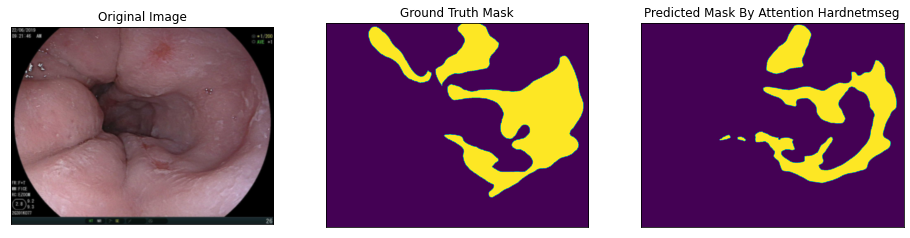

10078.jpeg
Dice =  0.6559972264396811
IOU =  0.48809307786732137


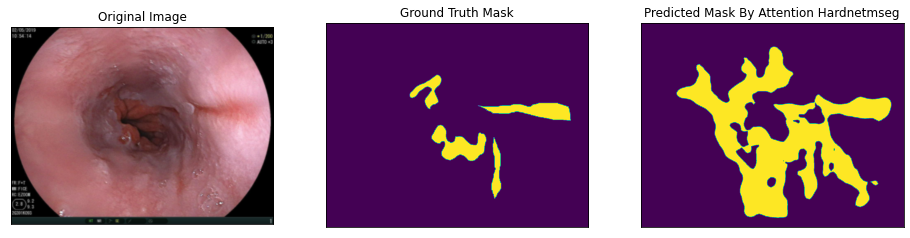

11202.jpeg
Dice =  0.32739531376870434
IOU =  0.19574119858109304


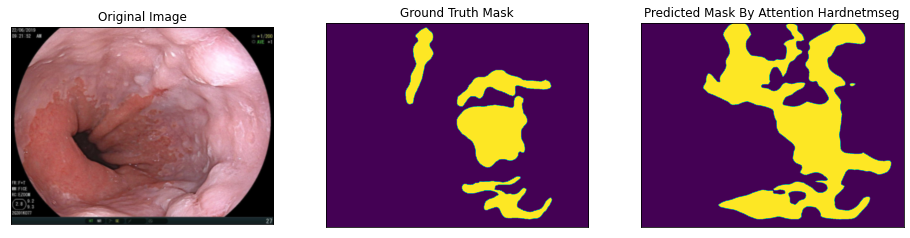

11292.jpeg
Dice =  0.5626703191076448
IOU =  0.391470073434394


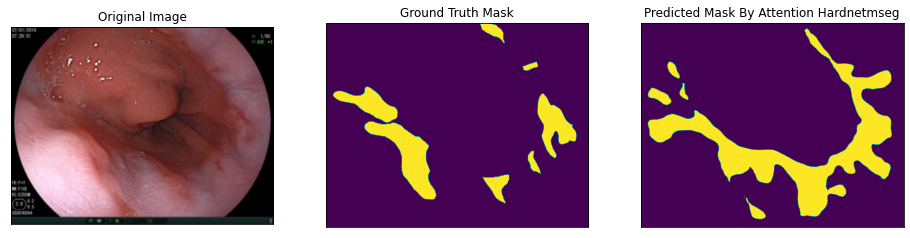

11621.jpeg
Dice =  0.4618936881069128
IOU =  0.30030160255658955


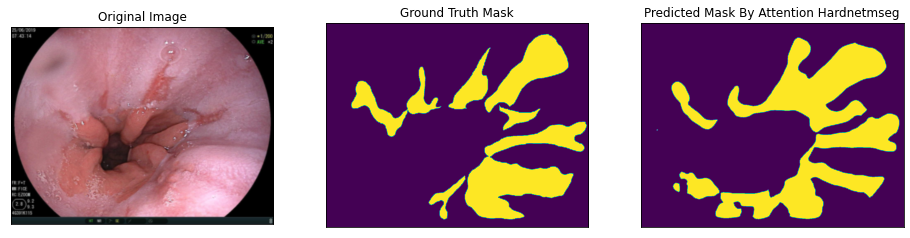

12164.jpeg
Dice =  0.7123162162677072
IOU =  0.5531769516328616


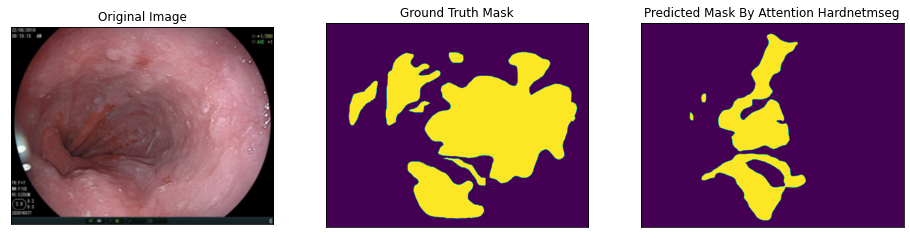

12702.jpeg
Dice =  0.3419144359896615
IOU =  0.2062112342893271


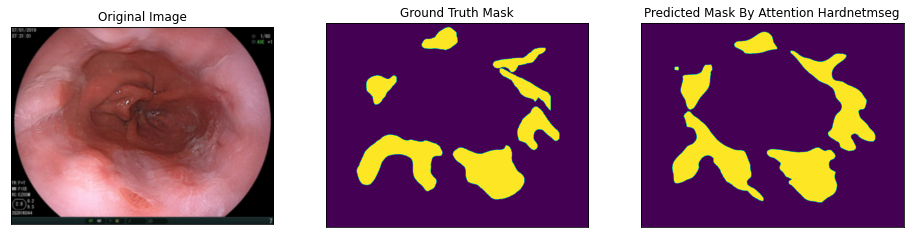

13090.jpeg
Dice =  0.7993896200296915
IOU =  0.6658200457008225


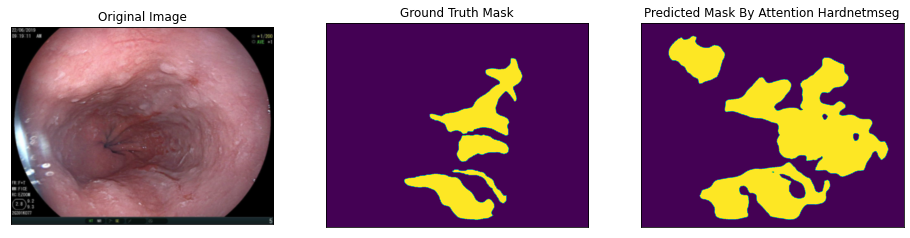

13310.jpeg
Dice =  0.4755733189305968
IOU =  0.31196961537371387


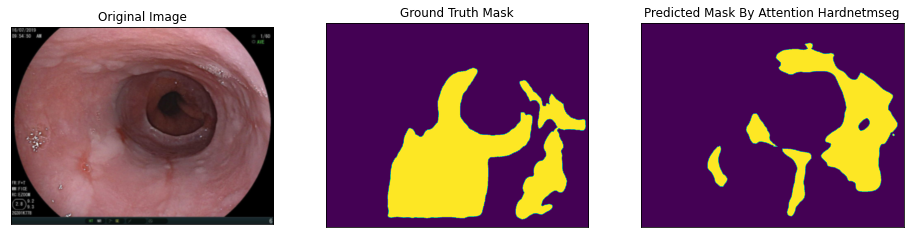

14017.jpeg
Dice =  0.38049845237958596
IOU =  0.23494878191680368


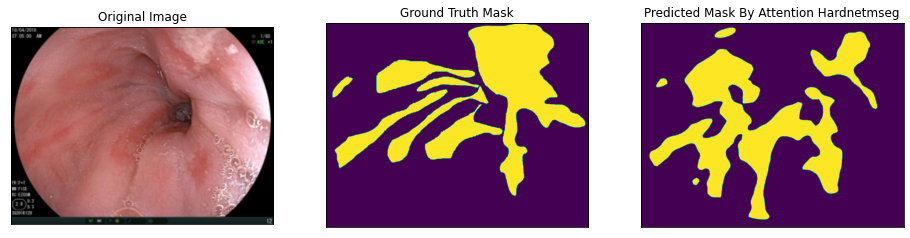

14459.jpeg
Dice =  0.5804842859547454
IOU =  0.40893188270608083


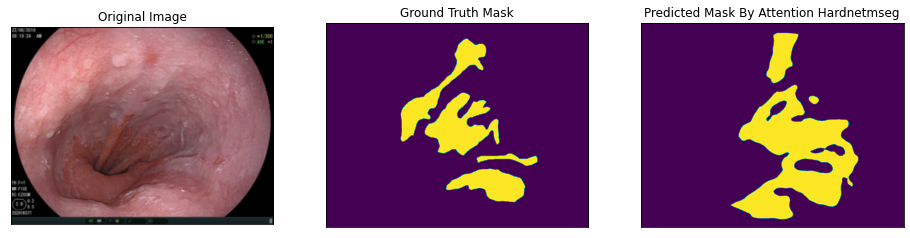

14826.jpeg
Dice =  0.5984377450650893
IOU =  0.42698021285864446


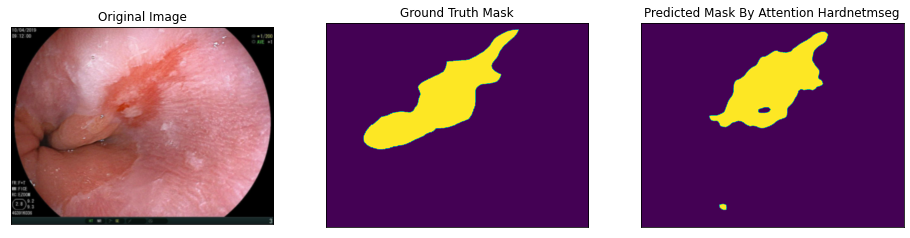

15636.jpeg
Dice =  0.7619121828105758
IOU =  0.6153954784915207


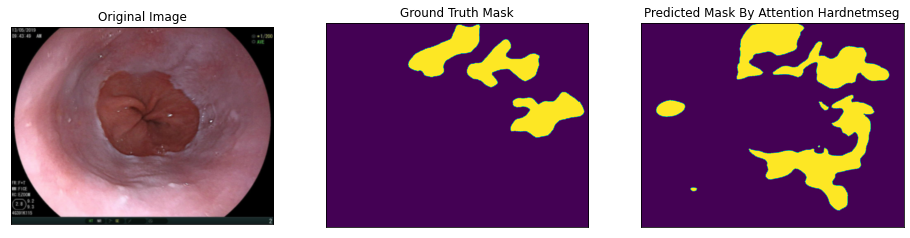

16205.jpeg
Dice =  0.4746468131252644
IOU =  0.31117309051988484


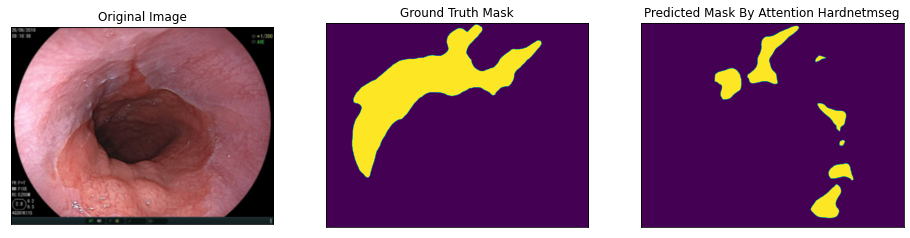

2824.jpeg
Dice =  0.28566208325485026
IOU =  0.16663297236481261


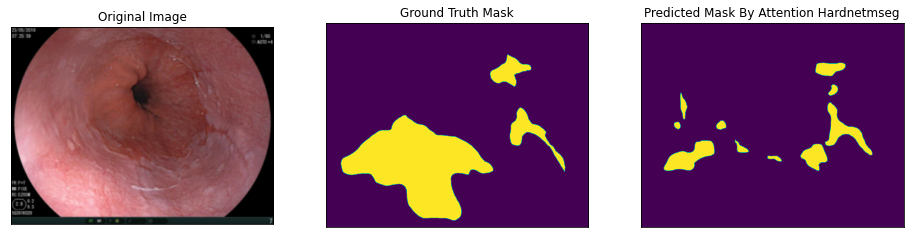

3143.jpeg
Dice =  0.30079671382153045
IOU =  0.17702392384451587


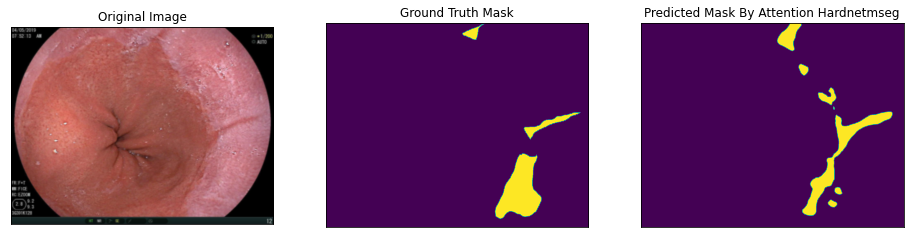

4059.jpeg
Dice =  0.3836648494671185
IOU =  0.2373717730565414


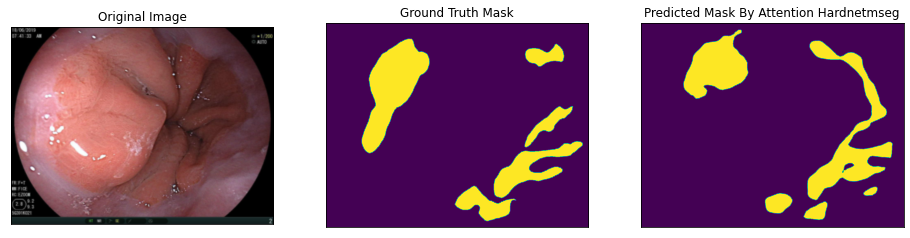

4225.jpeg
Dice =  0.6746891567972227
IOU =  0.5090810276239648


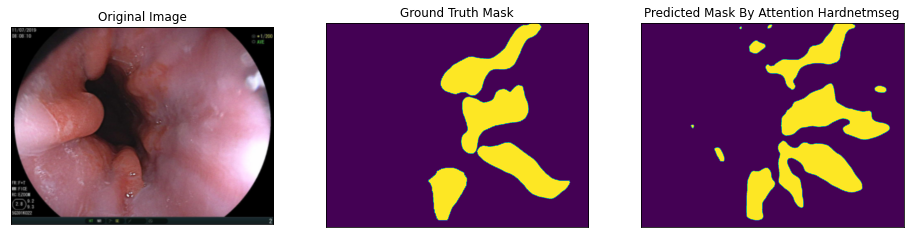

4406.jpeg
Dice =  0.6912171025090006
IOU =  0.5281382428089003


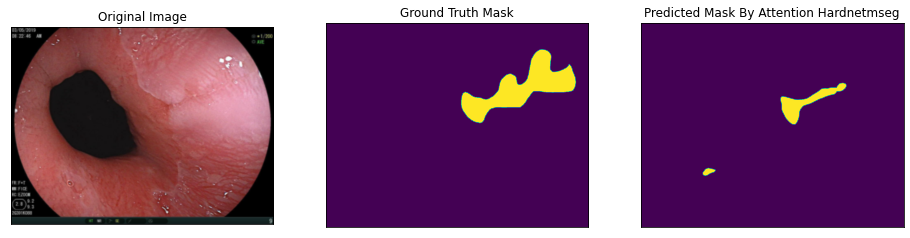

4594.jpeg
Dice =  0.3916781838366903
IOU =  0.2435375491287137


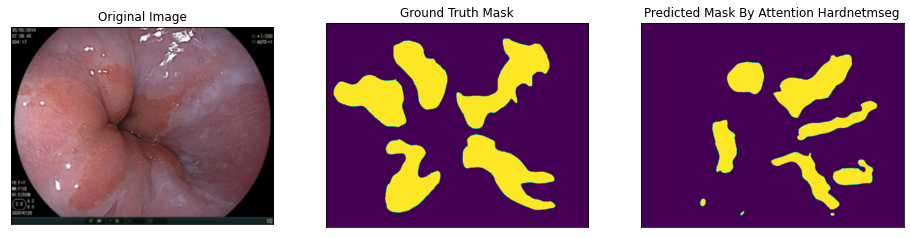

4780.jpeg
Dice =  0.43976196606872087
IOU =  0.2818567019673999


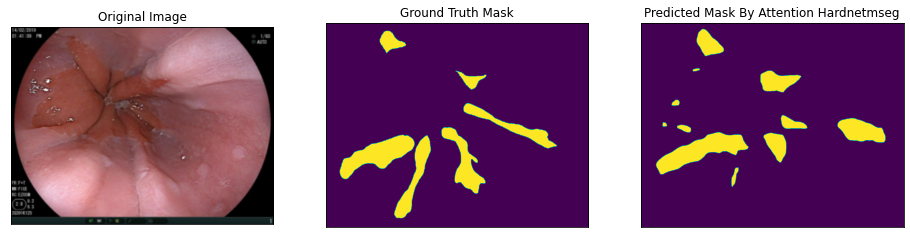

4805.jpeg
Dice =  0.5273792771266398
IOU =  0.3581250080166233


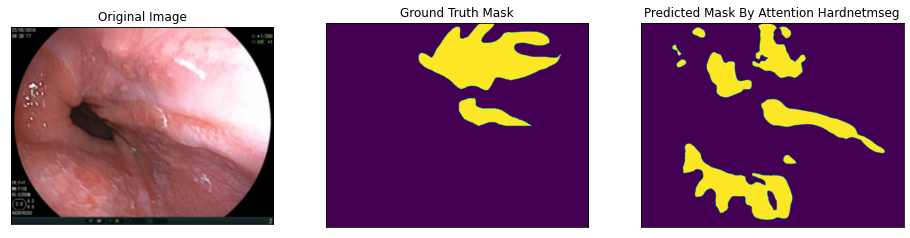

5913.jpeg
Dice =  0.3071993183219116
IOU =  0.18147546543383966


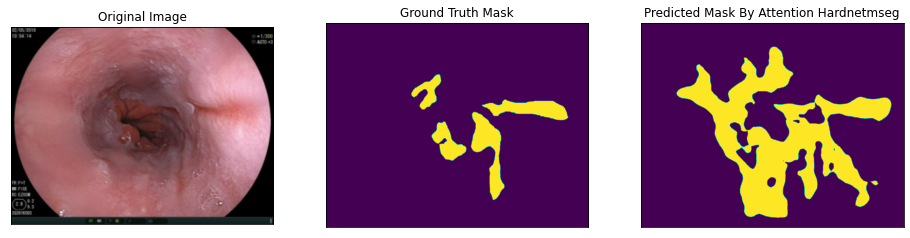

612.jpeg
Dice =  0.400110951032507
IOU =  0.2500879801820327


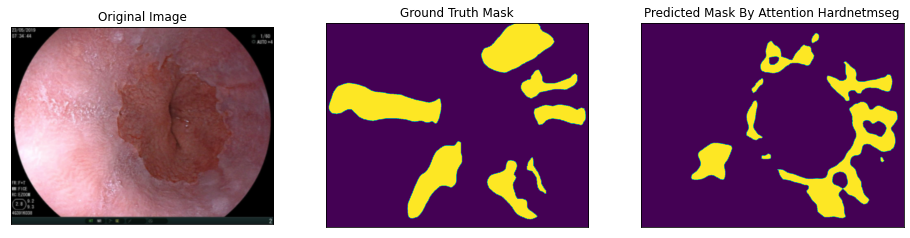

6168.jpeg
Dice =  0.32635834888554693
IOU =  0.19500018559073531


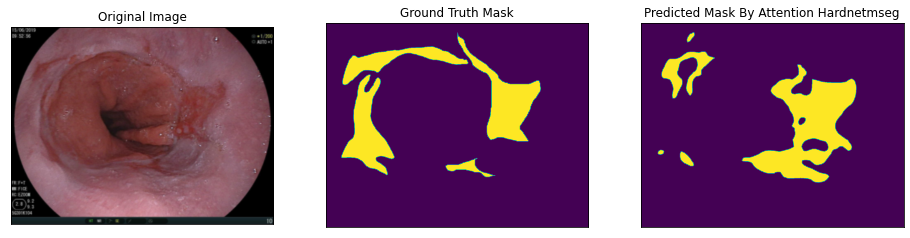

6745.jpeg
Dice =  0.5050744554557655
IOU =  0.33786070038238775


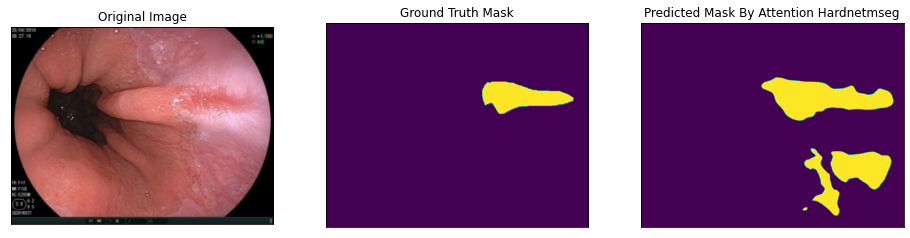

6748.jpeg
Dice =  0.4425022785456783
IOU =  0.2841136961691279


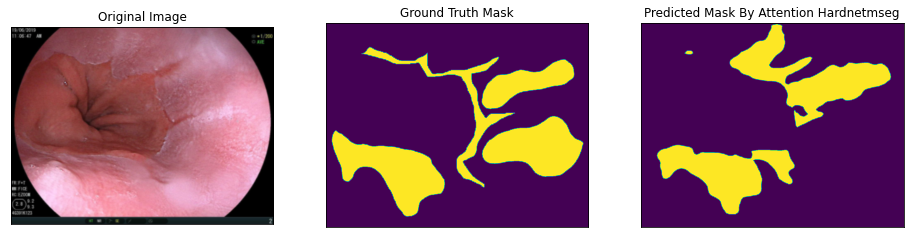

6852.jpeg
Dice =  0.5989700544991846
IOU =  0.4275220277409919


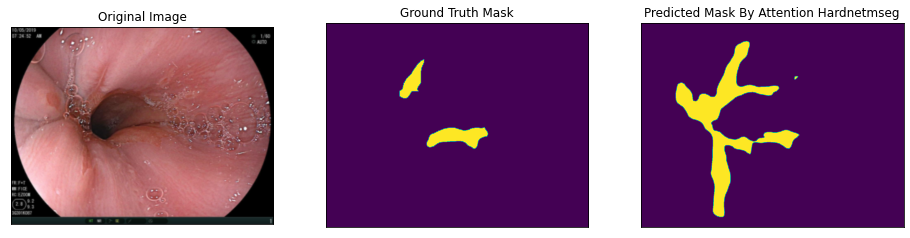

7411.jpeg
Dice =  0.3240576875310482
IOU =  0.19336223346116083


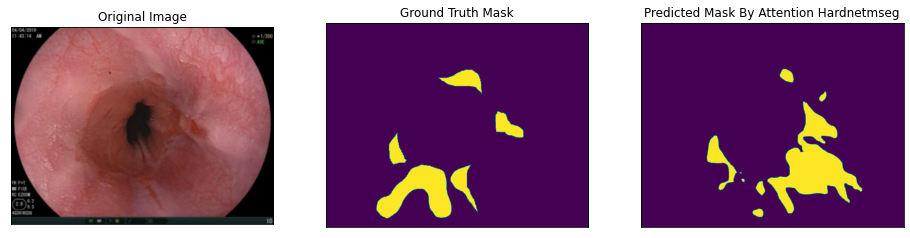

7678.jpeg
Dice =  0.29623546147194124
IOU =  0.17387360871680593


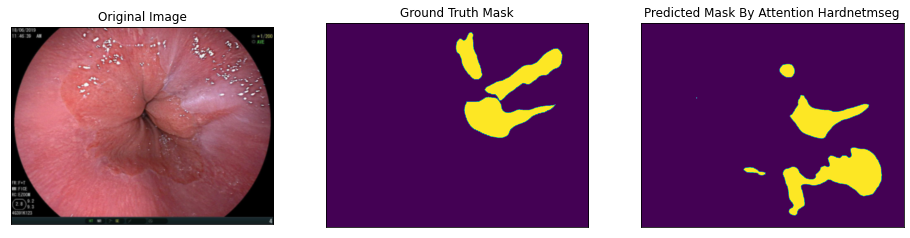

8219.jpeg
Dice =  0.3494520640920553
IOU =  0.2117213151052375


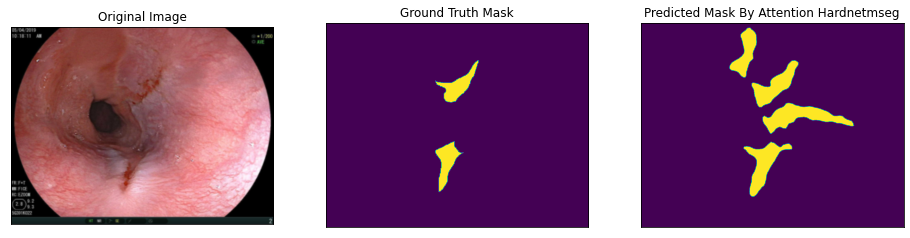

8442.jpeg
Dice =  0.4454606676131193
IOU =  0.2865589509425126


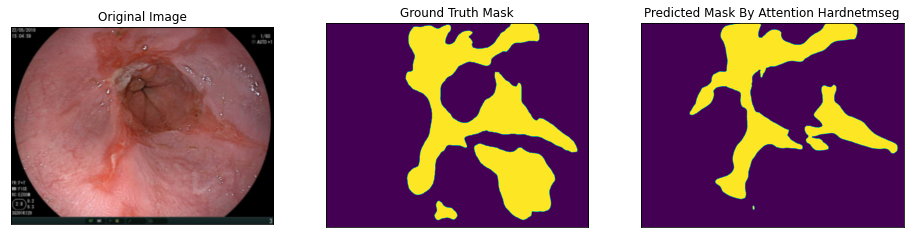

8467.jpeg
Dice =  0.6754559433557431
IOU =  0.5099542111685871


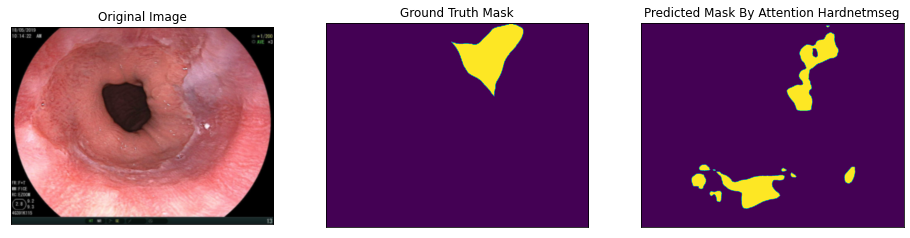

8657.jpeg
Dice =  0.2974792460045571
IOU =  0.1747325665191064


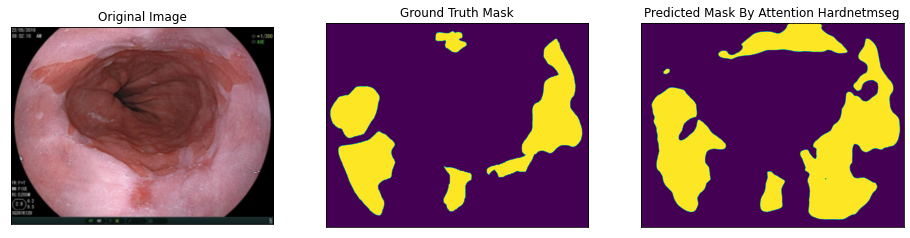

9097.jpeg
Dice =  0.6792035615175673
IOU =  0.5142384818885323


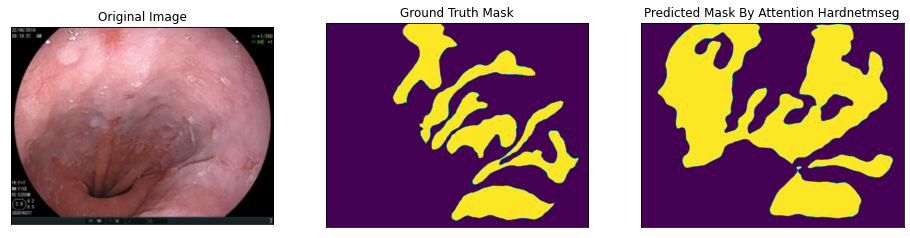

9143.jpeg
Dice =  0.5298703383730249
IOU =  0.3604247937168913


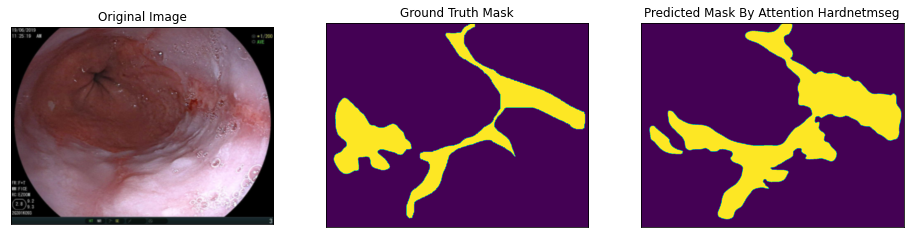

9201.jpeg
Dice =  0.6324533580797518
IOU =  0.46247387806500184


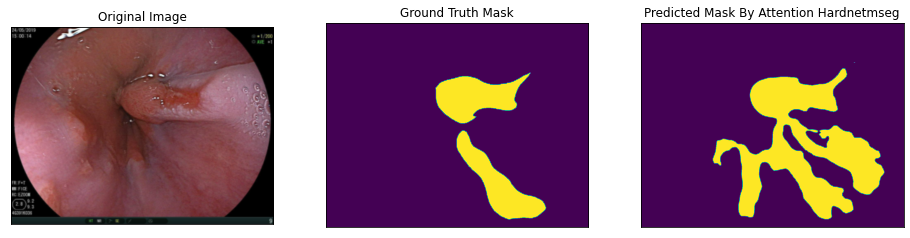

9648.jpeg
Dice =  0.6222781495007984
IOU =  0.4516729295416538
Mean dice =  0.49351731986859015
Mean IOU =  0.34127171538824674


In [ ]:
# Load checkpoint
print('| Resuming from checkpoint...')
# assert os.path.isdir('checkpoint'), 'Error: No checkpoint directory found!'
# _, file_name = getNetwork(args)
# model_2 = model

checkpoint = torch.load('/content/drive/MyDrive/Data_Segmentation/HarD-MSEG-best-BBB.pth')
model.load_state_dict(checkpoint['model'])
best_acc = checkpoint['acc']
start_epoch = checkpoint['epoch']

# checkpoint_2 = torch.load('/content/drive/MyDrive/Data_Segmentation/HarD-MSEG-best.pth')
# model_2.load_state_dict(checkpoint_2['model'])

class test_dataset_visualize:
    def __init__(self, image_root, gt_root, testsize):
        self.testsize = testsize
        self.images = [image_root + f for f in os.listdir(image_root) if f.endswith('.jpeg') or f.endswith('.png')]
        self.gts = [gt_root + f for f in os.listdir(gt_root) if f.endswith('.jpeg') or f.endswith('.png')]
        self.images = sorted(self.images)
        self.gts = sorted(self.gts)
        self.transform = transforms.Compose([
            transforms.Resize((self.testsize, self.testsize)),
            transforms.ToTensor(),
            transforms.Normalize([0.485, 0.456, 0.406],
                                 [0.229, 0.224, 0.225])])
        self.transforms_visual = transforms.Compose([
            transforms.Resize((self.testsize, self.testsize)),
            transforms.ToTensor()])
        self.gt_transform = transforms.ToTensor()
        self.size = len(self.images)
        self.index = 0

    def load_data(self):
        image = self.rgb_loader(self.images[self.index])
        image = self.transform(image).unsqueeze(0)

        image_visual = self.rgb_loader(self.images[self.index])
        image_visual = self.transforms_visual(image_visual).unsqueeze(0)

        gt = self.binary_loader(self.gts[self.index])
        name = self.images[self.index].split('/')[-1]
        # if name.endswith('.jpg'):
        #     name = name.split('.jpg')[0] + '.png'
        self.index += 1
        return image, image_visual, gt, name

    def rgb_loader(self, path):
        with open(path, 'rb') as f:
            img = Image.open(f)
            return img.convert('RGB')

    def binary_loader(self, path):
        with open(path, 'rb') as f:
            img = Image.open(f)
            return img.convert('L')

def visualize(**images):
    n = len(images)
    plt.figure(figsize=(16, 5))
    for i, (name, image) in enumerate(images.items()):
        plt.subplot(1, n, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.title(' '.join(name.split('_')).title())
        # if image.shape[0] == 3:
        #     image = image.transpose([1, 2, 0])
        plt.imshow(image)
    plt.show()

    
model.eval()
test_path = '/content/traoNguocLoaiB/test'
image_root = '{}/Orig/'.format(test_path)
gt_root = '{}/GT/'.format(test_path)
test_loader = test_dataset_visualize(image_root, gt_root, testsize = 352)
b=0.0
IOU=0.0
for i in range(test_loader.size):
    image, image_visual, gt, name = test_loader.load_data()
    gt = np.asarray(gt, np.float32)
    gt /= (gt.max() + 1e-8)
    image = image.cuda()
    
    res  = model(image)
    res = F.upsample(res, size=gt.shape, mode='bilinear', align_corners=False)
    res = res.sigmoid().data.cpu().numpy().squeeze()
    res = (res - res.min()) / (res.max() - res.min() + 1e-8)
    res = res.round()
    
    input = res
    target = np.array(gt)
    N = gt.shape
    smooth = 1
    input_flat = np.reshape(input,(-1))
    target_flat = np.reshape(target,(-1))

    intersection = (input_flat*target_flat)
    
    loss =  (2 * intersection.sum() + smooth) / (input.sum() + target.sum() + smooth)
    iou = ((gt * res).sum() + 1) / (gt.sum() + res.sum() - (gt * res).sum() + 1)

    b += loss
    IOU += iou

    image_visual = F.upsample(image_visual, size=(960, 1280), mode='bilinear', align_corners=False)
    image_visual = image_visual.squeeze().permute(1, 2, 0).cpu().numpy()
    visualize(
        original_image=image_visual, 
        ground_truth_mask=gt, 
        predicted_mask_by_Attention_HardNetMSEG=res
        # predicted_mask_erosion_with_dilation=pr_mask_er
    )
    print(name)
    print("Dice = ", loss)
    print("IOU = ", iou)
    
print("Mean dice = ", b / test_loader.size)
print("Mean IOU = ", IOU / test_loader.size)

| Resuming from checkpoint...


/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:3635: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode)
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:3509: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")


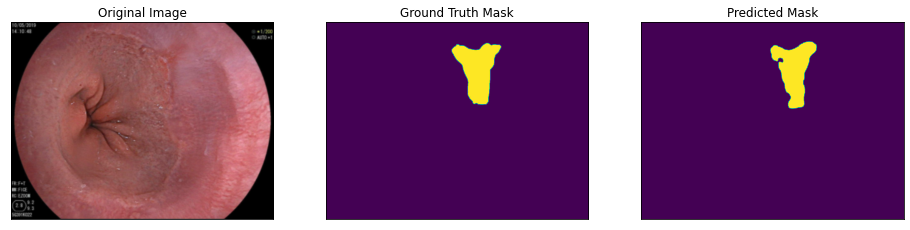

Dice =  0.9035
IOU =  0.8239


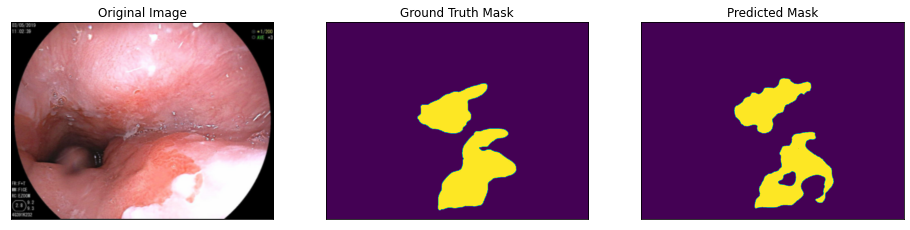

Dice =  0.8236
IOU =  0.7001


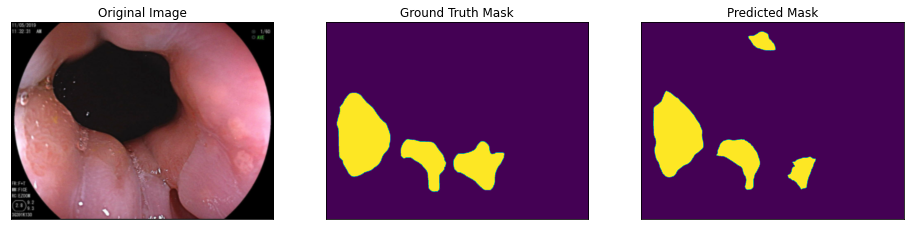

Dice =  0.841
IOU =  0.7256


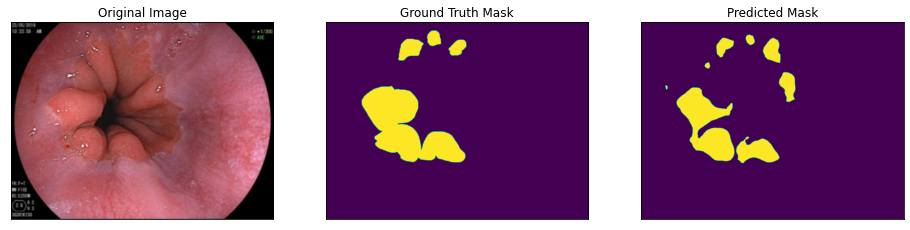

Dice =  0.7692
IOU =  0.6249


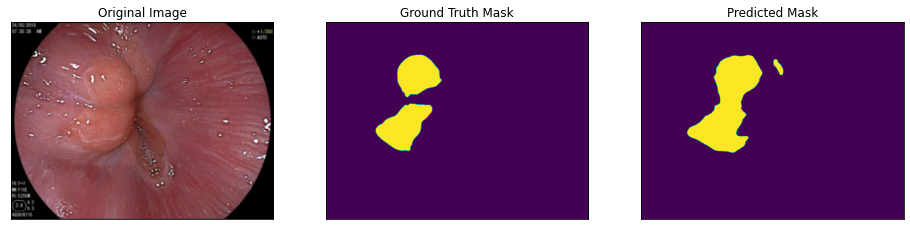

Dice =  0.8203
IOU =  0.6954


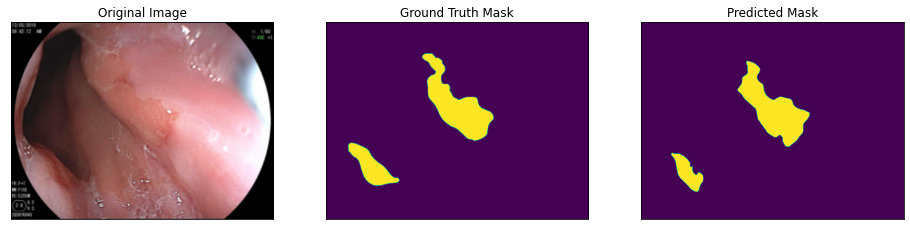

Dice =  0.8525
IOU =  0.7429


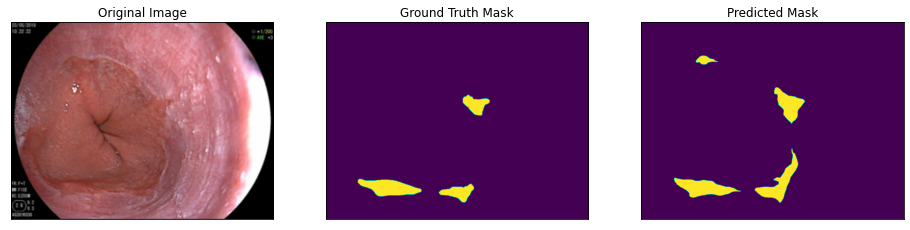

Dice =  0.7566
IOU =  0.6085


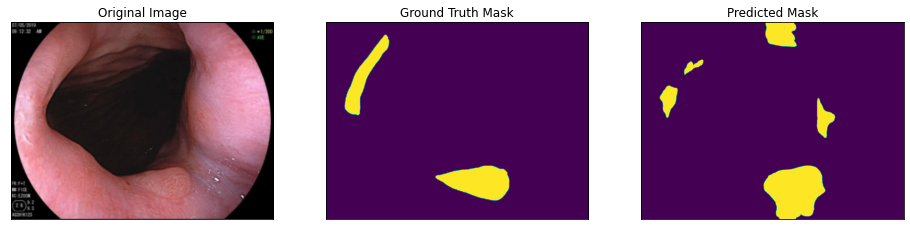

Dice =  0.5505
IOU =  0.3798


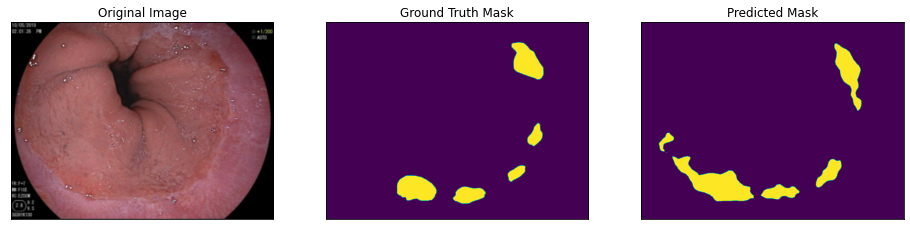

Dice =  0.6129
IOU =  0.4418


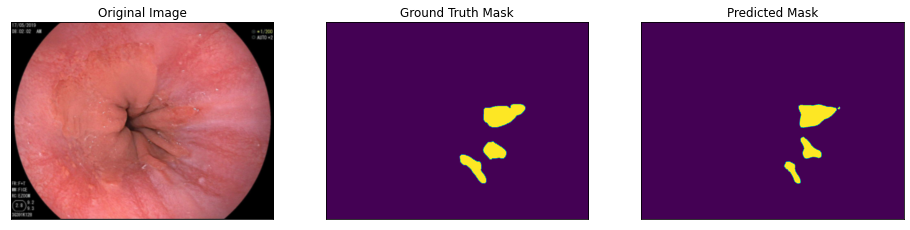

Dice =  0.8045
IOU =  0.673


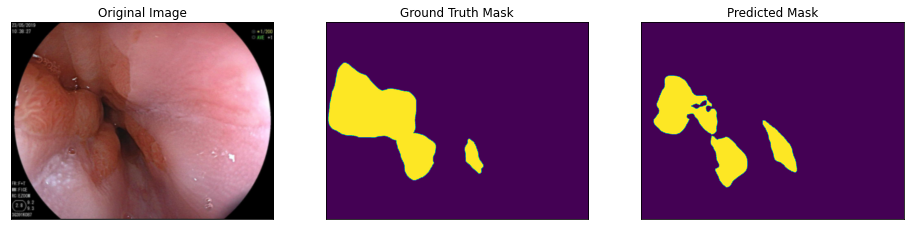

Dice =  0.6921
IOU =  0.5291


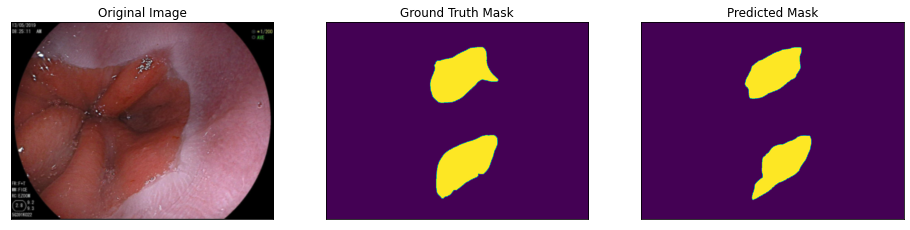

Dice =  0.8769
IOU =  0.7808


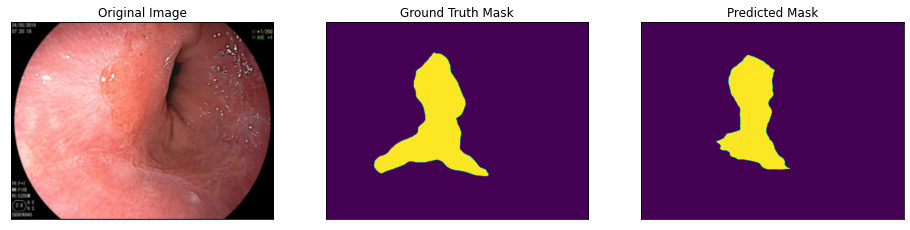

Dice =  0.8338
IOU =  0.715


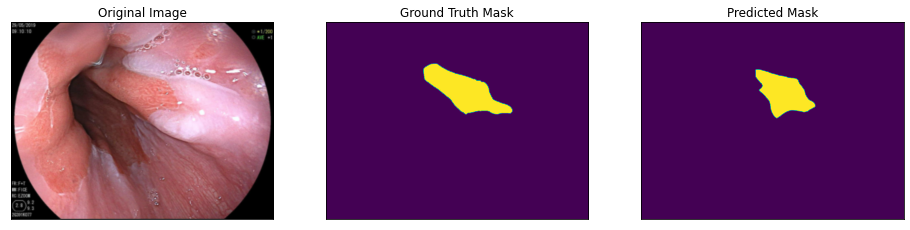

Dice =  0.8084
IOU =  0.6784


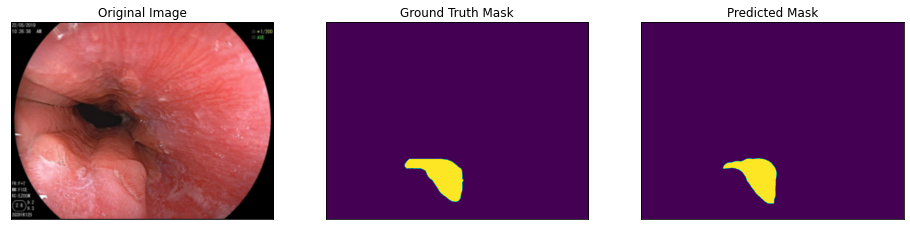

Dice =  0.9214
IOU =  0.8542


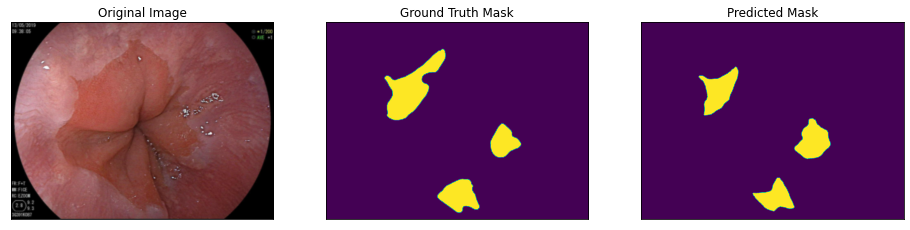

Dice =  0.7559
IOU =  0.6076


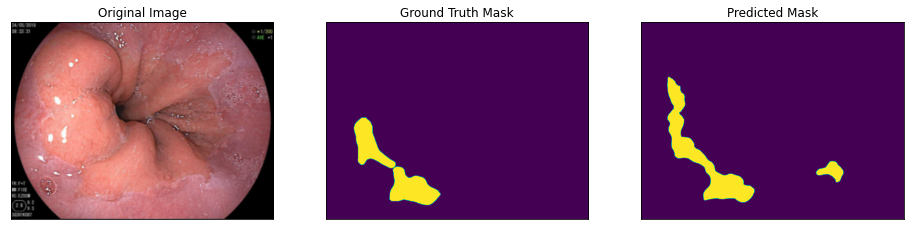

Dice =  0.7297
IOU =  0.5744


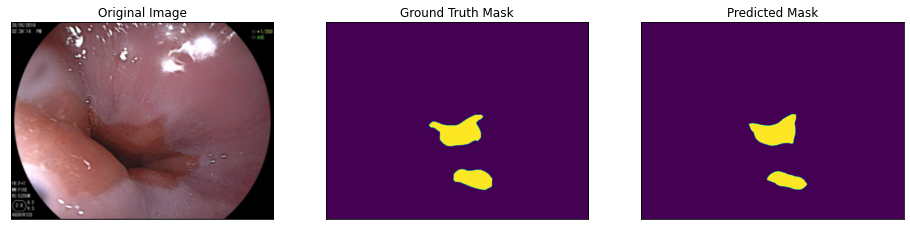

Dice =  0.8892
IOU =  0.8004


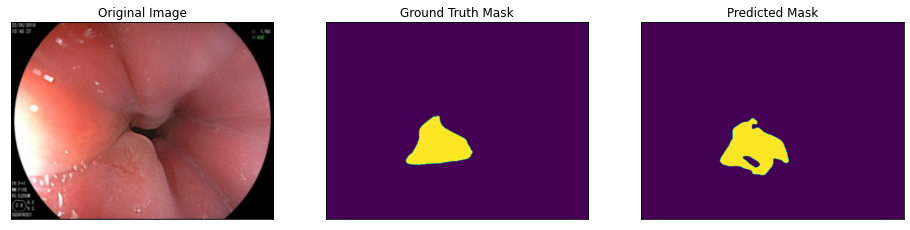

Dice =  0.8615
IOU =  0.7567


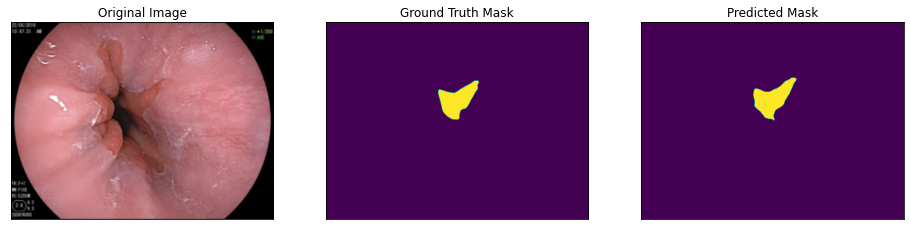

Dice =  0.9303
IOU =  0.8696


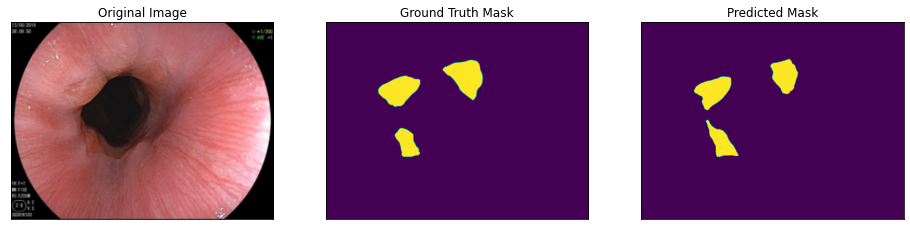

Dice =  0.8509
IOU =  0.7405


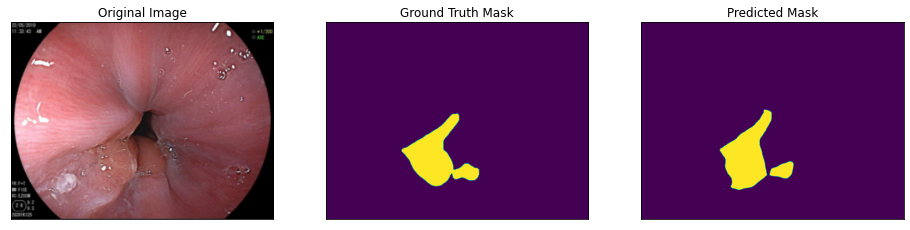

Dice =  0.8799
IOU =  0.7856


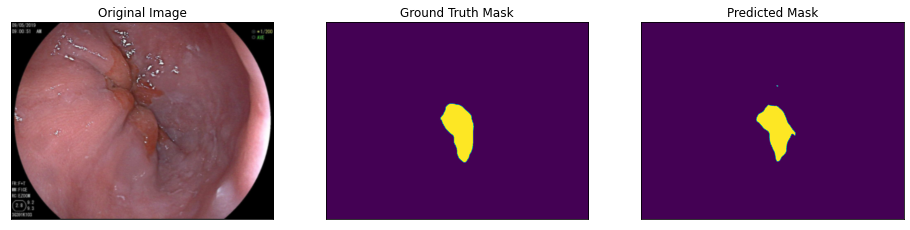

Dice =  0.9018
IOU =  0.8211


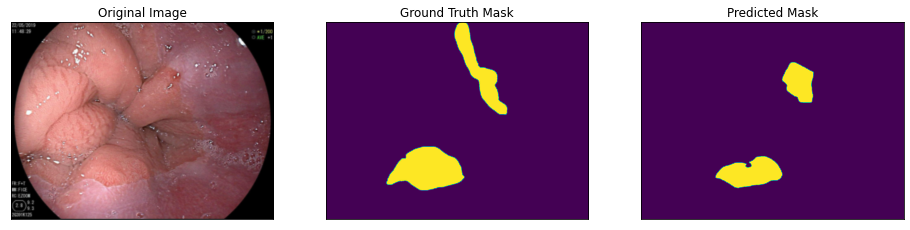

Dice =  0.6568
IOU =  0.489


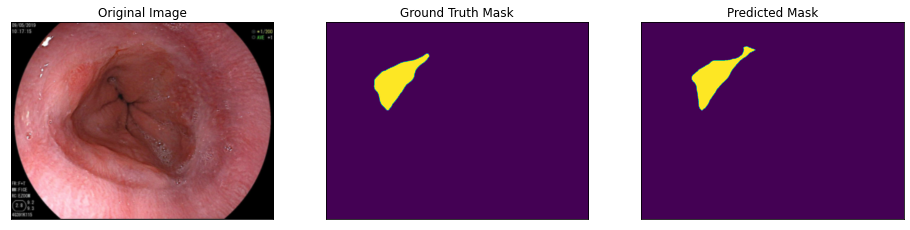

Dice =  0.8764
IOU =  0.78


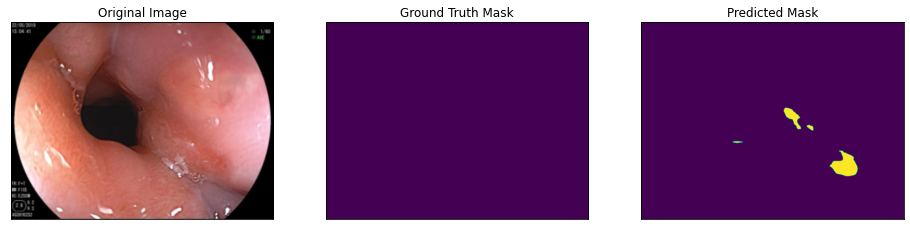

Dice =  0.0001
IOU =  0.0001


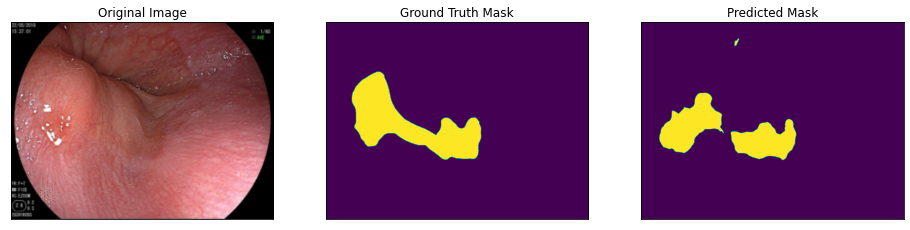

Dice =  0.7254
IOU =  0.5691


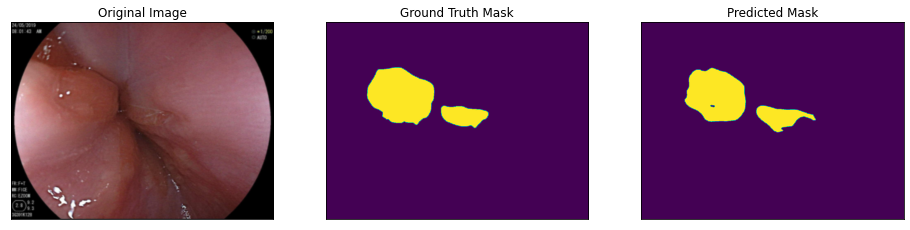

Dice =  0.9199
IOU =  0.8516


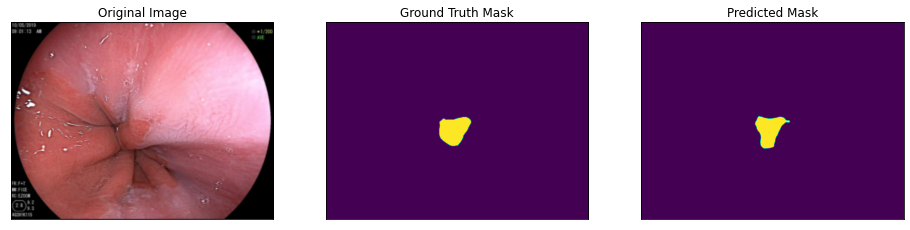

Dice =  0.8613
IOU =  0.7564


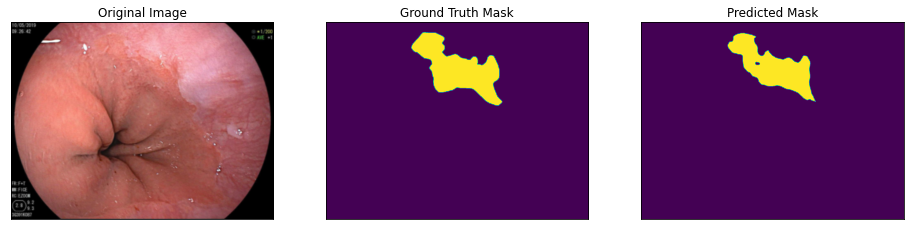

Dice =  0.8764
IOU =  0.78


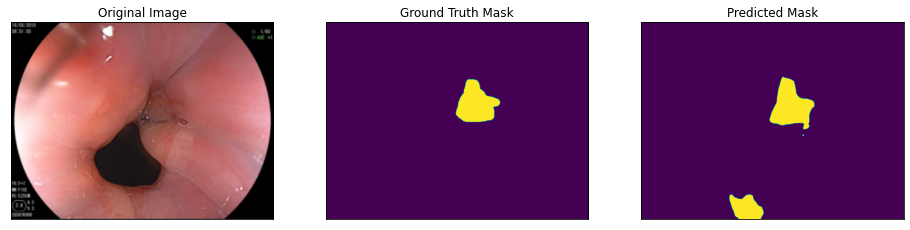

Dice =  0.7151
IOU =  0.5565


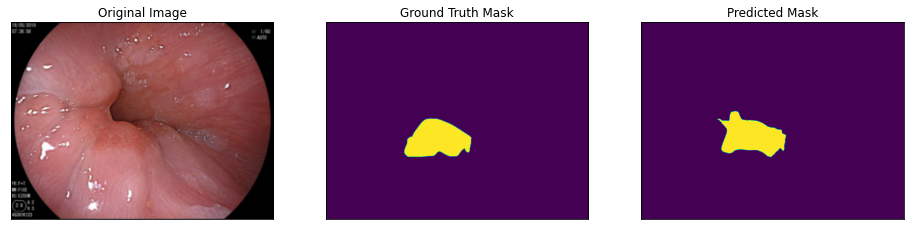

Dice =  0.8589
IOU =  0.7527


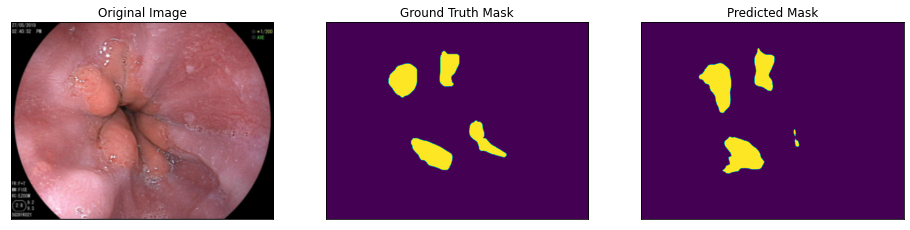

Dice =  0.737
IOU =  0.5835


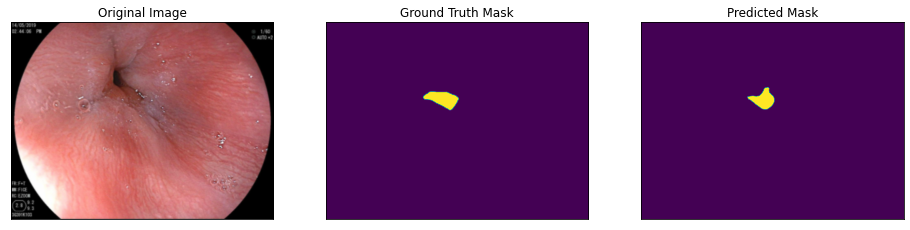

Dice =  0.7181
IOU =  0.5602


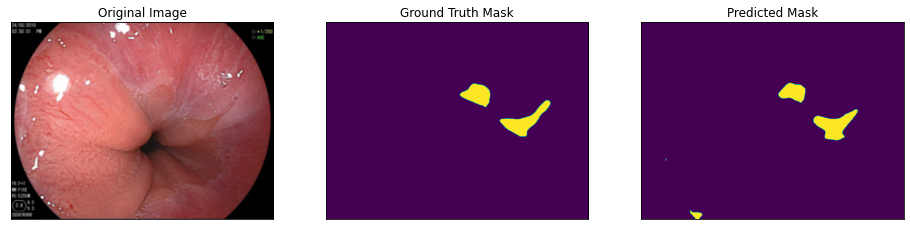

Dice =  0.7899
IOU =  0.6528


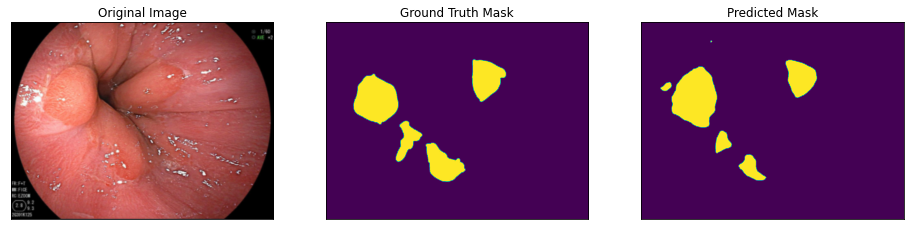

Dice =  0.7546
IOU =  0.606


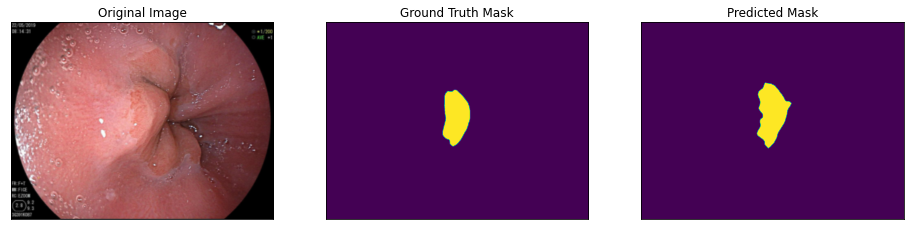

Dice =  0.8792
IOU =  0.7845


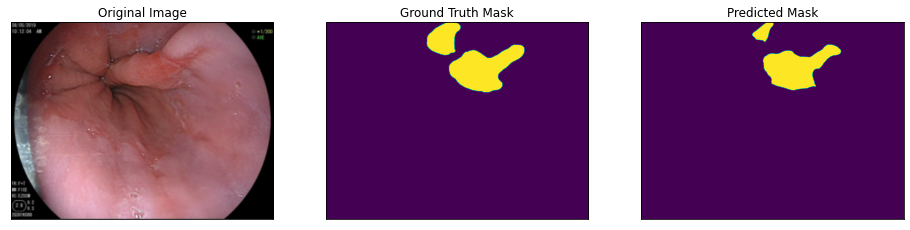

Dice =  0.8256
IOU =  0.7029


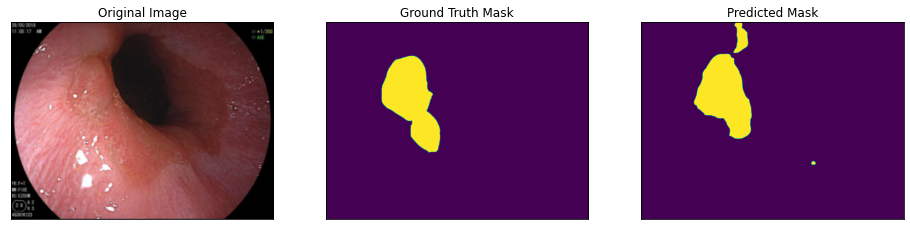

Dice =  0.8399
IOU =  0.724


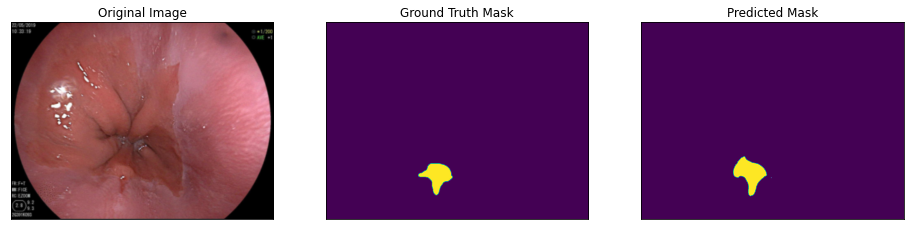

Dice =  0.8368
IOU =  0.7195


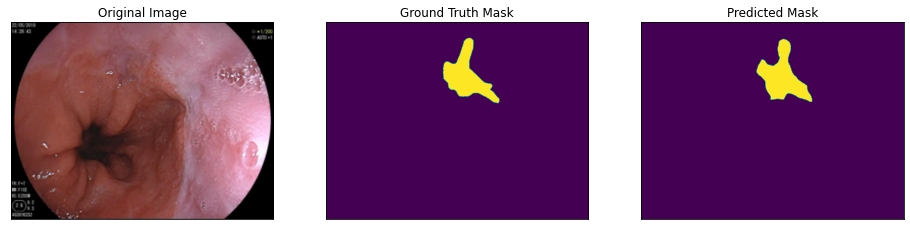

Dice =  0.8672
IOU =  0.7656


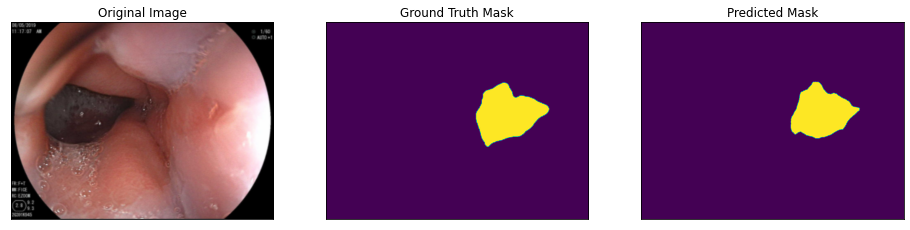

Dice =  0.9019
IOU =  0.8214


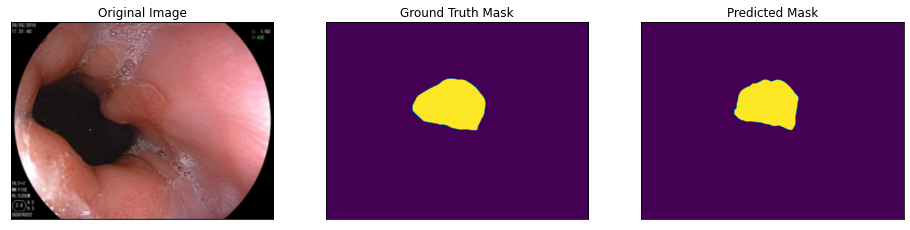

Dice =  0.9214
IOU =  0.8542


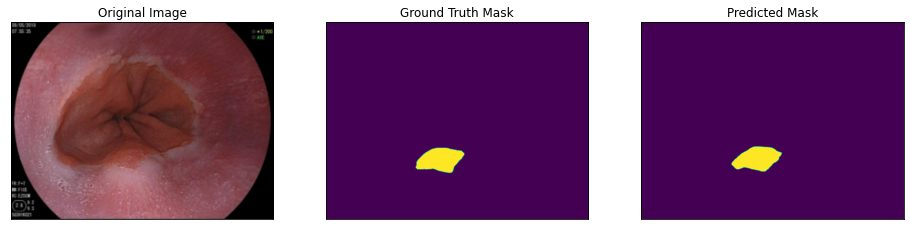

Dice =  0.9114
IOU =  0.8373


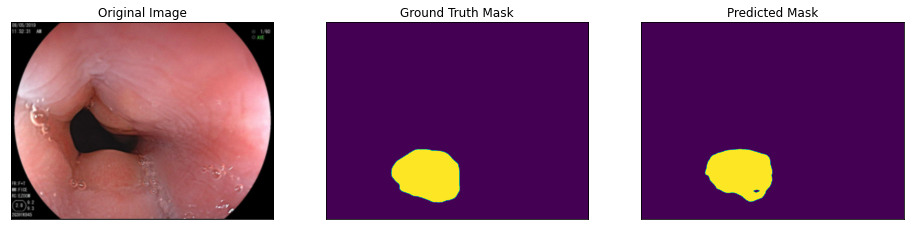

Dice =  0.9248
IOU =  0.8602


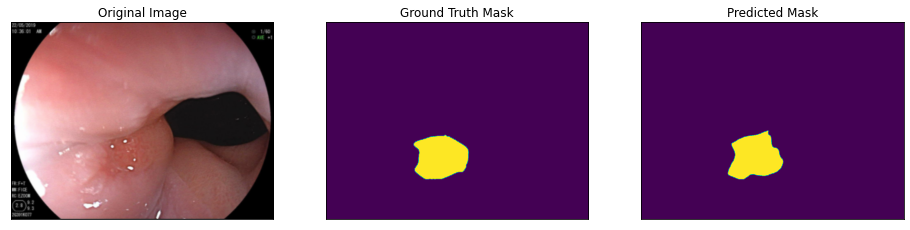

Dice =  0.9226
IOU =  0.8563


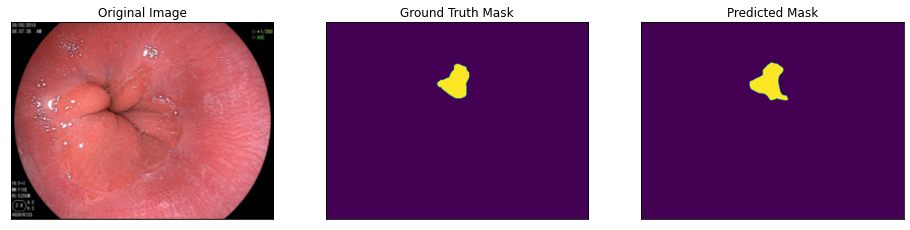

Dice =  0.8262
IOU =  0.7038


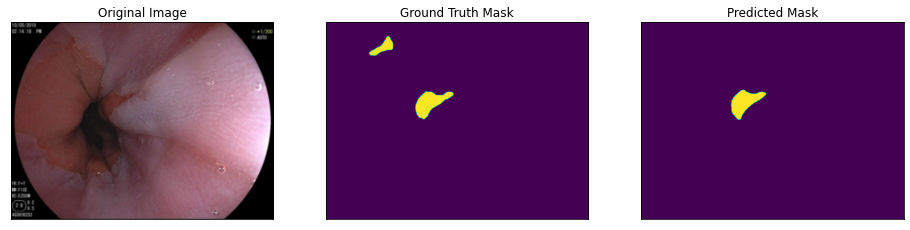

Dice =  0.7702
IOU =  0.6263


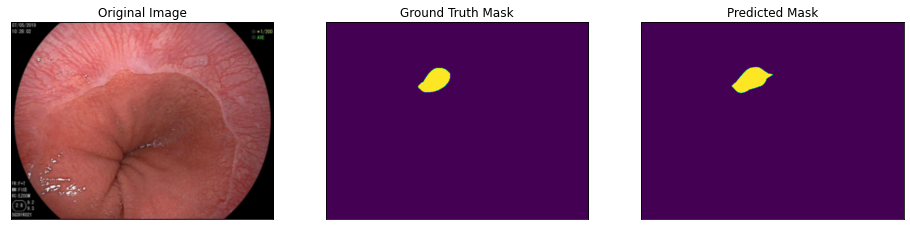

Dice =  0.9043
IOU =  0.8253


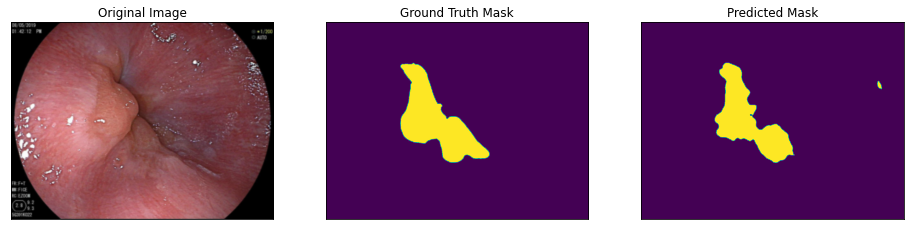

Dice =  0.8798
IOU =  0.7854


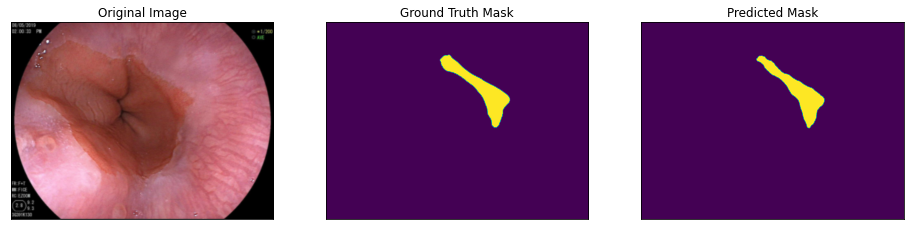

Dice =  0.9121
IOU =  0.8385


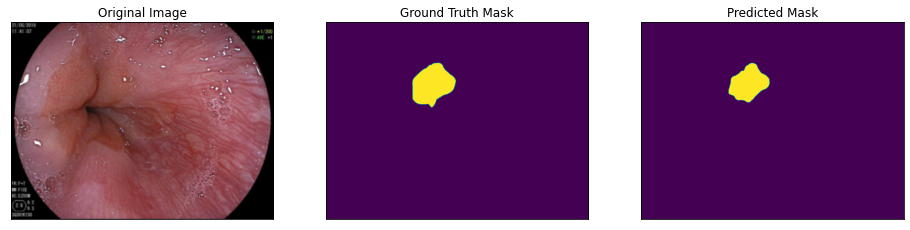

Dice =  0.8765
IOU =  0.7802


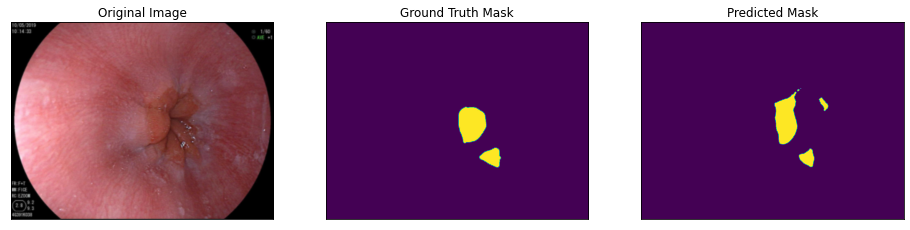

Dice =  0.7572
IOU =  0.6093


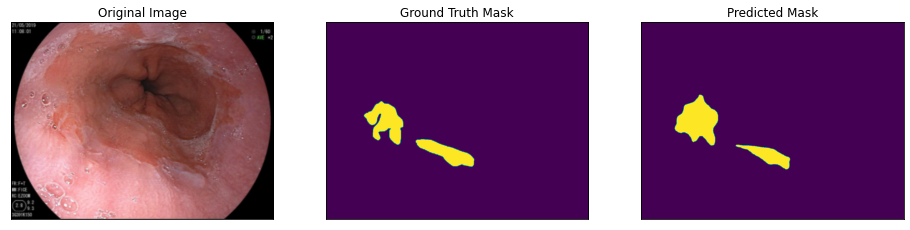

Dice =  0.796
IOU =  0.6612


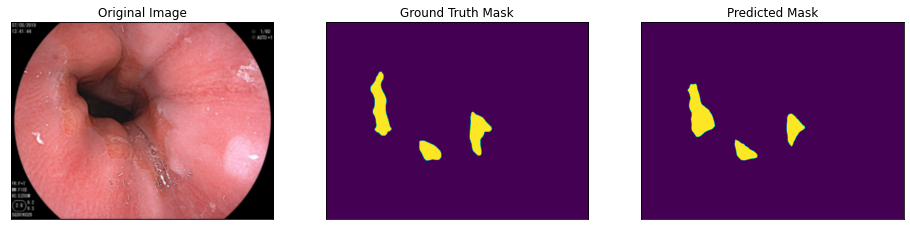

Dice =  0.7772
IOU =  0.6357


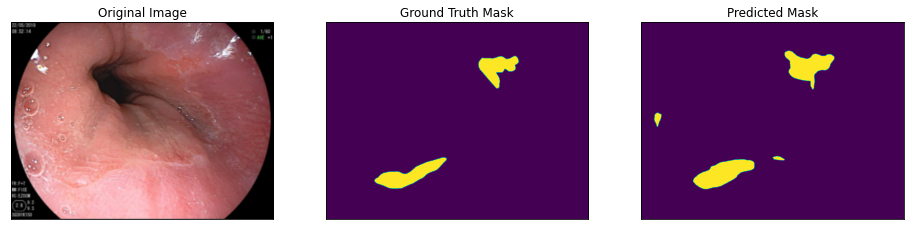

Dice =  0.7732
IOU =  0.6303


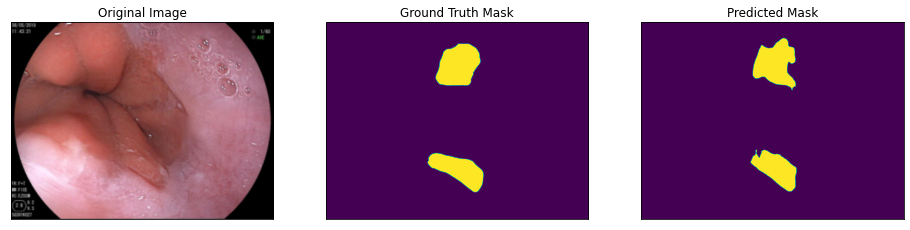

Dice =  0.8523
IOU =  0.7427


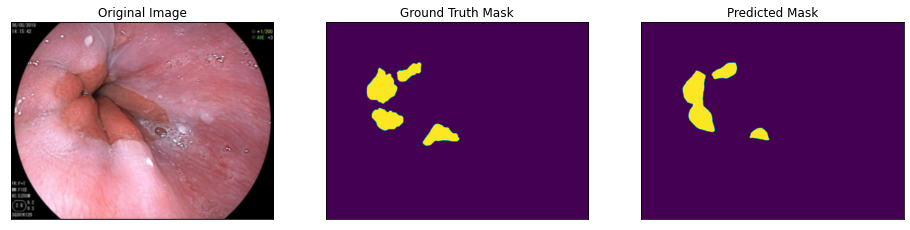

Dice =  0.7697
IOU =  0.6256


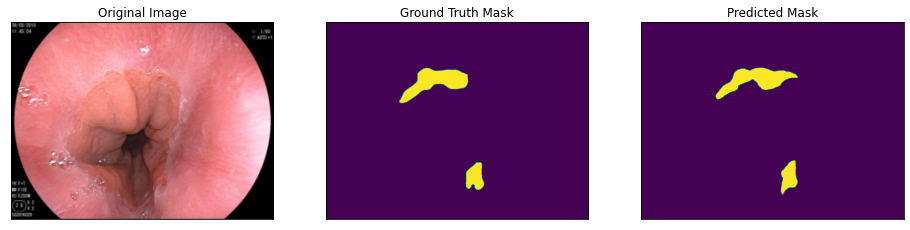

Dice =  0.8241
IOU =  0.7008


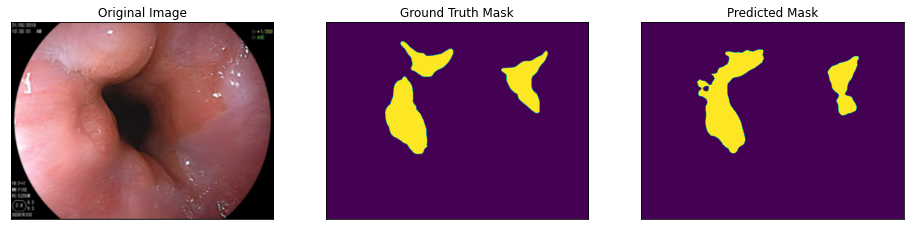

Dice =  0.8176
IOU =  0.6915


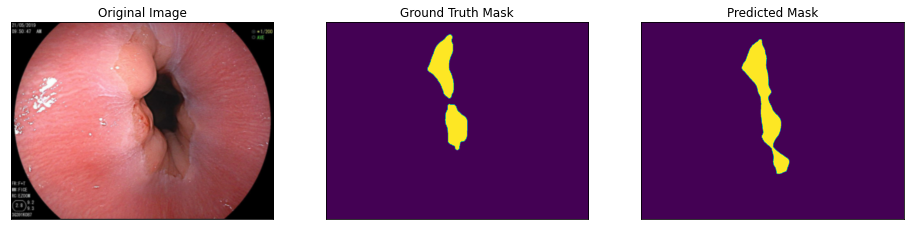

Dice =  0.8207
IOU =  0.6959


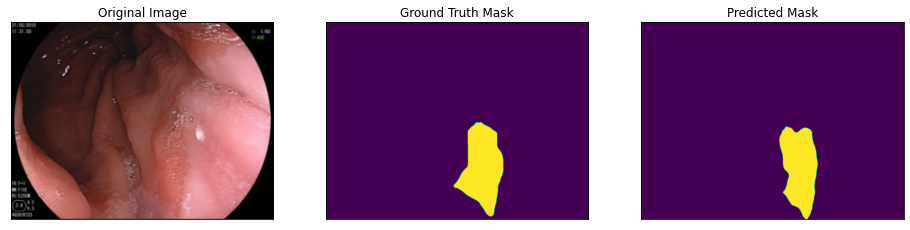

Dice =  0.8781
IOU =  0.7827


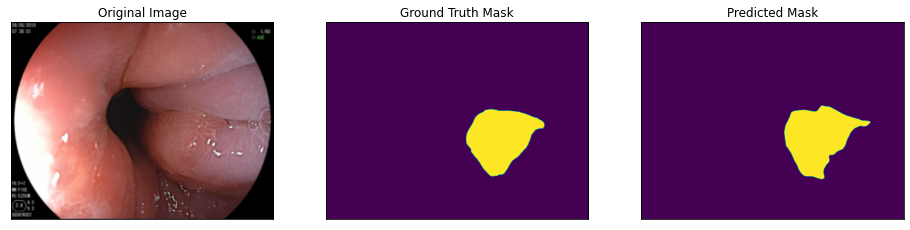

Dice =  0.9311
IOU =  0.871


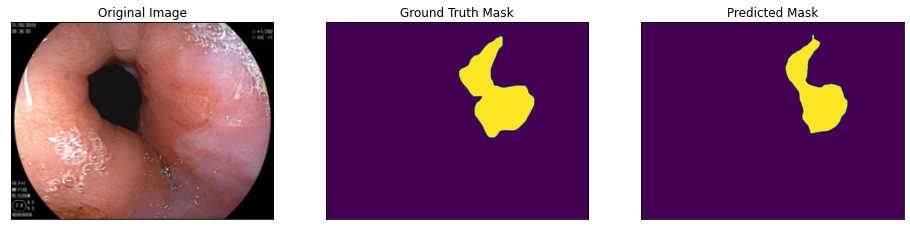

Dice =  0.8324
IOU =  0.713


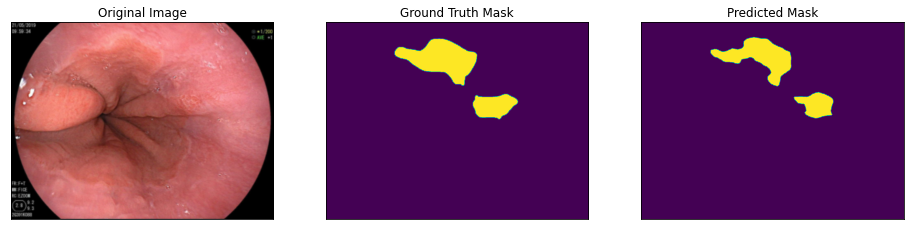

Dice =  0.8023
IOU =  0.6698


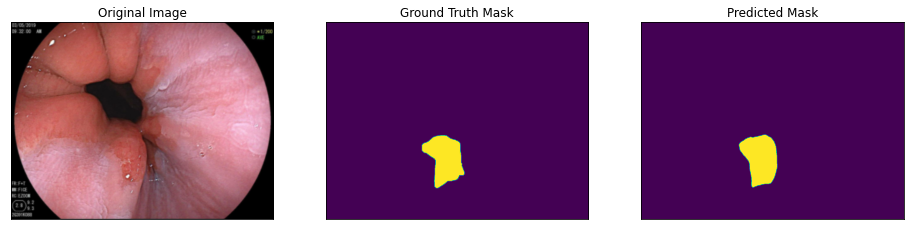

Dice =  0.9278
IOU =  0.8653


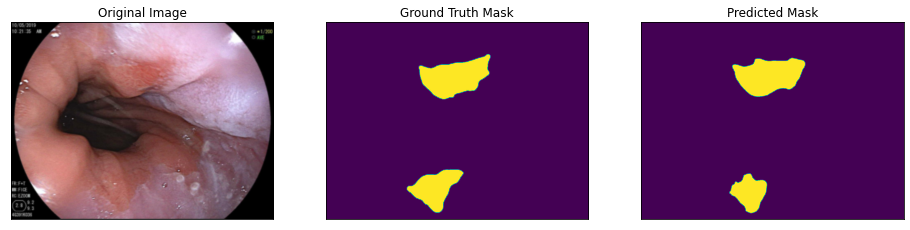

Dice =  0.8653
IOU =  0.7626


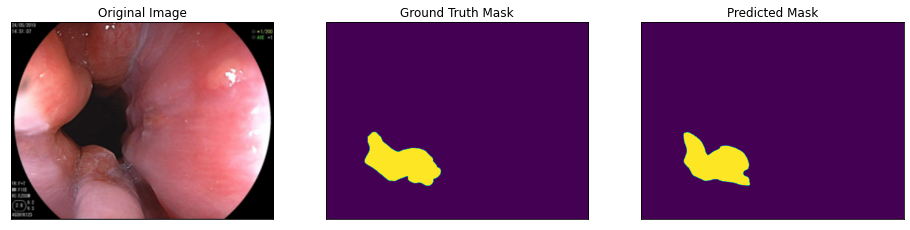

Dice =  0.9152
IOU =  0.8437


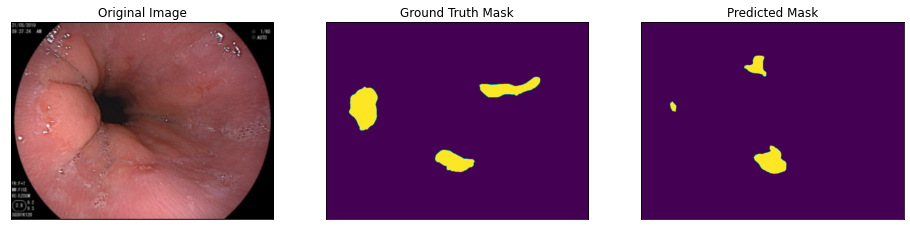

Dice =  0.3174
IOU =  0.1887


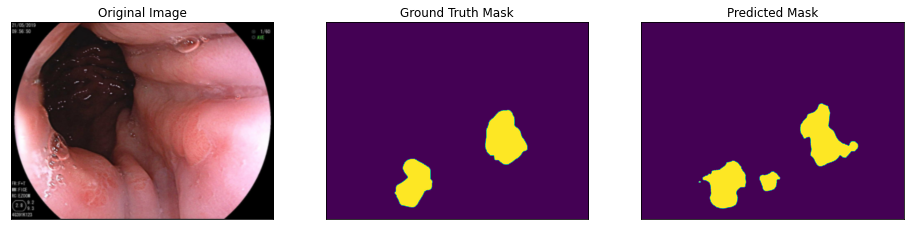

Dice =  0.7929
IOU =  0.6568


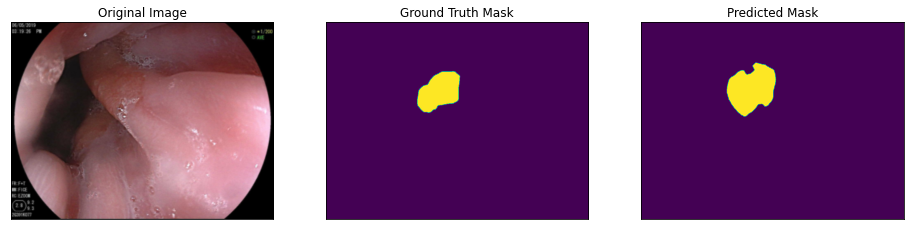

Dice =  0.8148
IOU =  0.6875


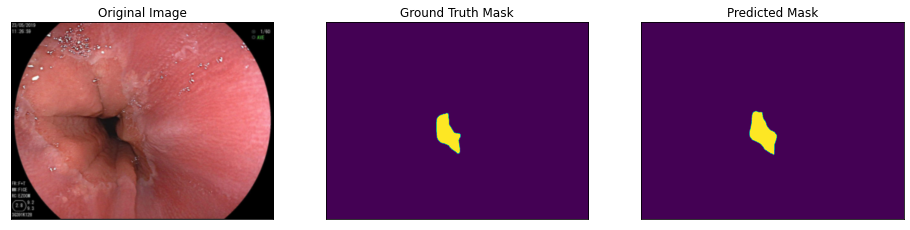

Dice =  0.892
IOU =  0.8051


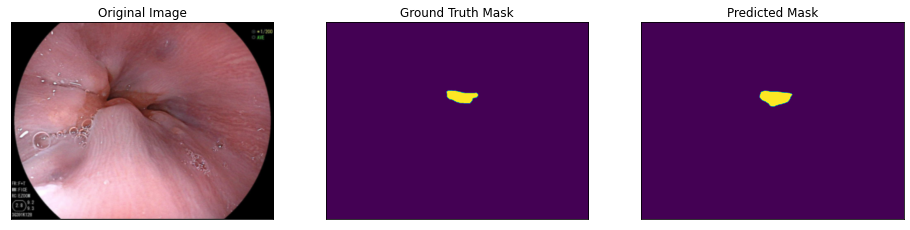

Dice =  0.8448
IOU =  0.7313


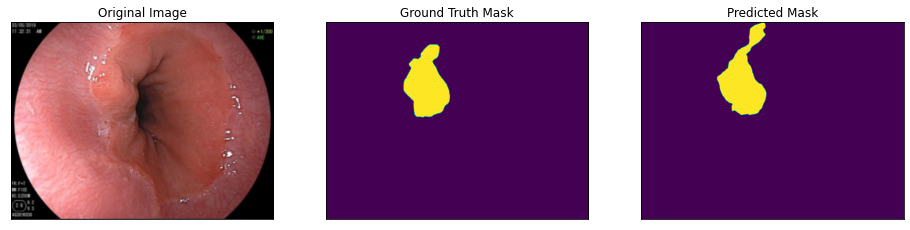

Dice =  0.8637
IOU =  0.7601


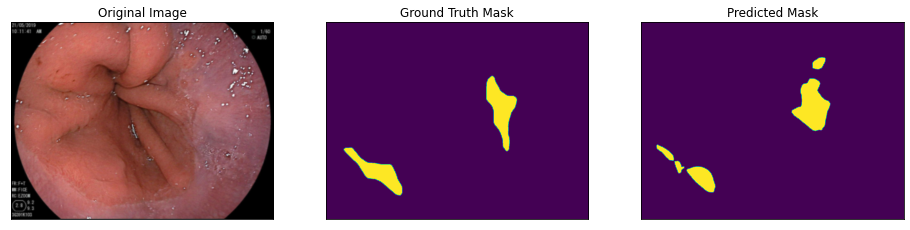

Dice =  0.735
IOU =  0.581


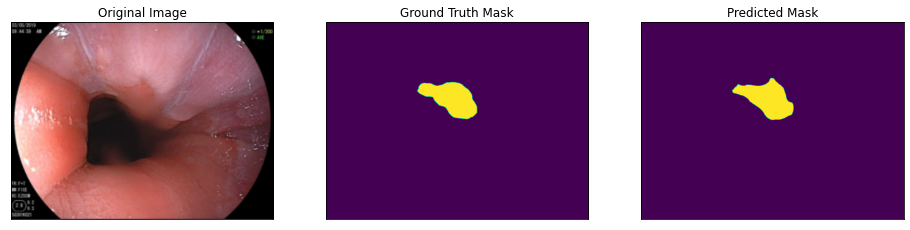

Dice =  0.935
IOU =  0.8779


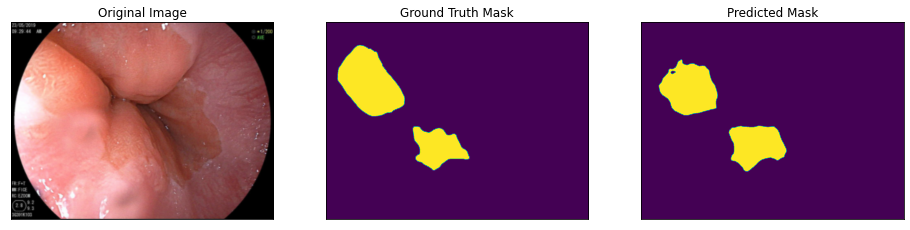

Dice =  0.8303
IOU =  0.7098


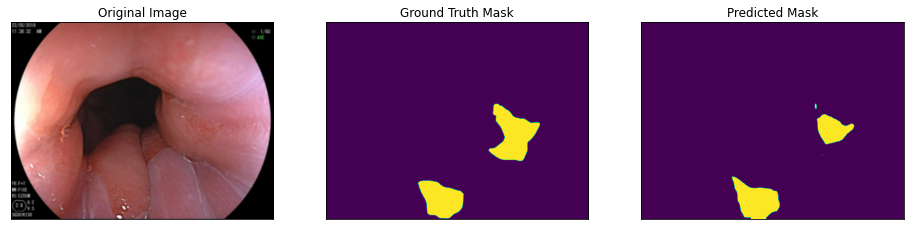

Dice =  0.7661
IOU =  0.6209


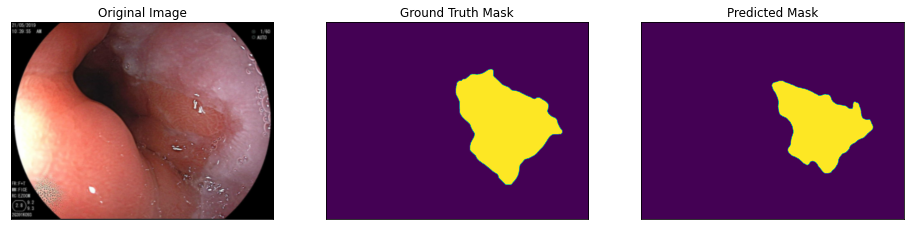

Dice =  0.8518
IOU =  0.7419


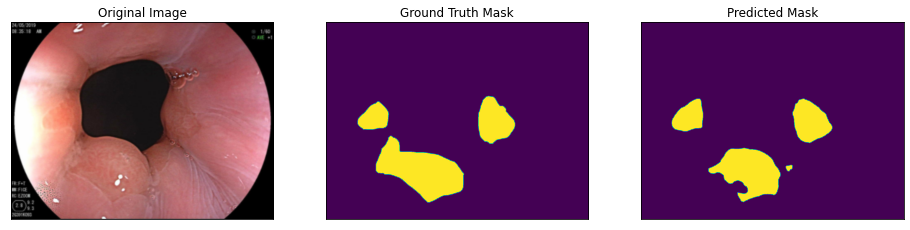

Dice =  0.8152
IOU =  0.688


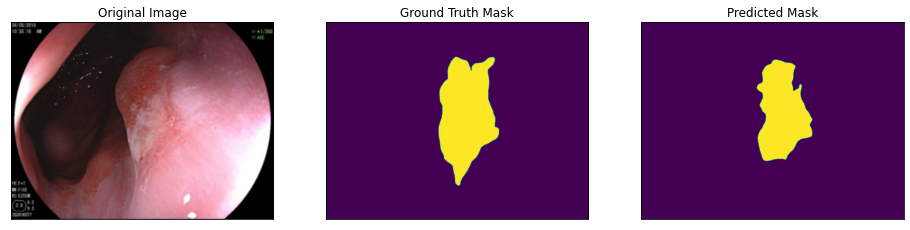

Dice =  0.8485
IOU =  0.7369


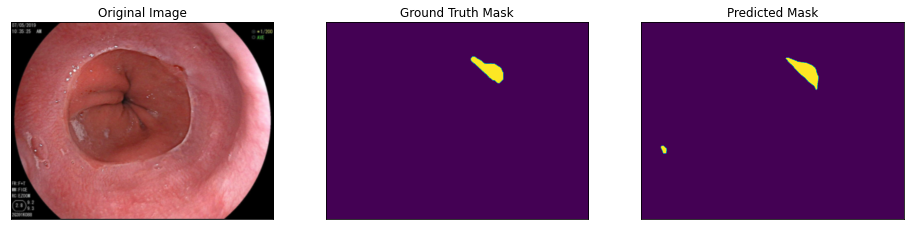

Dice =  0.8596
IOU =  0.7538


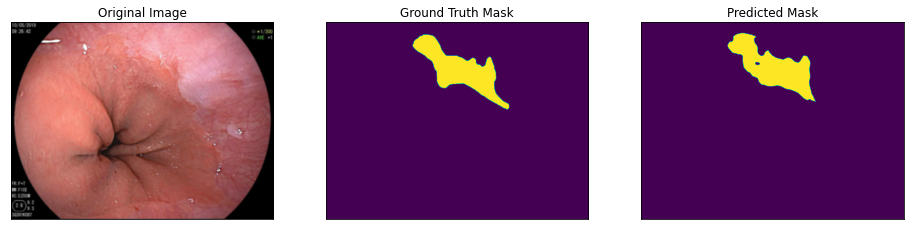

Dice =  0.8934
IOU =  0.8073


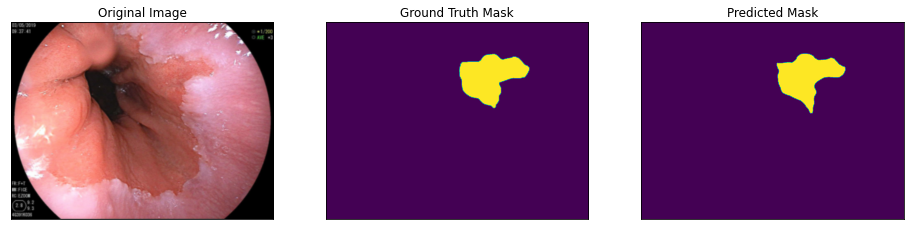

Dice =  0.9372
IOU =  0.8819


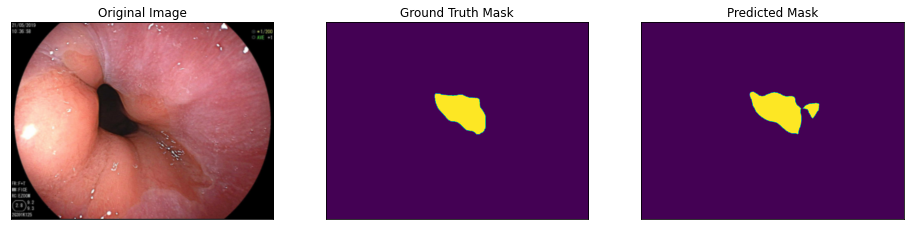

Dice =  0.886
IOU =  0.7953


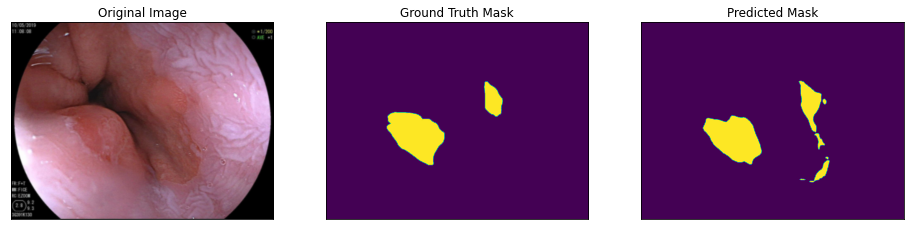

Dice =  0.8209
IOU =  0.6961


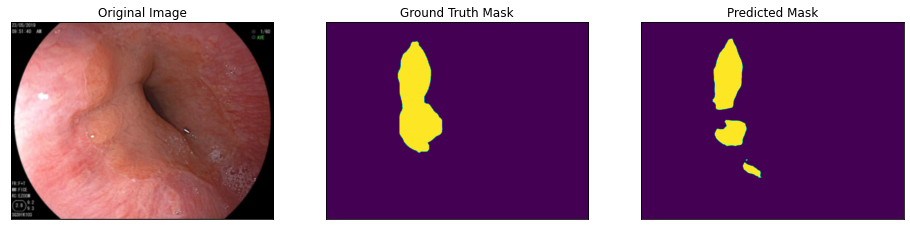

Dice =  0.7561
IOU =  0.6079


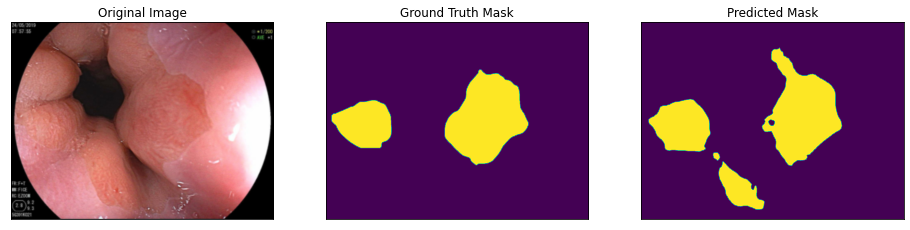

Dice =  0.8427
IOU =  0.7282


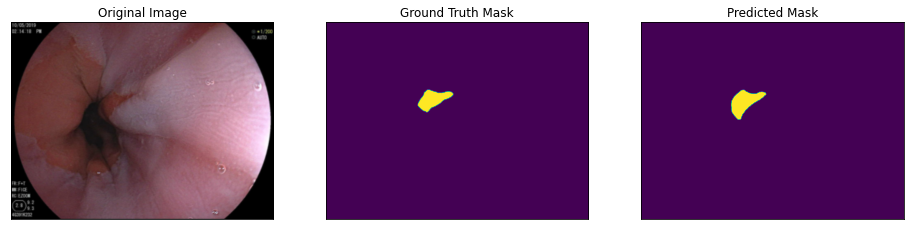

Dice =  0.8229
IOU =  0.6991


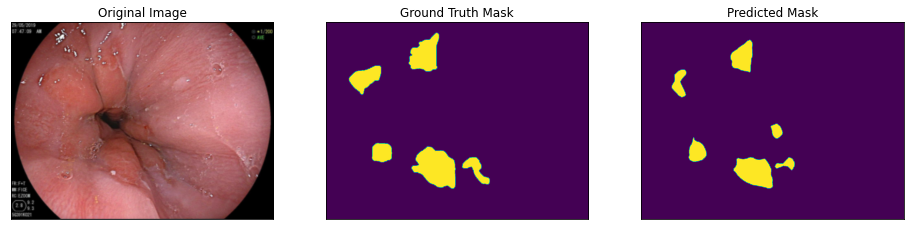

Dice =  0.7102
IOU =  0.5506


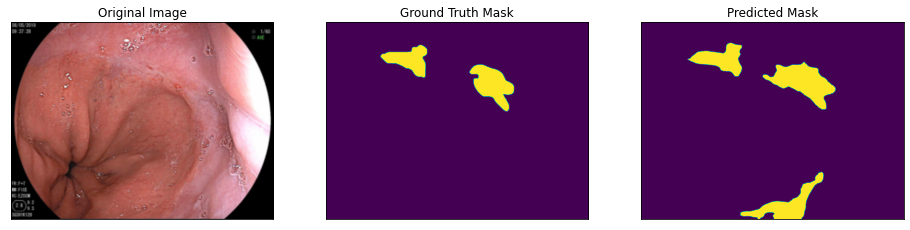

Dice =  0.6389
IOU =  0.4694


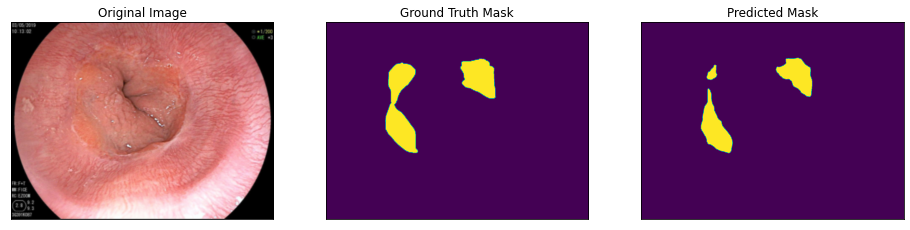

Dice =  0.7659
IOU =  0.6206


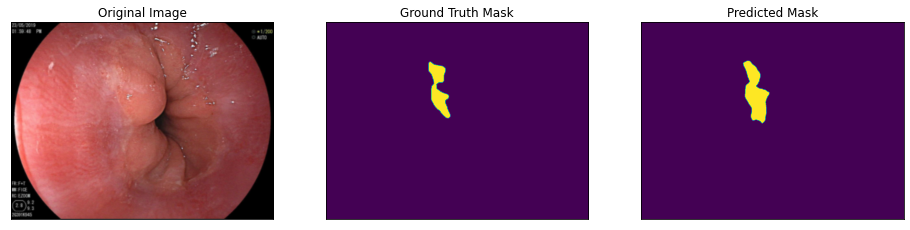

Dice =  0.7616
IOU =  0.615


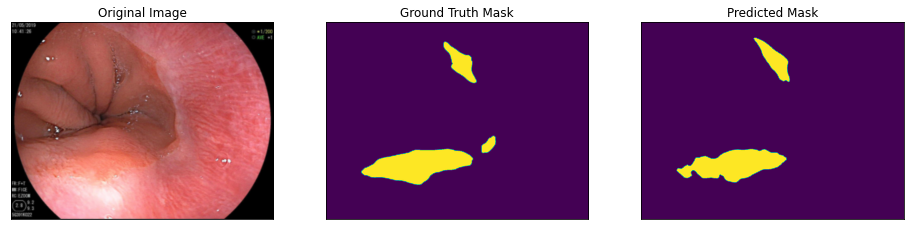

Dice =  0.8817
IOU =  0.7885


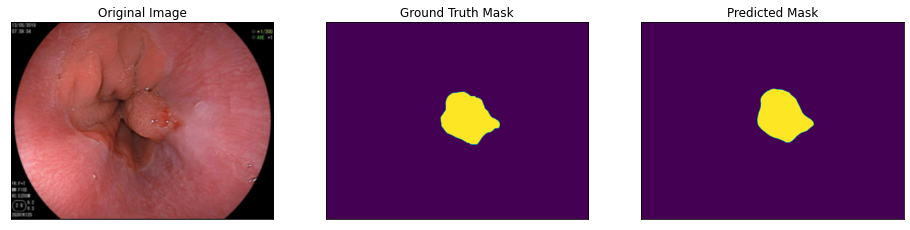

Dice =  0.9412
IOU =  0.8889


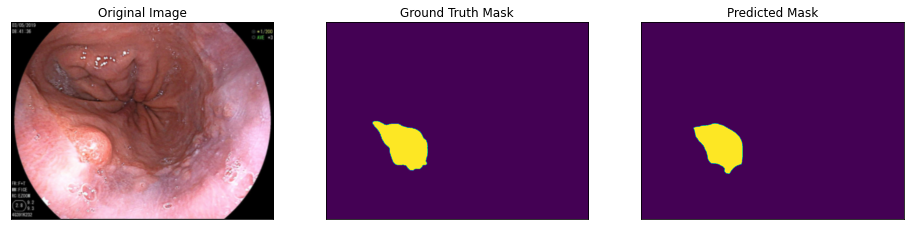

Dice =  0.9382
IOU =  0.8836


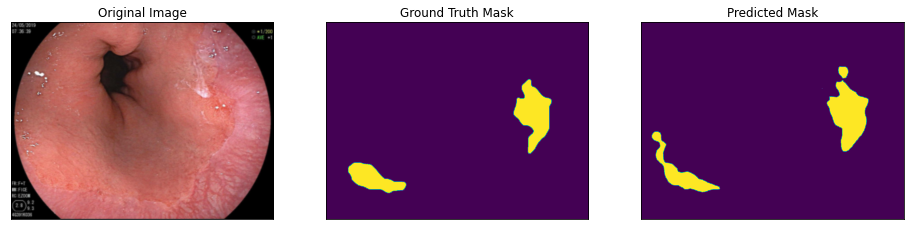

Dice =  0.8412
IOU =  0.726


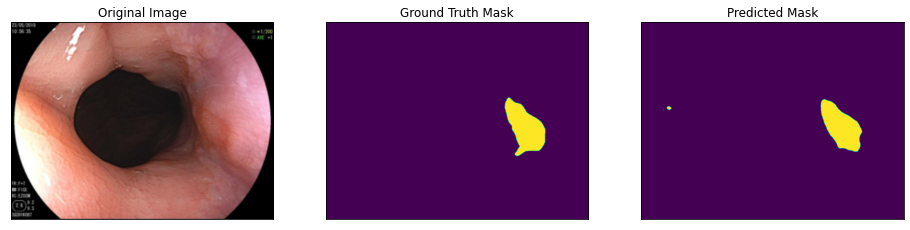

Dice =  0.9181
IOU =  0.8487


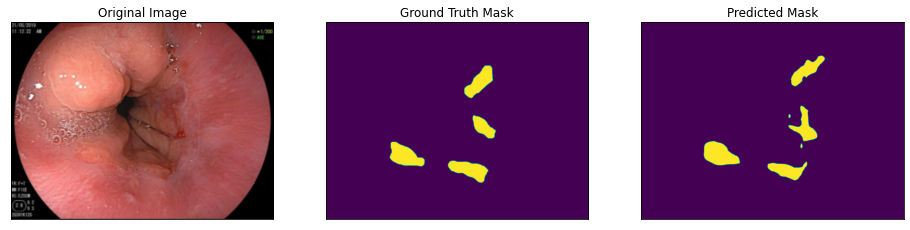

Dice =  0.6901
IOU =  0.5268


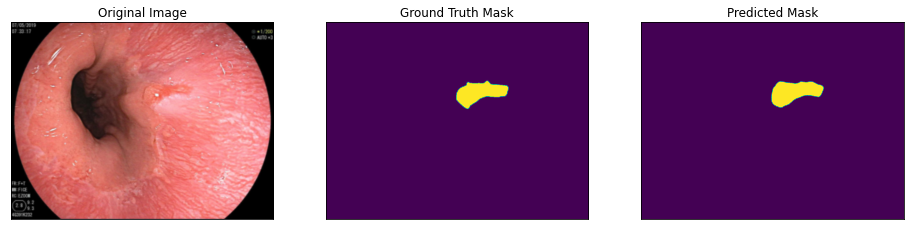

Dice =  0.9302
IOU =  0.8696


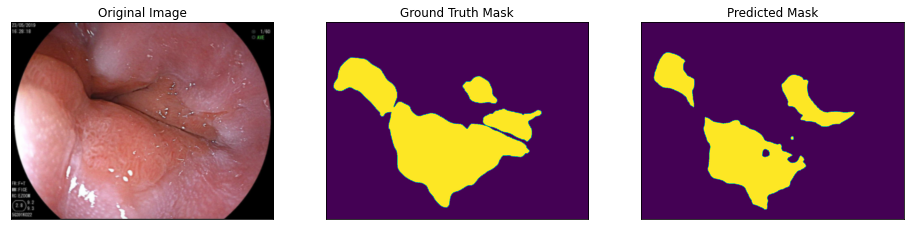

Dice =  0.7361
IOU =  0.5824


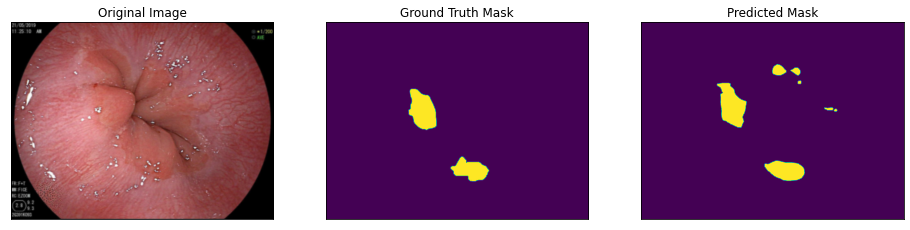

Dice =  0.7432
IOU =  0.5914


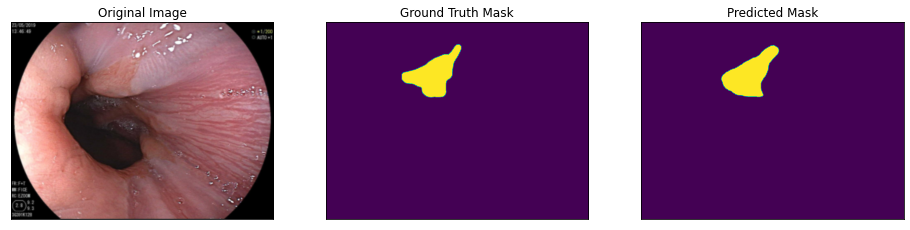

Dice =  0.9051
IOU =  0.8267


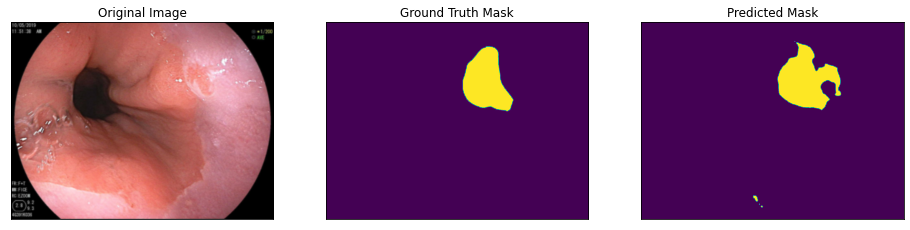

Dice =  0.8529
IOU =  0.7436


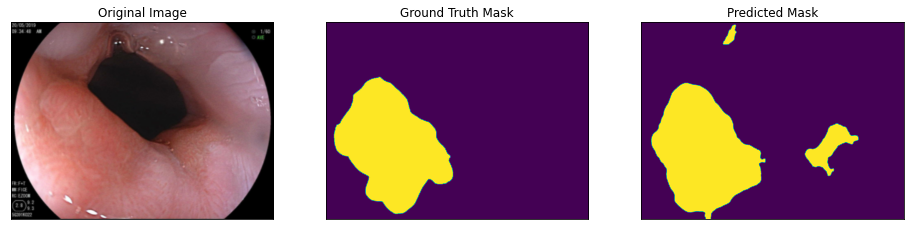

Dice =  0.8438
IOU =  0.7299


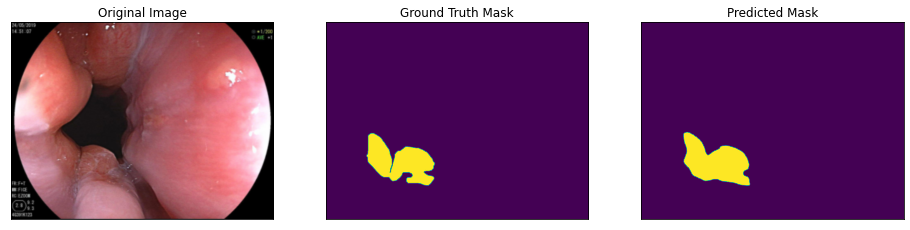

Dice =  0.9205
IOU =  0.8528


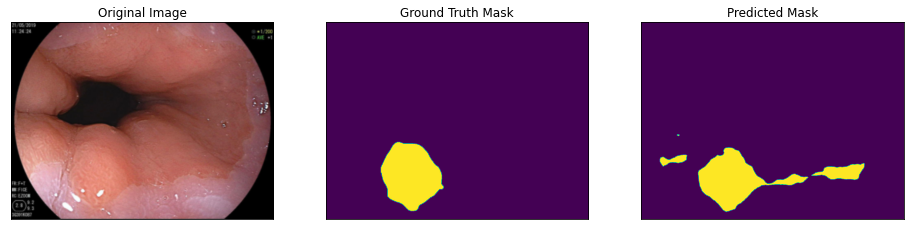

Dice =  0.7536
IOU =  0.6046


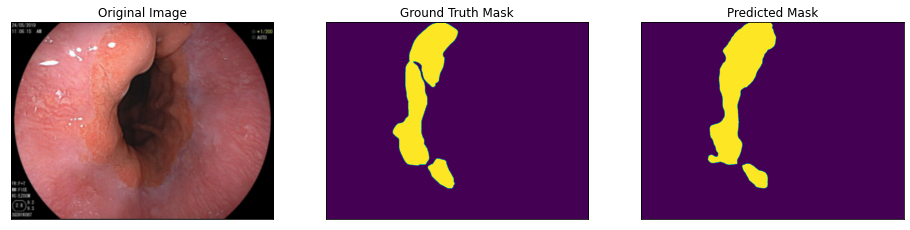

Dice =  0.8981
IOU =  0.8151


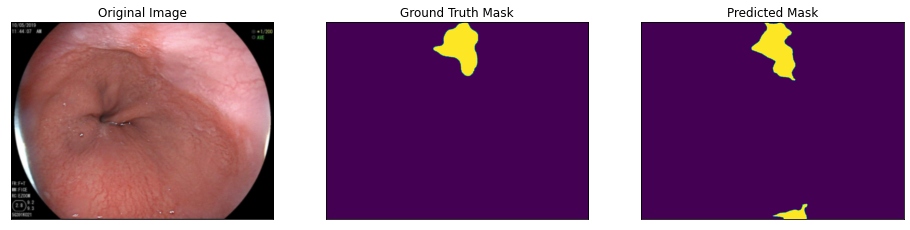

Dice =  0.8017
IOU =  0.669


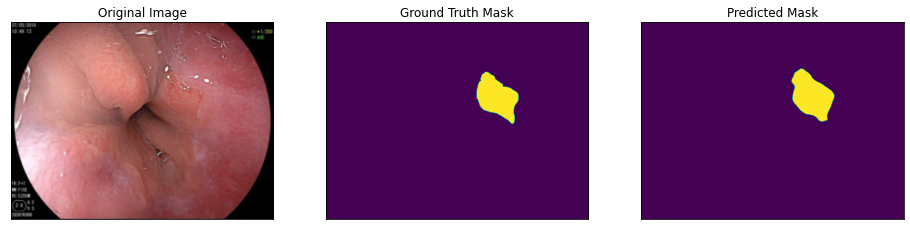

Dice =  0.9097
IOU =  0.8343


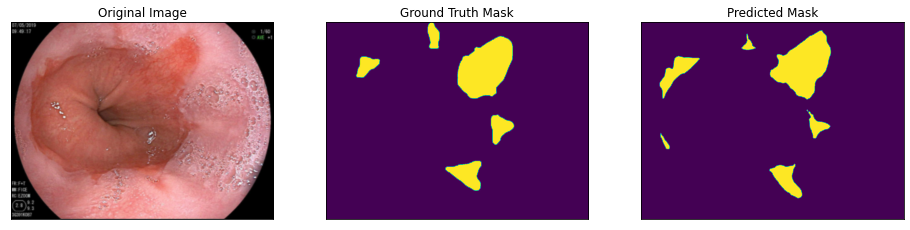

Dice =  0.7984
IOU =  0.6644


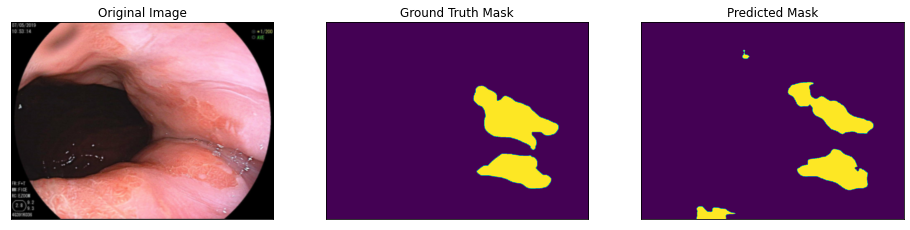

Dice =  0.749
IOU =  0.5987


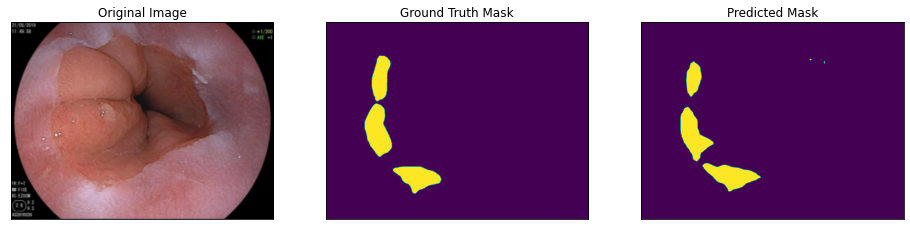

Dice =  0.8393
IOU =  0.7231


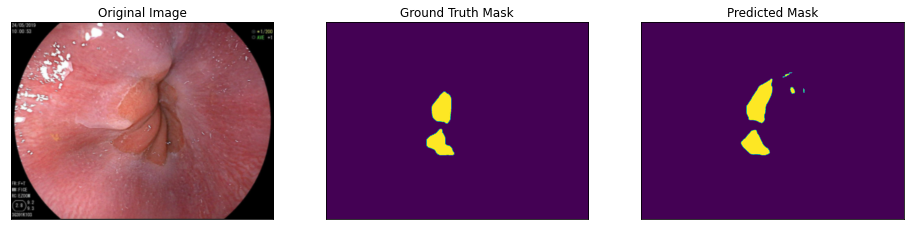

Dice =  0.8313
IOU =  0.7113


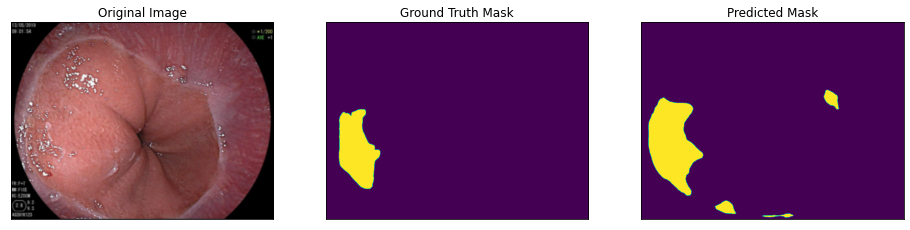

Dice =  0.7327
IOU =  0.5782


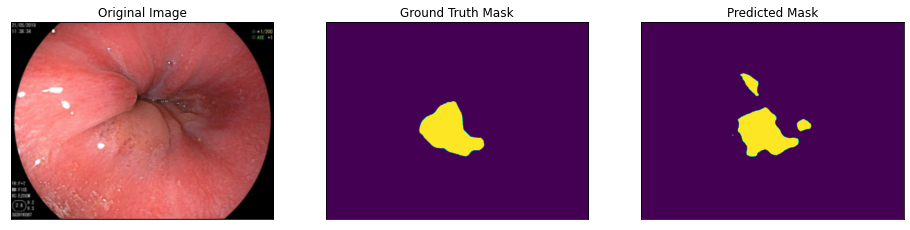

Dice =  0.8119
IOU =  0.6833


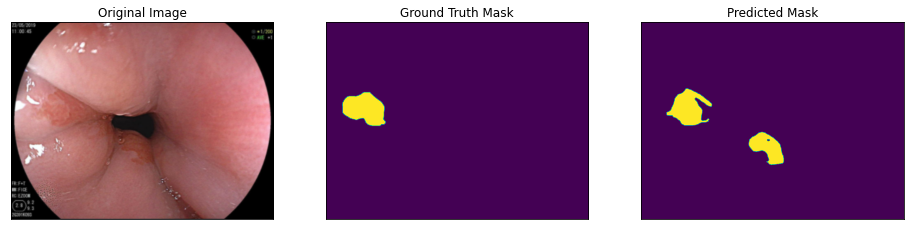

Dice =  0.5422
IOU =  0.372


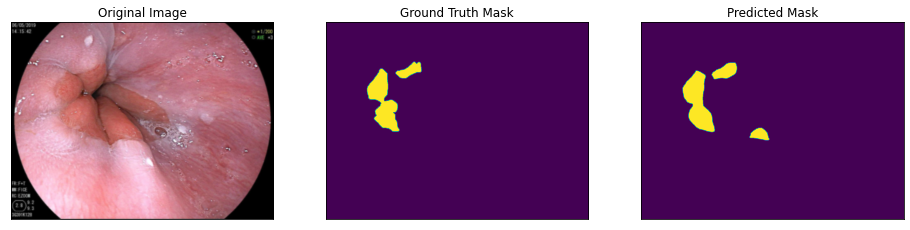

Dice =  0.8218
IOU =  0.6975


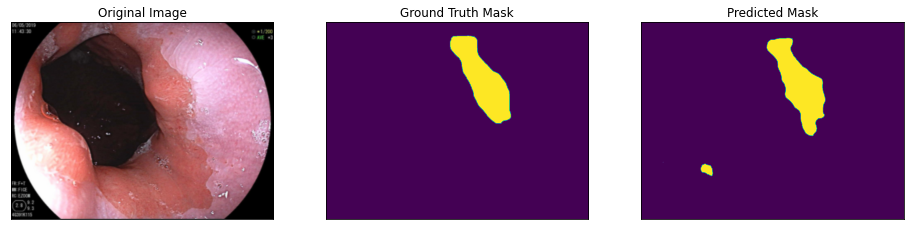

Dice =  0.8911
IOU =  0.8035


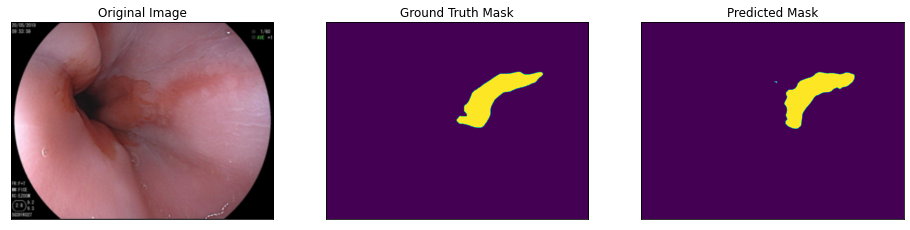

Dice =  0.8771
IOU =  0.7811


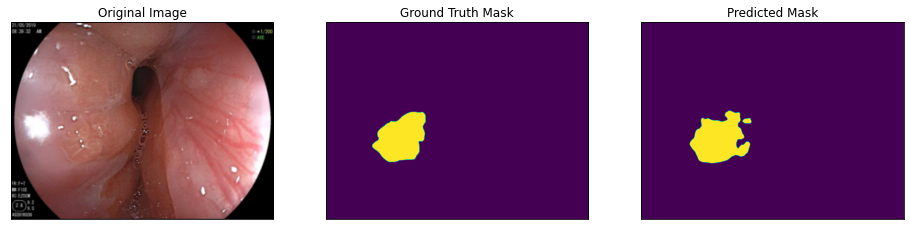

Dice =  0.8771
IOU =  0.781


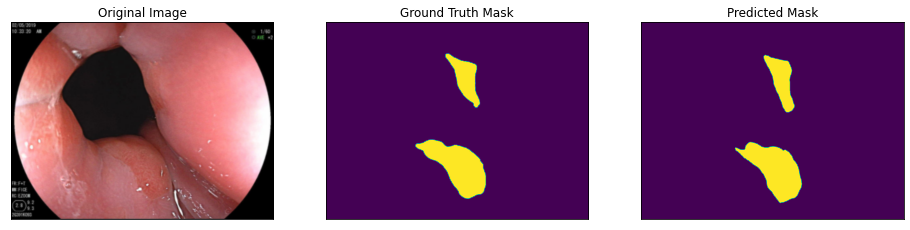

Dice =  0.9088
IOU =  0.8329


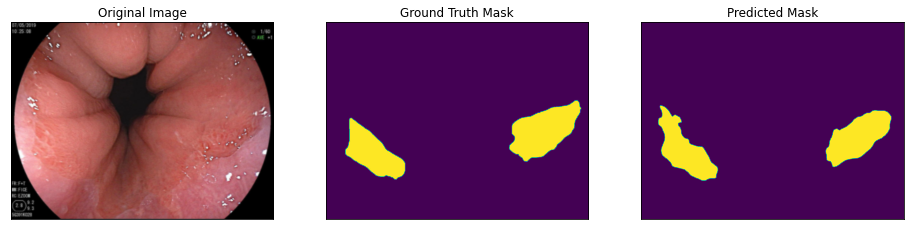

Dice =  0.8373
IOU =  0.7202


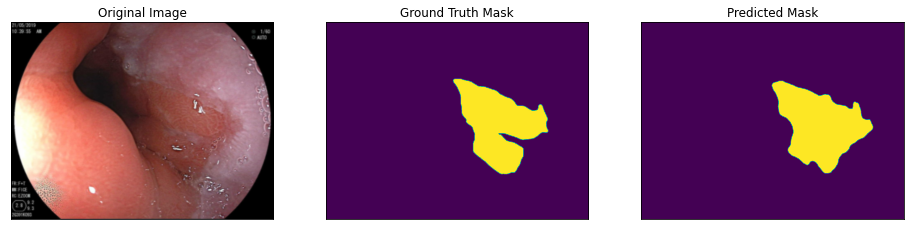

Dice =  0.8869
IOU =  0.7968


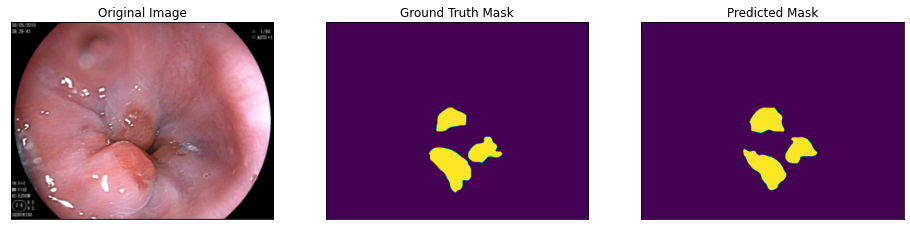

Dice =  0.8663
IOU =  0.7641


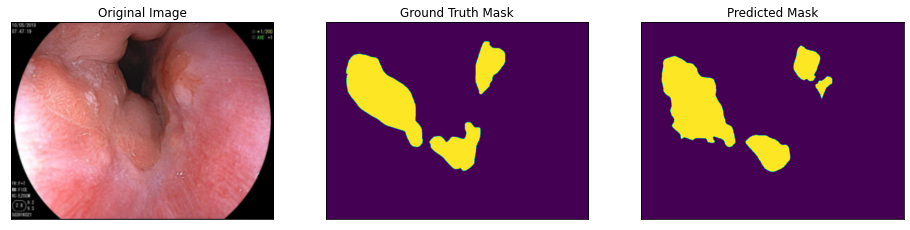

Dice =  0.7881
IOU =  0.6502


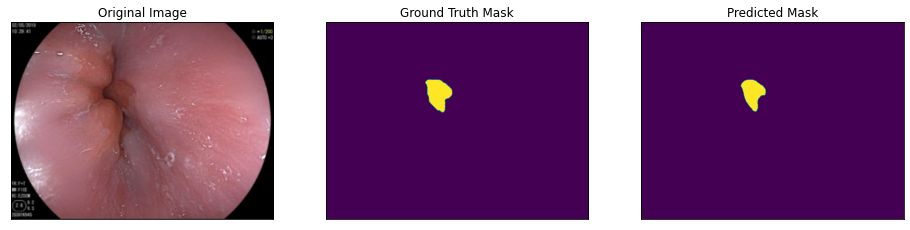

Dice =  0.8981
IOU =  0.815


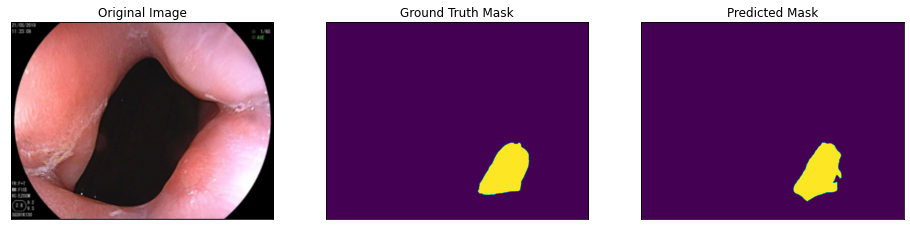

Dice =  0.9129
IOU =  0.8398


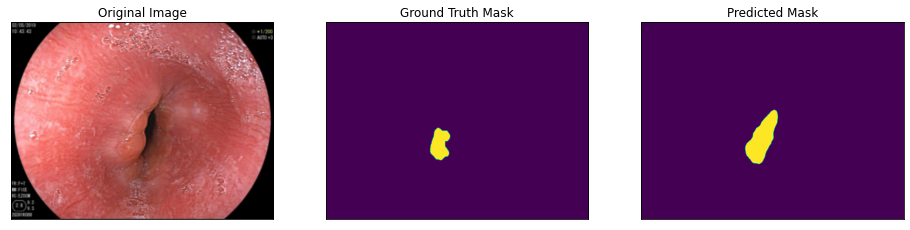

Dice =  0.5743
IOU =  0.4028


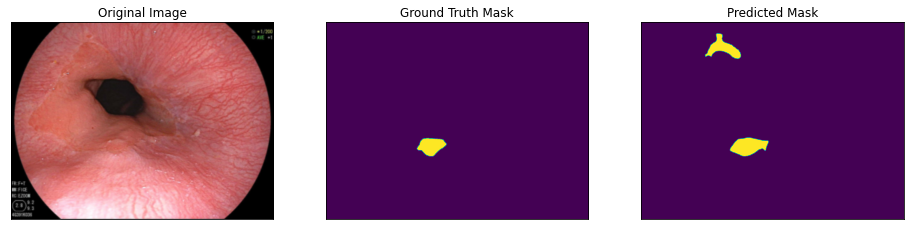

Dice =  0.5807
IOU =  0.4091


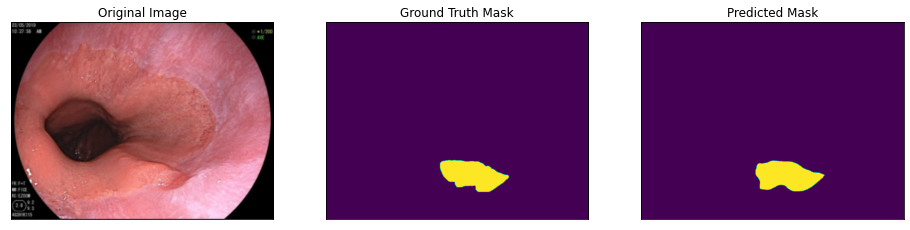

Dice =  0.919
IOU =  0.8502


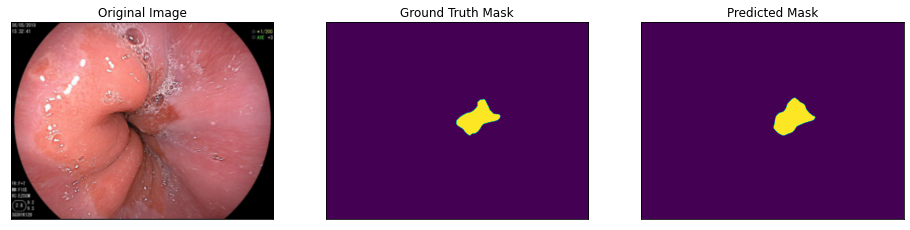

Dice =  0.8956
IOU =  0.8109


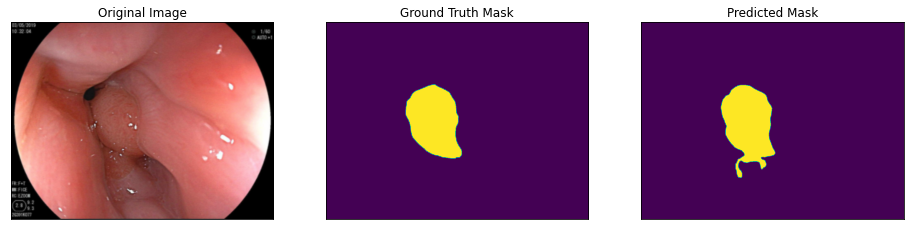

Dice =  0.9253
IOU =  0.8609


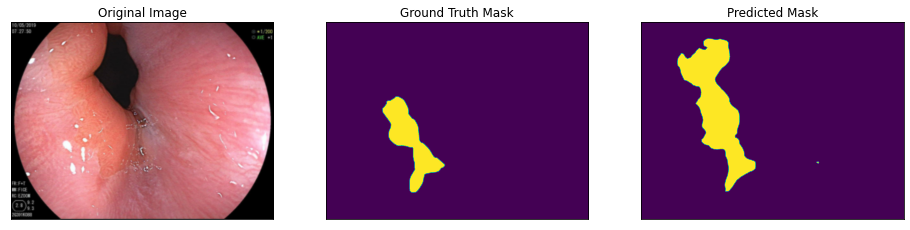

Dice =  0.5897
IOU =  0.4181


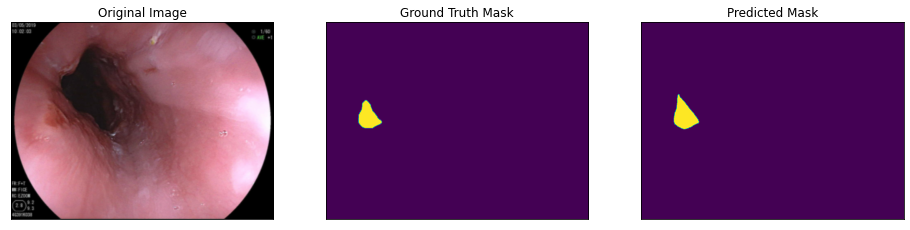

Dice =  0.8718
IOU =  0.7727


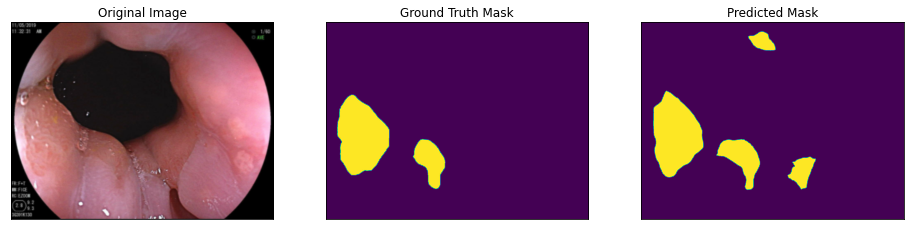

Dice =  0.834
IOU =  0.7153


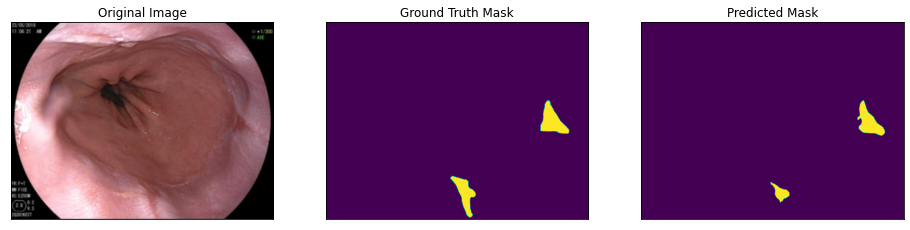

Dice =  0.7576
IOU =  0.6098


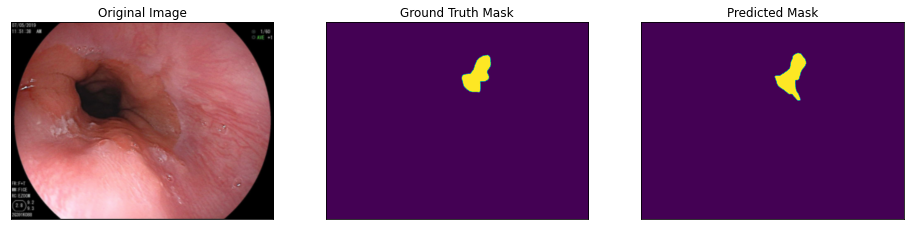

Dice =  0.8737
IOU =  0.7757


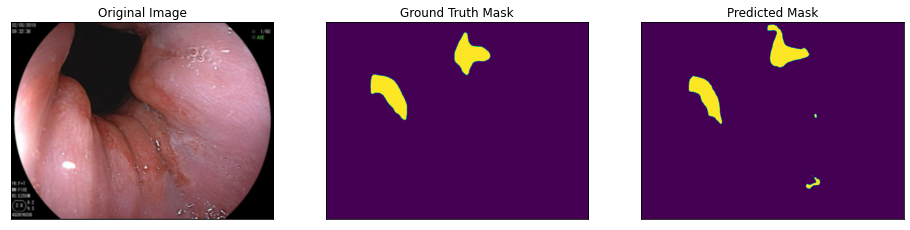

Dice =  0.8324
IOU =  0.713


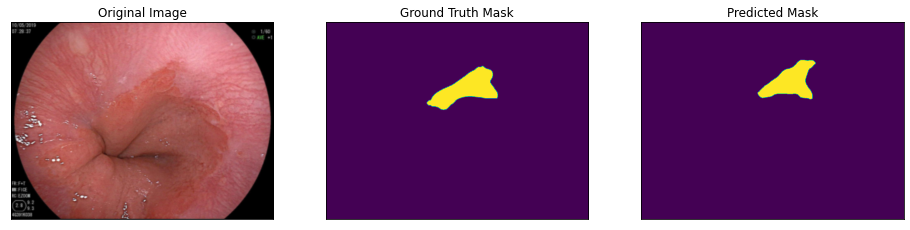

Dice =  0.7646
IOU =  0.6189


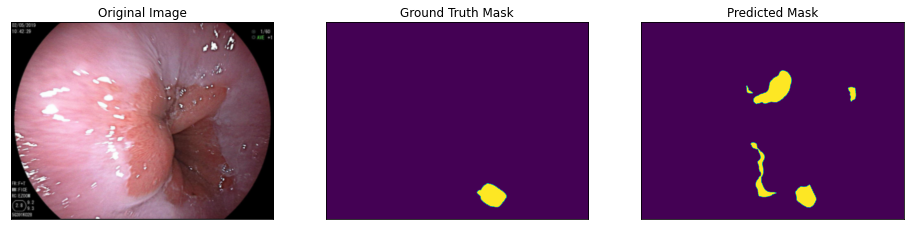

Dice =  0.3544
IOU =  0.2154


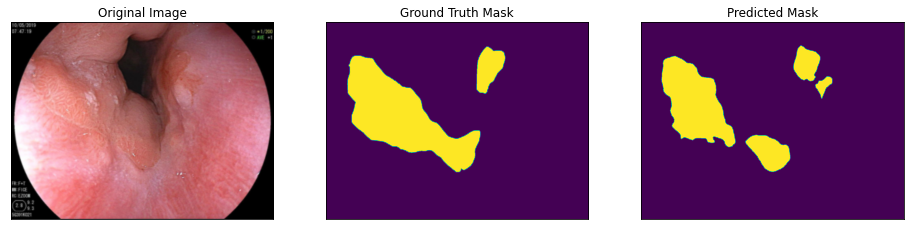

Dice =  0.8165
IOU =  0.6899


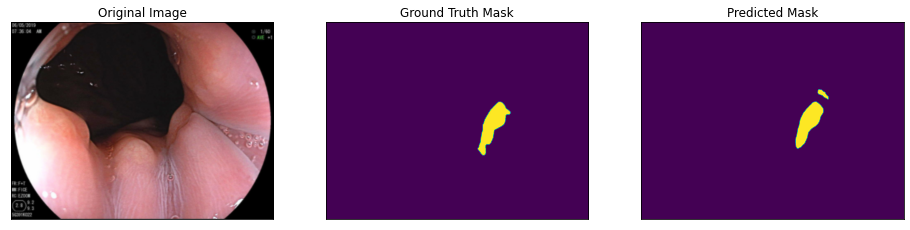

Dice =  0.887
IOU =  0.7969


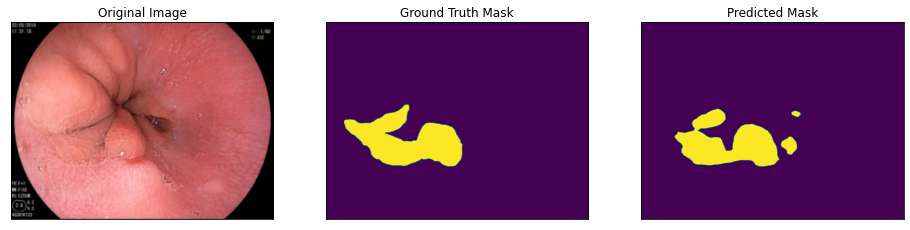

Dice =  0.8433
IOU =  0.7291


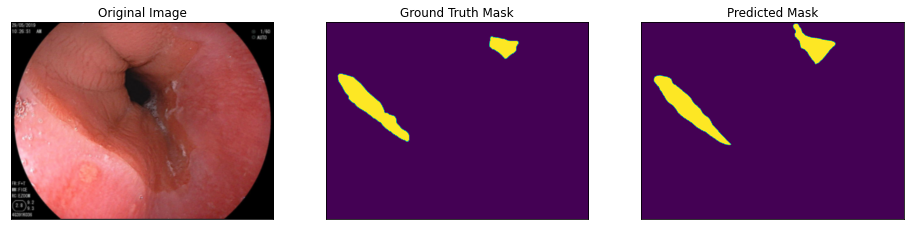

Dice =  0.854
IOU =  0.7452


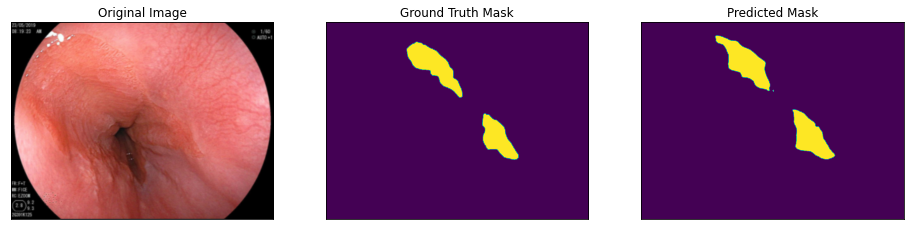

Dice =  0.8485
IOU =  0.7368


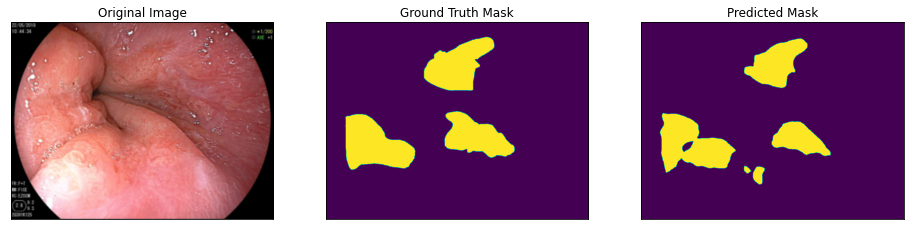

Dice =  0.8392
IOU =  0.723


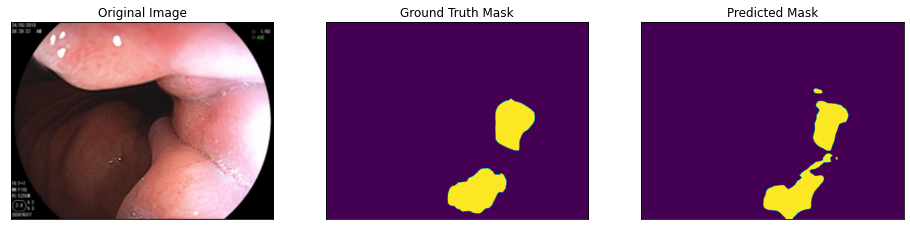

Dice =  0.8212
IOU =  0.6966


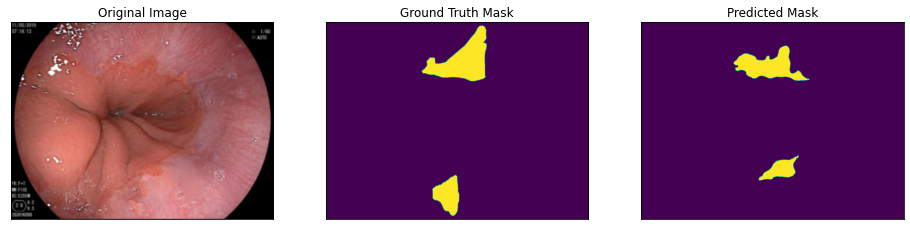

Dice =  0.4991
IOU =  0.3325


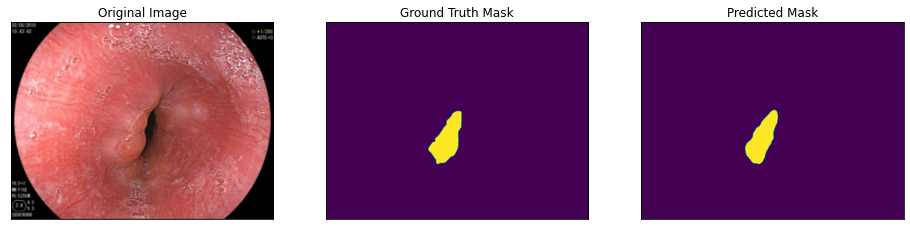

Dice =  0.9227
IOU =  0.8565


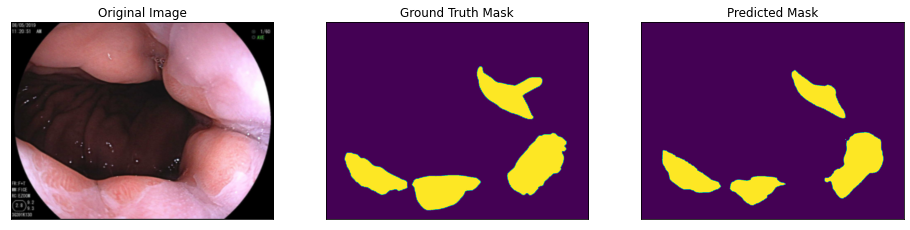

Dice =  0.8328
IOU =  0.7136


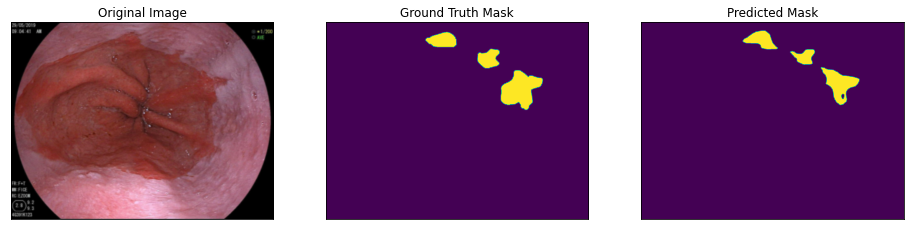

Dice =  0.7417
IOU =  0.5894


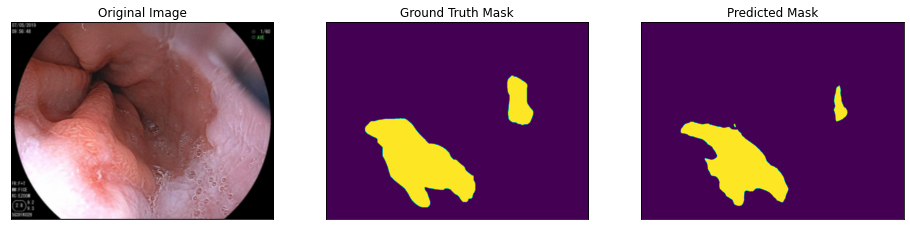

Dice =  0.8256
IOU =  0.7029


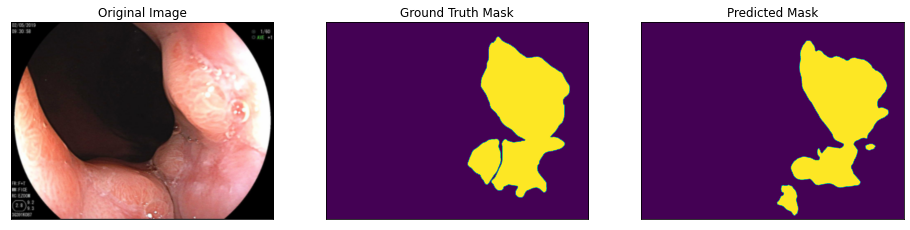

Dice =  0.8509
IOU =  0.7405


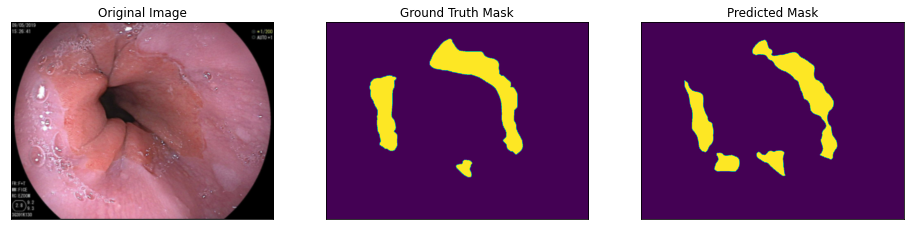

Dice =  0.7031
IOU =  0.5421


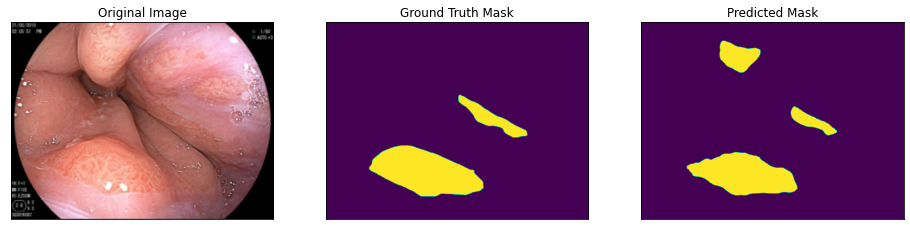

Dice =  0.7911
IOU =  0.6543


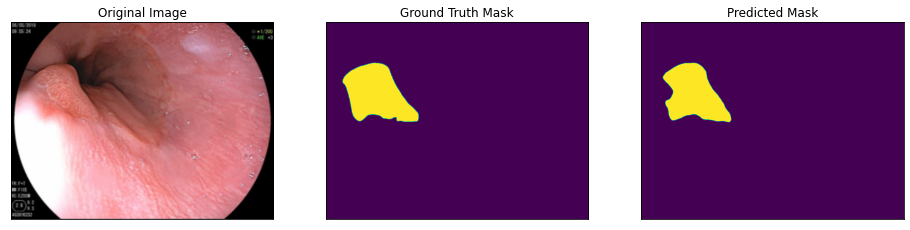

Dice =  0.9348
IOU =  0.8776


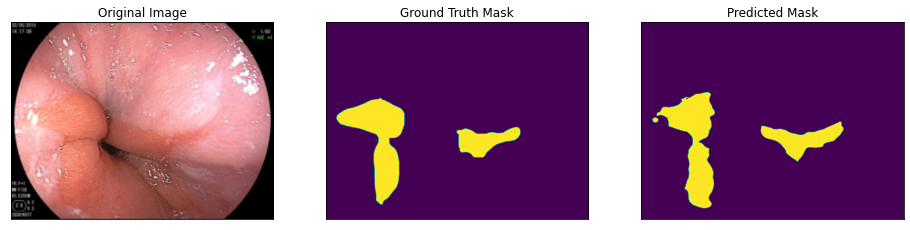

Dice =  0.829
IOU =  0.7079


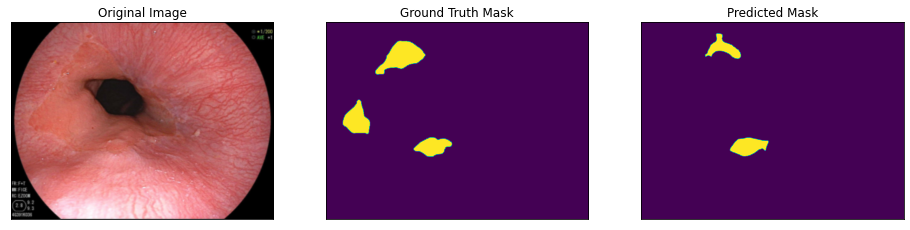

Dice =  0.5444
IOU =  0.374


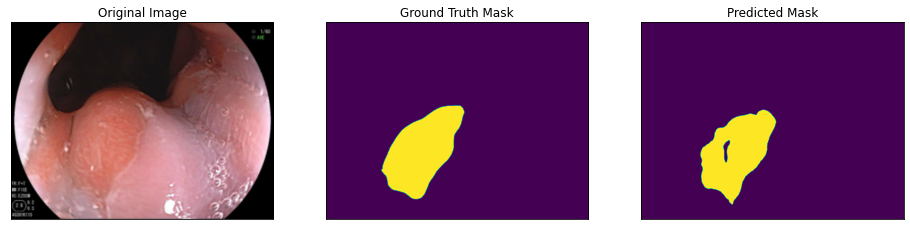

Dice =  0.9333
IOU =  0.8749


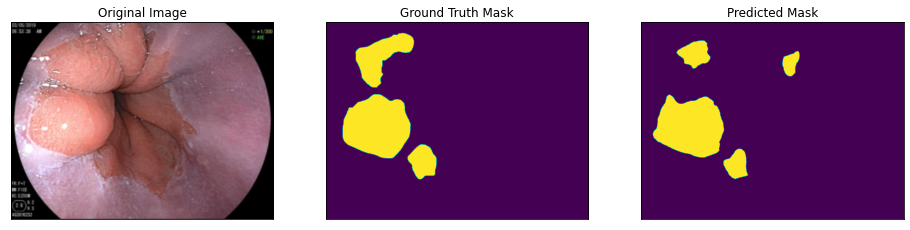

Dice =  0.7949
IOU =  0.6596


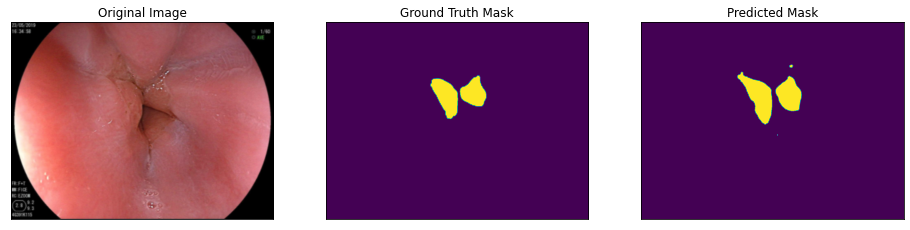

Dice =  0.8572
IOU =  0.75


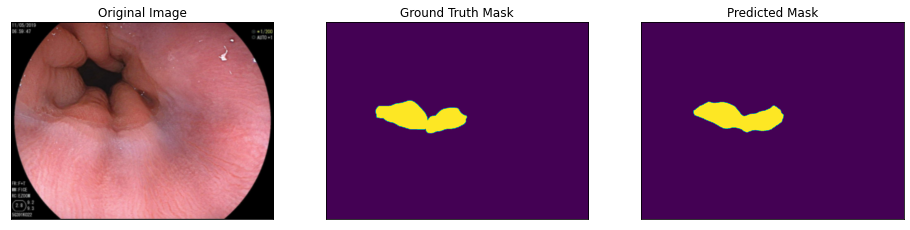

Dice =  0.9002
IOU =  0.8185


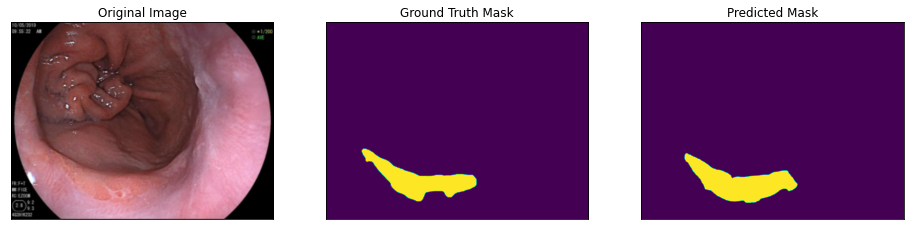

Dice =  0.8716
IOU =  0.7725


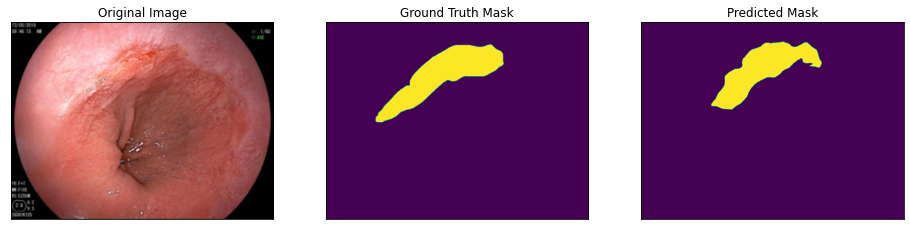

Dice =  0.8168
IOU =  0.6903


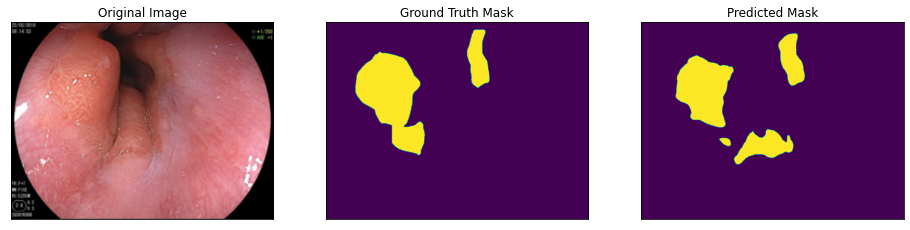

Dice =  0.7133
IOU =  0.5544


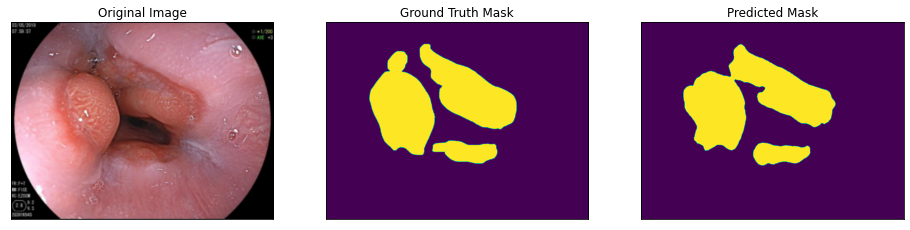

Dice =  0.8871
IOU =  0.797


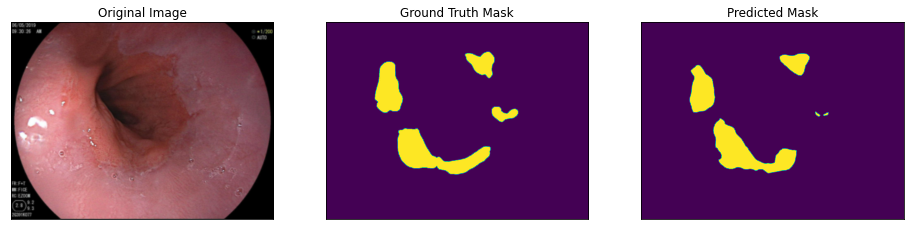

Dice =  0.8147
IOU =  0.6873


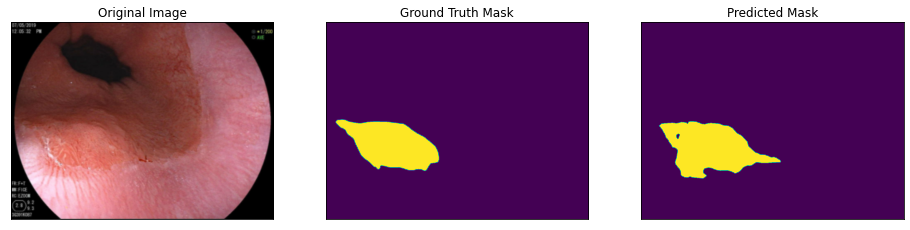

Dice =  0.8807
IOU =  0.7868


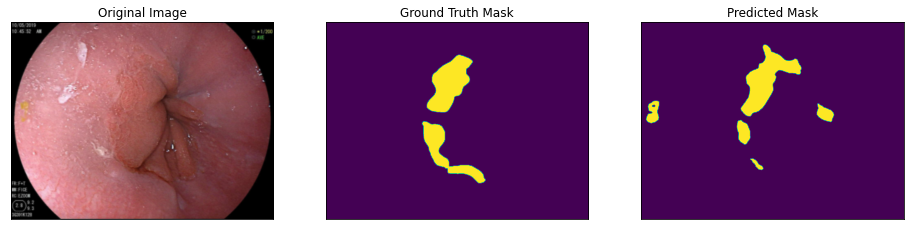

Dice =  0.6278
IOU =  0.4575


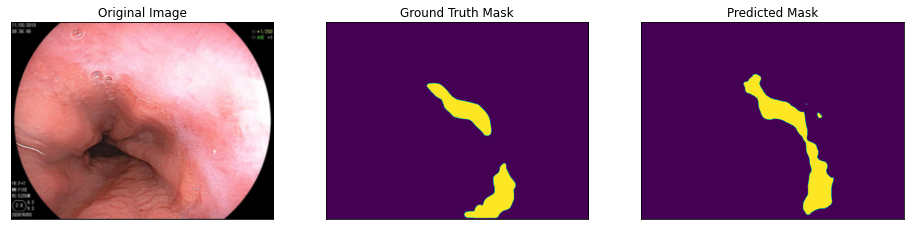

Dice =  0.7706
IOU =  0.6268


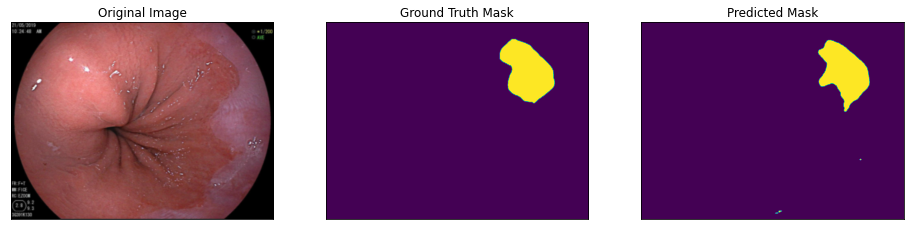

Dice =  0.8901
IOU =  0.8019


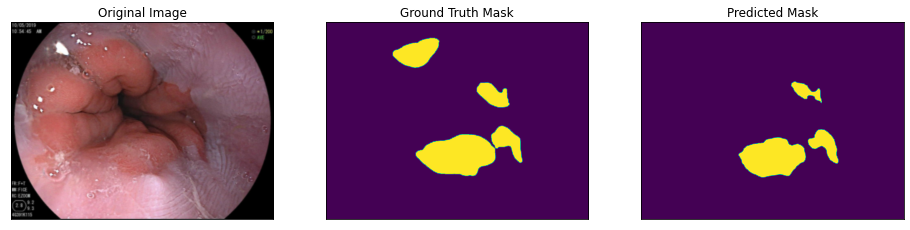

Dice =  0.7341
IOU =  0.5799


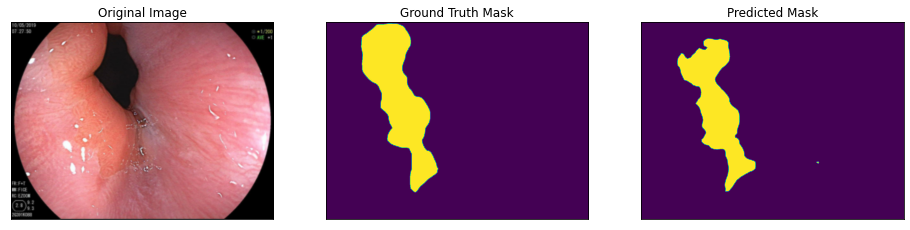

Dice =  0.8092
IOU =  0.6795


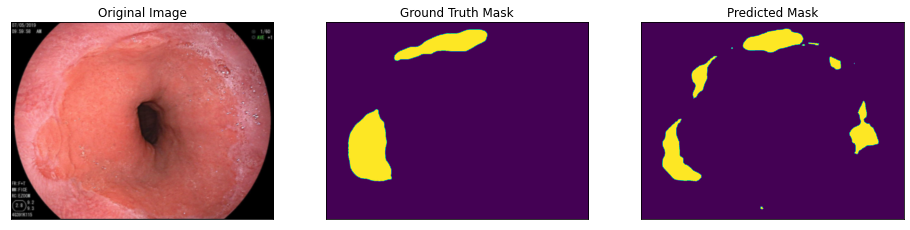

Dice =  0.5581
IOU =  0.3871


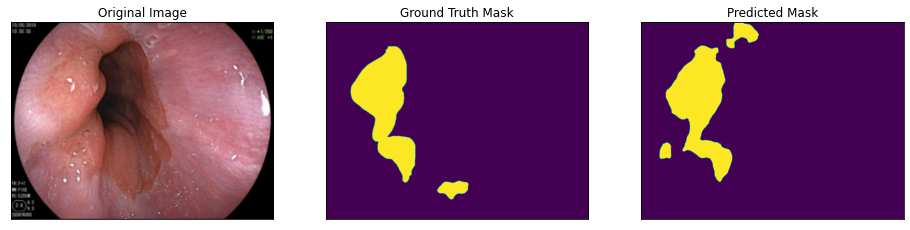

Dice =  0.8026
IOU =  0.6703


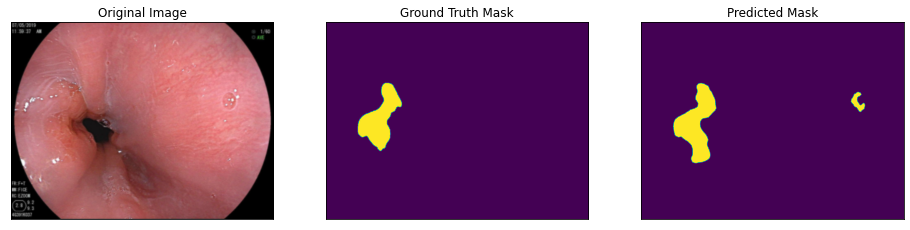

Dice =  0.8098
IOU =  0.6804


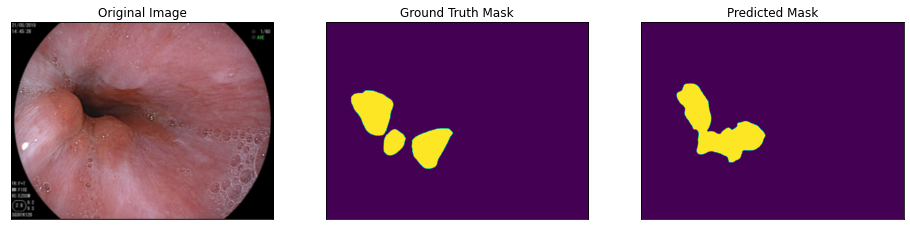

Dice =  0.6972
IOU =  0.5352


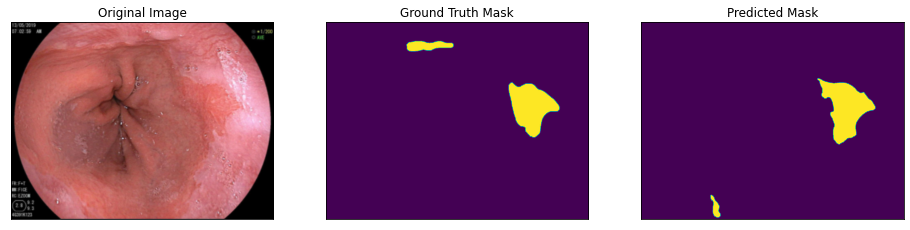

Dice =  0.7691
IOU =  0.6248


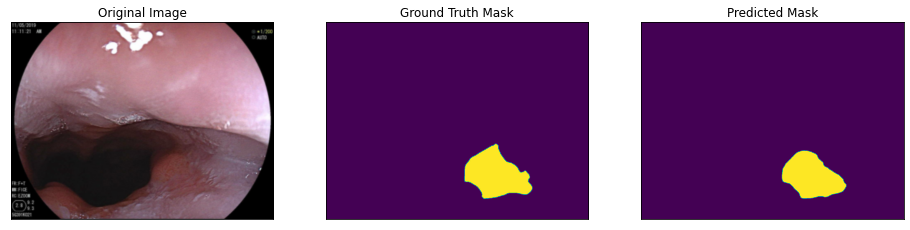

Dice =  0.9119
IOU =  0.8381


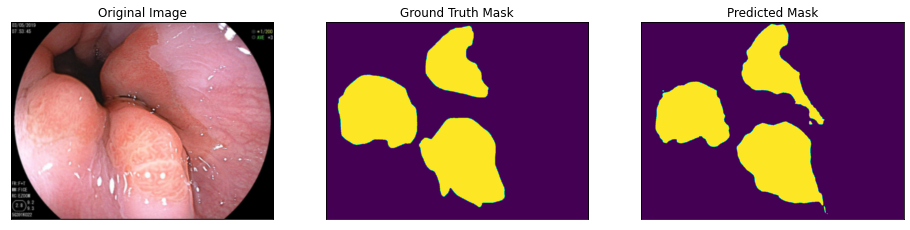

Dice =  0.9134
IOU =  0.8407


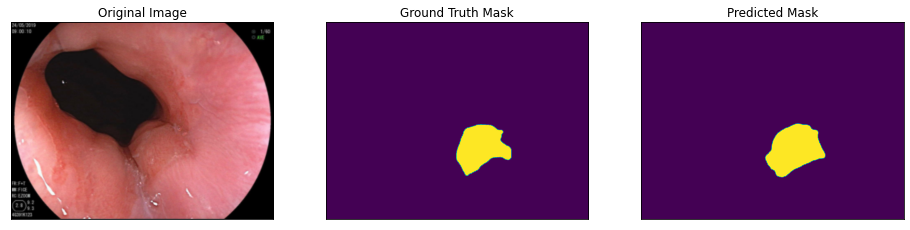

Dice =  0.9061
IOU =  0.8284
Mean dice =  0.8115538461538463
Mean IOU =  0.6966115384615382


In [ ]:
# Load checkpoint
print('| Resuming from checkpoint...')
# assert os.path.isdir('checkpoint'), 'Error: No checkpoint directory found!'
# _, file_name = getNetwork(args)
# model_2 = model

checkpoint = torch.load('/content/drive/MyDrive/Data_Segmentation/AAA-HarD-MSEG-best.pth')
model.load_state_dict(checkpoint['model'])
best_acc = checkpoint['acc']
start_epoch = checkpoint['epoch']

# checkpoint_2 = torch.load('/content/drive/MyDrive/Data_Segmentation/HarD-MSEG-best.pth')
# model_2.load_state_dict(checkpoint_2['model'])

class test_dataset_visualize:
    def __init__(self, image_root, gt_root, testsize):
        self.testsize = testsize
        self.images = [image_root + f for f in os.listdir(image_root) if f.endswith('.jpg') or f.endswith('.png')]
        self.gts = [gt_root + f for f in os.listdir(gt_root) if f.endswith('.jpg') or f.endswith('.png')]
        self.images = sorted(self.images)
        self.gts = sorted(self.gts)
        self.transform = transforms.Compose([
            transforms.Resize((self.testsize, self.testsize)),
            transforms.ToTensor(),
            transforms.Normalize([0.485, 0.456, 0.406],
                                 [0.229, 0.224, 0.225])])
        self.transforms_visual = transforms.Compose([
            transforms.Resize((self.testsize, self.testsize)),
            transforms.ToTensor()])
        self.gt_transform = transforms.ToTensor()
        self.size = len(self.images)
        self.index = 0

    def load_data(self):
        image = self.rgb_loader(self.images[self.index])
        image = self.transform(image).unsqueeze(0)

        image_visual = self.rgb_loader(self.images[self.index])
        image_visual = self.transforms_visual(image_visual).unsqueeze(0)

        gt = self.binary_loader(self.gts[self.index])
        name = self.images[self.index].split('/')[-1]
        # if name.endswith('.jpg'):
        #     name = name.split('.jpg')[0] + '.png'
        self.index += 1
        return image, image_visual, gt, name

    def rgb_loader(self, path):
        with open(path, 'rb') as f:
            img = Image.open(f)
            return img.convert('RGB')

    def binary_loader(self, path):
        with open(path, 'rb') as f:
            img = Image.open(f)
            return img.convert('L')

def visualize(**images):
    n = len(images)
    plt.figure(figsize=(16, 5))
    for i, (name, image) in enumerate(images.items()):
        plt.subplot(1, n, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.title(' '.join(name.split('_')).title())
        # if image.shape[0] == 3:
        #     image = image.transpose([1, 2, 0])
        plt.imshow(image)
    plt.show()

    
model.eval()
test_image_root = '/content/Train/'
test_mask_root = '/content/GT/train/'
test_loader = test_dataset_visualize(test_image_root, test_mask_root, testsize = 352)
b=0.0
IOU=0.0
for i in range(test_loader.size):
    image, image_visual, gt, name = test_loader.load_data()
    gt = np.asarray(gt, np.float32)
    gt /= (gt.max() + 1e-8)
    image = image.cuda()
    
    res  = model(image)
    res = F.upsample(res, size=gt.shape, mode='bilinear', align_corners=False)
    res = res.sigmoid().data.cpu().numpy().squeeze()
    res = (res - res.min()) / (res.max() - res.min() + 1e-8)
    res = res.round()
    
    input = res
    target = np.array(gt)
    N = gt.shape
    smooth = 1
    input_flat = np.reshape(input,(-1))
    target_flat = np.reshape(target,(-1))

    intersection = (input_flat*target_flat)
    
    loss =  (2 * intersection.sum() + smooth) / (input.sum() + target.sum() + smooth)
    iou = ((gt * res).sum() + 1) / (gt.sum() + res.sum() - (gt * res).sum() + 1)

    a =  '{:.4f}'.format(loss)
    a = float(a)
    b = b + a

    iou =  '{:.4f}'.format(iou)
    iou = float(iou)
    IOU += iou

    image_visual = F.upsample(image_visual, size=(960, 1280), mode='bilinear', align_corners=False)
    image_visual = image_visual.squeeze().permute(1, 2, 0).cpu().numpy()
    visualize(
        original_image=image_visual, 
        ground_truth_mask=gt, 
        predicted_mask=res
        # predicted_mask_erosion_with_dilation=pr_mask_er
    )
    print("Dice = ", a)
    print("IOU = ", iou)
    
print("Mean dice = ", b / test_loader.size)
print("Mean IOU = ", IOU / test_loader.size)